In [ ]:
import os
import shutil
from PIL import Image

base_dir = "/content/drive/MyDrive/cars_dataset"
image_dir = os.path.join(base_dir, "Images")
annotation_dir = os.path.join(base_dir, "Annotations")
label_dir = os.path.join(base_dir, "labels_yolo")
split_dir = os.path.join(base_dir, "ImageSets")

print("Klasör yolları:")
print(f"Images: {image_dir}")
print(f"Annotations: {annotation_dir}")
print(f"Labels (YOLO): {label_dir}")
print(f"ImageSets: {split_dir}")

print("\n train / val / test klasörleri oluşturuluyor...")
for split in ["train", "val", "test"]:
    os.makedirs(os.path.join(image_dir, split), exist_ok=True)
    os.makedirs(os.path.join(label_dir, split), exist_ok=True)
print("Klasörler hazır.")

def find_image_path(image_base_name):
    possible_exts = ['.jpg', '.JPG', '.jpeg', '.png', '.PNG']
    for ext in possible_exts:
        full_path = os.path.join(image_dir, image_base_name + ext)
        if os.path.exists(full_path):
            return full_path
    return None

for split in ["train", "val", "test"]:
    print(f"\n [{split.upper()}] başlatılıyor...")

    split_file = os.path.join(split_dir, f"{split}.txt")
    with open(split_file, "r") as f:
        image_ids = [line.strip() for line in f if line.strip()]

    print(f" {len(image_ids)} adet görüntü listelendi ({split_file})")

    for idx, image_id in enumerate(image_ids):
        print(f"\n [{split}] {idx+1}/{len(image_ids)} → {image_id}")

        img_src = find_image_path(image_id)
        img_dst = os.path.join(image_dir, split, f"{image_id}.jpg")
        ann_src = os.path.join(annotation_dir, f"{image_id}.txt")
        label_dst = os.path.join(label_dir, split, f"{image_id}.txt")

        if img_src:
            print(f" Görsel bulundu: {img_src}")
            shutil.copyfile(img_src, img_dst)
            print(f" Kopyalandı → {img_dst}")
        else:
            print(f" Görsel bulunamadı: {image_id}")
            continue

        if os.path.exists(ann_src):
            print(f" Etiket bulundu: {ann_src}")
            img = Image.open(img_src)
            img_width, img_height = img.size

            yolo_lines = []
            with open(ann_src, "r") as ann_file:
                for line in ann_file:
                    parts = line.strip().split()
                    if len(parts) != 5:
                        print(" Hatalı etiket satırı atlandı.")
                        continue
                    x1, y1, x2, y2, _ = map(int, parts)
                    x_center = (x1 + x2) / 2.0 / img_width
                    y_center = (y1 + y2) / 2.0 / img_height
                    width = (x2 - x1) / img_width
                    height = (y2 - y1) / img_height
                    yolo_lines.append(f"0 {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}")

            with open(label_dst, "w") as out_file:
                out_file.write("\n".join(yolo_lines))
            print(f" Etiket dönüştürüldü → {label_dst}")
        else:
            print(f"Etiket dosyası bulunamadı: {ann_src}")


In [ ]:
import os
import shutil
from PIL import Image

base_dir = "/content/drive/MyDrive/cars_dataset"


yaml_content = f"""
path: {base_dir}
train: images/train
val: images/val
test: images/test

names:
  0: car
"""

with open(os.path.join(base_dir, "dataset.yaml"), "w") as f:
    f.write(yaml_content.strip())

print(" dataset.yaml başarıyla oluşturuldu.")
!rm /content/drive/MyDrive/cars_dataset/Images/*.cache

import os

images_dir = "/content/drive/MyDrive/cars_dataset/images/val"
labels_dir = "/content/drive/MyDrive/cars_dataset/labels/val"

matched = 0
unmatched = []

for fname in os.listdir(images_dir):
    basename, _ = os.path.splitext(fname)
    label_path = os.path.join(labels_dir, basename + ".txt")
    if os.path.exists(label_path):
        matched += 1
    else:
        unmatched.append(basename)

print(f" {matched} görüntü eşleşti.")
if unmatched:
    print(f" {len(unmatched)} eşleşmeyen dosya var. İlk 5 tanesi:")
    print(unmatched[:5])
else:
    print(" Tüm görseller etiketlerle eşleşiyor.")



✅ dataset.yaml başarıyla oluşturuldu.
rm: cannot remove '/content/drive/MyDrive/cars_dataset/Images/*.cache': No such file or directory
✅ 200 görüntü eşleşti.
🎉 Tüm görseller etiketlerle eşleşiyor.


-- The ultralytics package is a powerful and user-friendly Python library developed by the creators of YOLO (You Only Look Once), designed for object detection, segmentation, and tracking tasks. It provides a high-level API through the YOLO() class, allowing users to easily train, validate, and run inference with state-of-the-art YOLOv5 and YOLOv8 models. The package also supports command-line usage and includes utilities for dataset preparation, augmentation, visualization, and exporting models to various formats. Installing it with --upgrade ensures that the latest version is used, which includes the most recent features, performance improvements, and bug fixes. This makes it an essential tool for modern deep learning workflows in computer vision.

In [1]:
!pip install ultralytics --upgrade


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 60.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 111.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 89.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 59.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 41.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 20.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 113.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalli

#**Model 1: YOLOv8n – Default Optimizer and Learning Rate**

Parameters:

Model: yolov8n.pt

Optimizer: default (AdamW via optimizer='auto')

Learning rate: default (0.01)

Epochs: 50

Batch size: 16

Image size: 640x640

Freeze: None (all layers are trainable)



This baseline model was trained using YOLOv8n with default settings provided by the Ultralytics library. After training for 50 epochs on the car counting dataset, the model achieved a Mean Squared Error (MSE) of 2.7350 and an Exact Match Accuracy (EMA) of 46.50% on the test set of 200 images. These results indicate that the default configuration is quite effective for the object counting task, achieving a balance between prediction accuracy and generalization without any manual tuning. It serves as a reliable reference point for comparing the impact of architectural modifications, freezing strategies, and hyperparameter changes in later experiments.

In [ ]:
from ultralytics import YOLO
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
!rm /content/drive/MyDrive/cars_dataset/images/*.cache

# YOLOv8n  modeli
model = YOLO('yolov8n.pt')


############ default optimizer and leaarning rate
model.train(
    data="/content/drive/MyDrive/cars_dataset/dataset.yaml",
    epochs=50,
    imgsz=640,
    batch=16,
    name="yolo_car_counting_v8n",
    device=0
)



Mounted at /content/drive
rm: cannot remove '/content/drive/MyDrive/cars_dataset/images/*.cache': No such file or directory


100%|██████████| 6.25M/6.25M [00:00<00:00, 360MB/s]

Ultralytics 8.3.139 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)


engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/cars_dataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolo_car_counting_v8n, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, profile=False, project=None, rect=False, re

100%|██████████| 755k/755k [00:00<00:00, 95.7MB/s]

Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

Model summary: 129 layers, 3,011,043 parameters, 3,011,027 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 361MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.3±0.1 ms, read: 1.5±0.6 MB/s, size: 1365.5 KB)


train: Scanning /content/drive/MyDrive/cars_dataset/labels/train.cache... 1000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.3±0.2 ms, read: 1.7±0.4 MB/s, size: 1312.4 KB)


val: Scanning /content/drive/MyDrive/cars_dataset/labels/val.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolo_car_counting_v8n/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolo_car_counting_v8n
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      6.41G      1.366       1.73     0.9822        808        640: 100%|██████████| 63/63 [00:46<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:14<00:00,  2.02s/it]

                   all        200      11906      0.956      0.921      0.959      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      7.38G      1.083     0.6973     0.8959        740        640: 100%|██████████| 63/63 [00:13<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.59it/s]

                   all        200      11906      0.967      0.956       0.98      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      6.67G       1.05     0.6167     0.8856       1137        640: 100%|██████████| 63/63 [00:13<00:00,  4.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.32it/s]

                   all        200      11906      0.989      0.966       0.99      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      7.57G     0.9916     0.5803     0.8779       1051        640: 100%|██████████| 63/63 [00:12<00:00,  4.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.52it/s]

                   all        200      11906      0.992      0.968      0.991      0.777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      4.52G     0.9793     0.5645     0.8747        932        640: 100%|██████████| 63/63 [00:13<00:00,  4.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.15it/s]

                   all        200      11906      0.989      0.974      0.992      0.768



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      4.52G      0.962     0.5449     0.8707        643        640: 100%|██████████| 63/63 [00:13<00:00,  4.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.54it/s]

                   all        200      11906      0.988      0.968      0.991      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      4.54G     0.9305     0.5293      0.863        660        640: 100%|██████████| 63/63 [00:13<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.52it/s]

                   all        200      11906      0.991      0.978      0.993      0.789



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      4.54G     0.9094      0.509      0.859       1059        640: 100%|██████████| 63/63 [00:13<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.47it/s]

                   all        200      11906      0.992       0.98      0.993      0.788



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      4.54G     0.8841     0.4986     0.8561        657        640: 100%|██████████| 63/63 [00:12<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.76it/s]

                   all        200      11906       0.99       0.98      0.993      0.763



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      4.54G     0.8994     0.4946     0.8573       1005        640: 100%|██████████| 63/63 [00:13<00:00,  4.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.72it/s]

                   all        200      11906      0.991      0.981      0.994        0.8



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      4.56G     0.8894     0.4795     0.8537        868        640: 100%|██████████| 63/63 [00:13<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.40it/s]

                   all        200      11906      0.992       0.98      0.994      0.797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      4.56G       0.87     0.4744     0.8517        600        640: 100%|██████████| 63/63 [00:13<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.63it/s]

                   all        200      11906      0.992      0.981      0.994      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      4.56G     0.8554     0.4648       0.85        815        640: 100%|██████████| 63/63 [00:12<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.57it/s]

                   all        200      11906      0.993      0.982      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      5.53G     0.8512     0.4554     0.8489        710        640: 100%|██████████| 63/63 [00:13<00:00,  4.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.63it/s]

                   all        200      11906      0.991       0.98      0.994      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      5.55G     0.8495     0.4519     0.8461       1045        640: 100%|██████████| 63/63 [00:13<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.83it/s]

                   all        200      11906      0.993      0.978      0.994       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      5.55G      0.841      0.446     0.8447       1069        640: 100%|██████████| 63/63 [00:13<00:00,  4.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.53it/s]

                   all        200      11906      0.994      0.981      0.994      0.814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      5.55G     0.8338     0.4396     0.8425       1222        640: 100%|██████████| 63/63 [00:13<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.69it/s]

                   all        200      11906      0.991      0.982      0.994       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      5.55G     0.8279     0.4336     0.8424        595        640: 100%|██████████| 63/63 [00:13<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.71it/s]

                   all        200      11906      0.993      0.981      0.994       0.82



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      5.55G     0.8193     0.4259     0.8411        582        640: 100%|██████████| 63/63 [00:13<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.73it/s]

                   all        200      11906      0.993      0.983      0.994      0.816



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      5.55G     0.8165     0.4248     0.8399       1067        640: 100%|██████████| 63/63 [00:13<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.75it/s]

                   all        200      11906      0.993      0.984      0.994      0.823



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      5.55G     0.8133     0.4247     0.8407       1002        640: 100%|██████████| 63/63 [00:13<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.82it/s]

                   all        200      11906      0.992      0.982      0.994      0.812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      5.55G     0.8065     0.4213     0.8391        569        640: 100%|██████████| 63/63 [00:13<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.81it/s]

                   all        200      11906      0.991      0.985      0.994      0.815



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      5.55G     0.8012     0.4191     0.8401        798        640: 100%|██████████| 63/63 [00:13<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.34it/s]

                   all        200      11906      0.993      0.982      0.994      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      5.55G     0.8119     0.4222     0.8388        758        640: 100%|██████████| 63/63 [00:13<00:00,  4.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.84it/s]

                   all        200      11906      0.992      0.985      0.994      0.823



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      5.55G     0.8048     0.4149     0.8386        586        640: 100%|██████████| 63/63 [00:13<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.75it/s]

                   all        200      11906      0.994      0.983      0.994      0.827



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      5.55G     0.7918     0.4051      0.836        870        640: 100%|██████████| 63/63 [00:13<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.65it/s]

                   all        200      11906      0.994      0.984      0.994      0.823



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      5.57G      0.797     0.4062     0.8376        942        640: 100%|██████████| 63/63 [00:13<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]

                   all        200      11906      0.993      0.984      0.994      0.831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      5.57G     0.7769     0.3982     0.8325        626        640: 100%|██████████| 63/63 [00:13<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.73it/s]

                   all        200      11906      0.994      0.984      0.994      0.828



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      5.57G     0.7752      0.394      0.835        893        640: 100%|██████████| 63/63 [00:13<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.74it/s]

                   all        200      11906      0.993      0.985      0.994      0.827



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      5.57G     0.7765      0.398     0.8325       1173        640: 100%|██████████| 63/63 [00:13<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.73it/s]

                   all        200      11906      0.993      0.985      0.994       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      5.57G     0.7655     0.3913     0.8335        777        640: 100%|██████████| 63/63 [00:12<00:00,  4.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.84it/s]

                   all        200      11906      0.992      0.985      0.994      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      5.57G     0.7696      0.392     0.8326        695        640: 100%|██████████| 63/63 [00:13<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.64it/s]

                   all        200      11906      0.994      0.985      0.994      0.832



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      5.57G     0.7662     0.3907     0.8328        617        640: 100%|██████████| 63/63 [00:12<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.90it/s]

                   all        200      11906      0.993      0.985      0.994       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      5.57G     0.7672     0.3889     0.8316        795        640: 100%|██████████| 63/63 [00:13<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.96it/s]

                   all        200      11906      0.995      0.983      0.994      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      6.58G     0.7651     0.3855     0.8322        759        640: 100%|██████████| 63/63 [00:13<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.81it/s]

                   all        200      11906      0.993      0.985      0.994      0.835



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      6.58G     0.7499       0.38     0.8287        804        640: 100%|██████████| 63/63 [00:13<00:00,  4.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.93it/s]

                   all        200      11906      0.993      0.986      0.994      0.833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      6.58G     0.7616     0.3833     0.8293        930        640: 100%|██████████| 63/63 [00:13<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.64it/s]

                   all        200      11906      0.994      0.985      0.994      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      6.58G     0.7502     0.3782     0.8289        995        640: 100%|██████████| 63/63 [00:13<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.71it/s]

                   all        200      11906      0.992      0.988      0.994      0.838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      6.58G      0.746     0.3739     0.8287        993        640: 100%|██████████| 63/63 [00:12<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]

                   all        200      11906      0.992      0.986      0.994      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      6.58G     0.7438     0.3735      0.828        438        640: 100%|██████████| 63/63 [00:13<00:00,  4.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        200      11906      0.994      0.986      0.994      0.838


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      6.58G      0.723     0.3711     0.8284        669        640: 100%|██████████| 63/63 [00:14<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.67it/s]

                   all        200      11906      0.993      0.985      0.994      0.826



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      6.58G     0.7185     0.3625     0.8274        629        640: 100%|██████████| 63/63 [00:11<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.64it/s]

                   all        200      11906      0.993      0.986      0.994      0.831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.58G     0.7172     0.3579      0.826        546        640: 100%|██████████| 63/63 [00:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.83it/s]

                   all        200      11906      0.992      0.987      0.994      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      6.58G     0.7034     0.3527      0.824        408        640: 100%|██████████| 63/63 [00:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.02it/s]

                   all        200      11906      0.995      0.985      0.994      0.835



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      6.58G     0.7093     0.3529     0.8265        526        640: 100%|██████████| 63/63 [00:11<00:00,  5.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.93it/s]

                   all        200      11906      0.993      0.986      0.994      0.839



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.58G     0.6994     0.3488     0.8234        441        640: 100%|██████████| 63/63 [00:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.73it/s]

                   all        200      11906      0.993      0.987      0.994      0.837



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.58G     0.6875     0.3412     0.8221        419        640: 100%|██████████| 63/63 [00:11<00:00,  5.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.01it/s]

                   all        200      11906      0.993      0.987      0.994      0.841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      6.58G     0.6855     0.3393     0.8224        754        640: 100%|██████████| 63/63 [00:11<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.88it/s]

                   all        200      11906      0.994      0.986      0.994      0.844



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      6.58G      0.682     0.3368     0.8212        582        640: 100%|██████████| 63/63 [00:11<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.01it/s]

                   all        200      11906      0.993      0.987      0.994      0.843



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.58G     0.6793      0.335     0.8218        635        640: 100%|██████████| 63/63 [00:11<00:00,  5.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.87it/s]

                   all        200      11906      0.993      0.987      0.994      0.843



50 epochs completed in 0.217 hours.
Optimizer stripped from runs/detect/yolo_car_counting_v8n/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/yolo_car_counting_v8n/weights/best.pt, 6.2MB

Validating runs/detect/yolo_car_counting_v8n/weights/best.pt...
Ultralytics 8.3.139 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.27it/s]


                   all        200      11906      0.994      0.986      0.994      0.843
Speed: 0.1ms preprocess, 1.4ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/yolo_car_counting_v8n


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7cc0db0b2210>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

In [ ]:
from ultralytics import YOLO
model5 = YOLO("yolov8n.pt")
model5.info()

YOLOv8n summary: 129 layers, 3,157,200 parameters, 0 gradients, 8.9 GFLOPs


(129, 3157200, 0, 8.8575488)

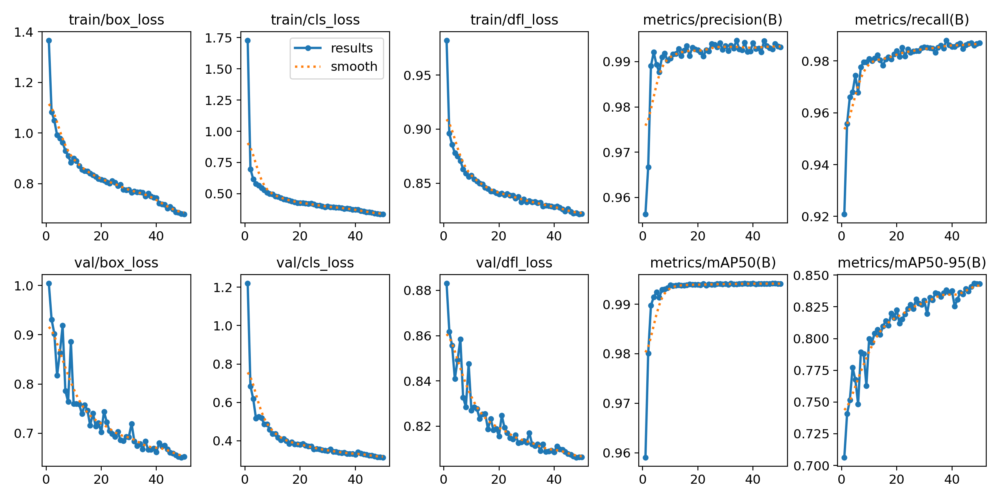

In [ ]:
from IPython.display import Image, display
display(Image(filename="/content/runs/detect/yolo_car_counting_v8n/results.png"))


In [ ]:
from ultralytics import YOLO
import os
import numpy as np


model = YOLO("/content/runs/detect/yolo_car_counting_v8n/weights/best.pt")


img_dir = "/content/drive/MyDrive/cars_dataset/images/test"
label_dir = "/content/drive/MyDrive/cars_dataset/labels/test"

image_names = sorted(os.listdir(img_dir))
exact_matches = 0
sq_errors = []
total = 0

for name in image_names:
    base, _ = os.path.splitext(name)
    img_path = os.path.join(img_dir, name)
    label_path = os.path.join(label_dir, base + ".txt")

    if not os.path.exists(label_path):
        continue

    with open(label_path, "r") as f:
        gt_count = len(f.readlines())

    result = model(img_path, conf=0.25, iou=0.5, verbose=False)
    pred_count = len(result[0].boxes)

    if pred_count == gt_count:
        exact_matches += 1

    sq_errors.append((pred_count - gt_count) ** 2)
    total += 1

mse = np.mean(sq_errors)
ema = (exact_matches / total) * 100

print(f" Mean Squared Error (MSE): {mse:.4f}")
print(f" Exact Match Accuracy (EMA): {ema:.2f}%")
print(f" Değerlendirilen görüntü sayısı: {total}")


 Mean Squared Error (MSE): 2.7350
 Exact Match Accuracy (EMA): 46.50%
 Değerlendirilen görüntü sayısı: 200


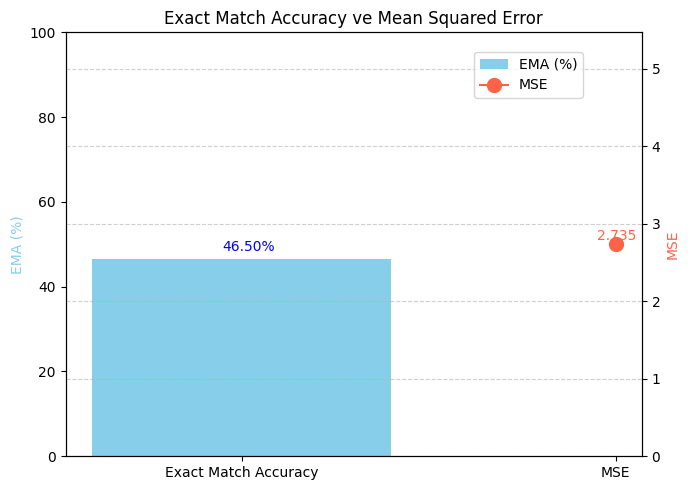

In [ ]:
import matplotlib.pyplot as plt

ema =46.50  # Exact Match Accuracy
mse = 2.7350  # Mean Squared Error

fig, ax1 = plt.subplots(figsize=(7, 5))


ax1.bar(['Exact Match Accuracy'], [ema], color='skyblue', label='EMA (%)')
ax1.set_ylim(0, 100)
ax1.set_ylabel('EMA (%)', color='skyblue')
ax1.set_title('Exact Match Accuracy ve Mean Squared Error')


ax2 = ax1.twinx()
ax2.plot(['MSE'], [mse], marker='o', markersize=10, color='tomato', label='MSE')
ax2.set_ylabel('MSE', color='tomato')
ax2.set_ylim(0, max(mse * 2, 1))

ax1.text(-0.05, ema + 2, f"{ema:.2f}%", color='blue', fontsize=10)
ax2.text(0.95, mse + 0.05, f"{mse:.3f}", color='tomato', fontsize=10)

fig.legend(loc="upper right", bbox_to_anchor=(0.85, 0.9))
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()


In [ ]:
import os

test_dir = "/content/drive/MyDrive/cars_dataset/images/test"
sample_images = sorted(os.listdir(test_dir))[:3]

print("Seçilen örnek görseller:")
for img in sample_images:
    print(img)


Seçilen örnek görseller:
20160331_NTU_00008.jpg
20160331_NTU_00017.jpg
20160331_NTU_00019.jpg


In [ ]:
from ultralytics import YOLO

model = YOLO("/content/runs/detect/yolo_car_counting_v8n/weights/best.pt")

for img_name in sample_images:
    img_path = os.path.join(test_dir, img_name)
    model.predict(img_path, save=True, conf=0.25, iou=0.5, verbose=False)


Results saved to runs/detect/predict3
Results saved to runs/detect/predict3
Results saved to runs/detect/predict3


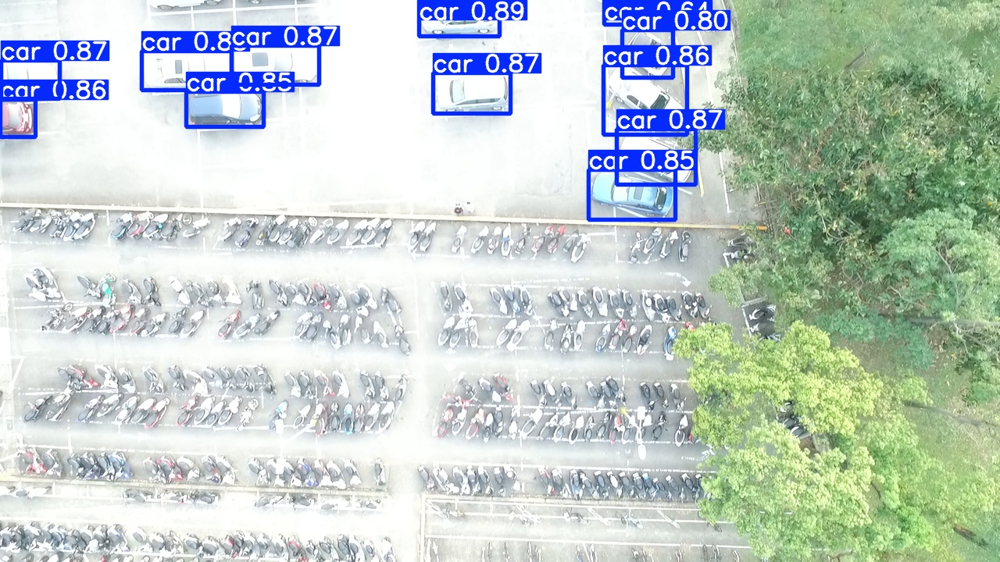

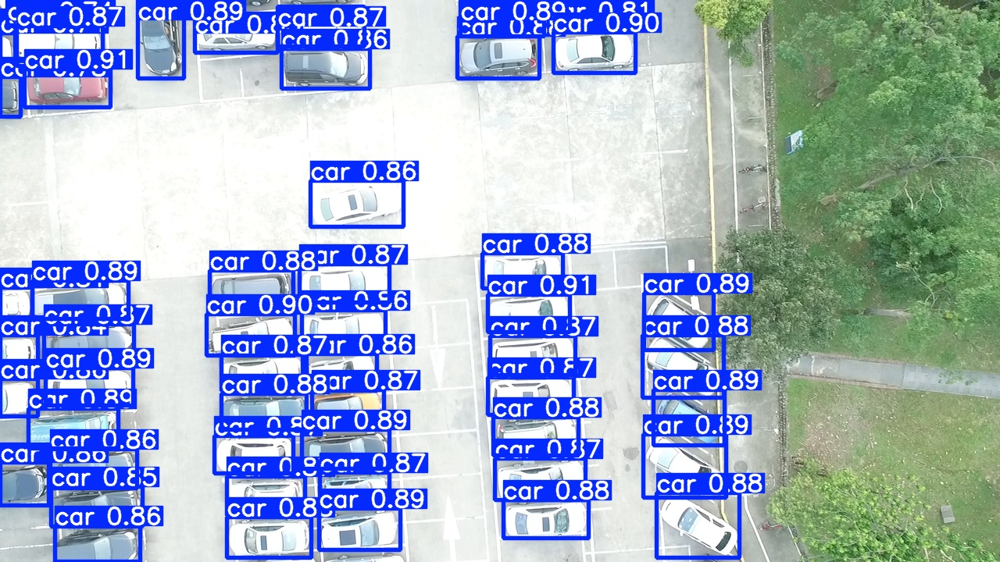

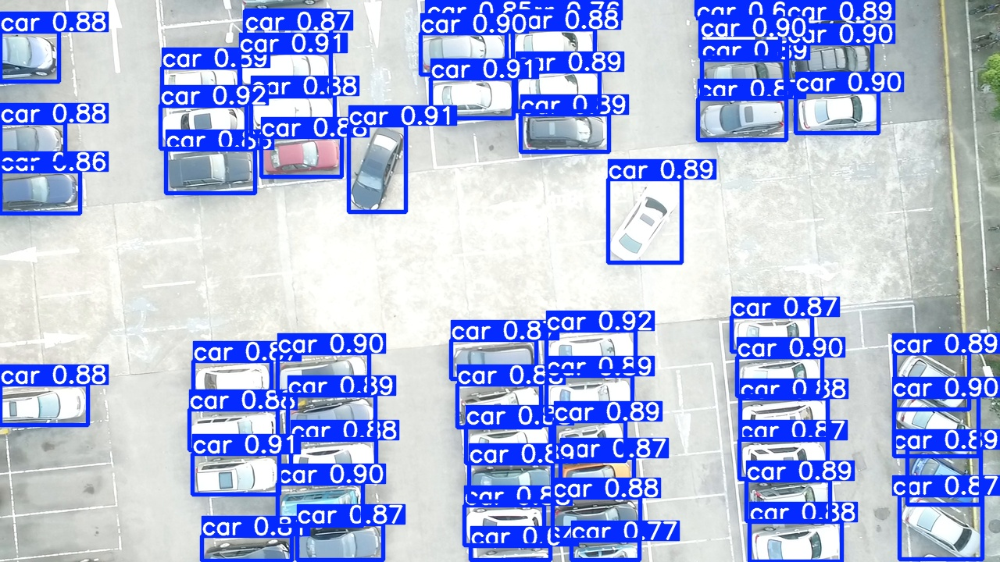

In [ ]:
from IPython.display import Image, display

predict_dir = "/content/runs/detect/predict3"

for img_name in sample_images:
    display(Image(filename=os.path.join(predict_dir, img_name), width=800))
    print("\n")


In [ ]:
label_dir = "/content/drive/MyDrive/cars_dataset/labels/test"

for img_name in sample_images:
    base, _ = os.path.splitext(img_name)
    label_path = os.path.join(label_dir, base + ".txt")
    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            true_count = len(f.readlines())
    else:
        true_count = 0

    pred_result = model(os.path.join(test_dir, img_name), conf=0.25, verbose=False)
    pred_count = len(pred_result[0].boxes)

    print(f"{img_name} → GT: {true_count}, Prediction: {pred_count}")


20160331_NTU_00008.jpg → GT: 12, Prediction: 12
20160331_NTU_00017.jpg → GT: 49, Prediction: 52
20160331_NTU_00019.jpg → GT: 57, Prediction: 58


#**Model 2: YOLOv8n – Freeze First 5 Layers (Default Optimizer and Learning Rate)**

Parameters:

Model: yolov8n.pt

Freeze: 5 (stem + first 2 backbone blocks)

Optimizer: default (AdamW)

Learning rate: default (0.01)

Epochs: 50

Batch size: 16

Image size: 640x640


In this experiment, the first five layers of the YOLOv8n model were frozen during training, including the initial convolutional stem and the first two C2f backbone blocks. This approach preserves the low-level feature extractors learned from pretraining while allowing the deeper layers and detection head to adapt to the new car counting dataset. After training for 50 epochs, the model achieved a Mean Squared Error (MSE) of 2.2700 and an Exact Match Accuracy (EMA) of 44.50% on a test set of 200 images. These results are only slightly lower than the baseline model where all layers were trainable, suggesting that early convolutional features are general enough to transfer well without retraining. Freezing these layers also reduces the number of trainable parameters, leading to faster training and potentially lower memory usage. This configuration demonstrates a good trade-off between efficiency and accuracy, making it a practical option for scenarios with limited computational resources or when faster convergence is desired.

In [ ]:
from ultralytics import YOLO

model = YOLO("yolov8n.pt")

###freeze 5 later deafult optimizer and leanirng rate(0.01)
model.train(
    data="/content/drive/MyDrive/cars_dataset/dataset.yaml",
    epochs=50,
    imgsz=640,
    batch=16,
    name="yolo_freeze5",
    device=0,
    freeze=5
)


Ultralytics 8.3.139 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/cars_dataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=5, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolo_freeze5, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, 

train: Scanning /content/drive/MyDrive/cars_dataset/labels/train.cache... 1000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.7±0.4 ms, read: 249.9±138.6 MB/s, size: 1312.4 KB)


val: Scanning /content/drive/MyDrive/cars_dataset/labels/val.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolo_freeze5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolo_freeze5
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      5.74G      1.457       1.78      1.005        808        640: 100%|██████████| 63/63 [00:15<00:00,  4.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.22it/s]

                   all        200      11906      0.945      0.924       0.96      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      6.69G      1.206     0.7652     0.9228        740        640: 100%|██████████| 63/63 [00:11<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.04it/s]

                   all        200      11906       0.96      0.946      0.973      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      6.69G      1.137     0.6759     0.9051       1137        640: 100%|██████████| 63/63 [00:11<00:00,  5.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.28it/s]

                   all        200      11906       0.98      0.954      0.982      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      6.69G       1.07     0.6266     0.8936       1051        640: 100%|██████████| 63/63 [00:10<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.09it/s]

                   all        200      11906      0.984      0.957      0.986      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      6.69G      1.064     0.6125     0.8923        932        640: 100%|██████████| 63/63 [00:10<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.29it/s]

                   all        200      11906      0.987      0.966       0.99      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      6.69G      1.005     0.5775     0.8799        643        640: 100%|██████████| 63/63 [00:10<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.30it/s]

                   all        200      11906       0.99      0.969      0.991      0.759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      6.69G     0.9945     0.5574     0.8748        660        640: 100%|██████████| 63/63 [00:11<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.07it/s]

                   all        200      11906      0.989      0.971      0.992      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      6.69G     0.9844     0.5436      0.873       1059        640: 100%|██████████| 63/63 [00:10<00:00,  5.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.45it/s]

                   all        200      11906      0.991      0.972      0.992      0.771



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      6.69G     0.9571     0.5307     0.8697        657        640: 100%|██████████| 63/63 [00:10<00:00,  5.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.19it/s]

                   all        200      11906      0.991      0.977      0.993      0.776



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      6.69G      0.953     0.5217      0.867       1005        640: 100%|██████████| 63/63 [00:11<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.28it/s]

                   all        200      11906       0.99      0.976      0.993      0.781



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      6.69G     0.9545      0.517     0.8656        868        640: 100%|██████████| 63/63 [00:10<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.30it/s]

                   all        200      11906      0.991      0.977      0.993      0.778



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      6.69G     0.9354     0.5097     0.8624        600        640: 100%|██████████| 63/63 [00:11<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.52it/s]

                   all        200      11906      0.989      0.979      0.993      0.778



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      6.69G     0.9197     0.4927     0.8609        815        640: 100%|██████████| 63/63 [00:10<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.46it/s]

                   all        200      11906      0.992      0.978      0.993      0.785



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      7.65G      0.918      0.489     0.8609        710        640: 100%|██████████| 63/63 [00:10<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.71it/s]

                   all        200      11906      0.992      0.972      0.993      0.785



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50       7.2G     0.9045     0.4803     0.8554       1045        640: 100%|██████████| 63/63 [00:11<00:00,  5.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.52it/s]

                   all        200      11906      0.993      0.976      0.993        0.8



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50       7.2G     0.8963     0.4785     0.8534       1069        640: 100%|██████████| 63/63 [00:10<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.69it/s]

                   all        200      11906      0.991      0.979      0.994      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      7.21G     0.8967      0.471     0.8537       1222        640: 100%|██████████| 63/63 [00:11<00:00,  5.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.51it/s]

                   all        200      11906      0.991       0.98      0.994      0.793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      8.14G     0.8965      0.473     0.8538        595        640: 100%|██████████| 63/63 [00:11<00:00,  5.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.41it/s]

                   all        200      11906      0.991      0.978      0.994      0.789



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      5.12G     0.8846     0.4671      0.852        582        640: 100%|██████████| 63/63 [00:11<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.78it/s]

                   all        200      11906      0.991      0.979      0.994      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      6.83G     0.8765      0.457     0.8499       1067        640: 100%|██████████| 63/63 [00:10<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.75it/s]

                   all        200      11906      0.993      0.979      0.994      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      6.84G     0.8639     0.4492     0.8493       1002        640: 100%|██████████| 63/63 [00:11<00:00,  5.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.55it/s]

                   all        200      11906      0.993      0.978      0.994      0.805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      6.84G     0.8678     0.4531     0.8489        569        640: 100%|██████████| 63/63 [00:11<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.77it/s]

                   all        200      11906      0.992       0.98      0.994        0.8



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      6.84G     0.8634     0.4528     0.8498        798        640: 100%|██████████| 63/63 [00:11<00:00,  5.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.70it/s]

                   all        200      11906      0.991      0.982      0.994      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      6.85G     0.8624     0.4478     0.8465        758        640: 100%|██████████| 63/63 [00:10<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.56it/s]

                   all        200      11906      0.993       0.98      0.994      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      6.86G     0.8565     0.4394     0.8466        586        640: 100%|██████████| 63/63 [00:10<00:00,  5.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.84it/s]

                   all        200      11906      0.992      0.982      0.994      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50       7.8G     0.8507     0.4391     0.8445        870        640: 100%|██████████| 63/63 [00:11<00:00,  5.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.72it/s]

                   all        200      11906      0.992      0.982      0.994      0.812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      5.85G     0.8415      0.433     0.8451        942        640: 100%|██████████| 63/63 [00:10<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        200      11906      0.993      0.982      0.994      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      5.86G     0.8354     0.4315     0.8414        626        640: 100%|██████████| 63/63 [00:11<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.55it/s]

                   all        200      11906      0.991      0.984      0.994      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      7.55G     0.8279      0.426     0.8439        893        640: 100%|██████████| 63/63 [00:11<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.39it/s]

                   all        200      11906      0.992      0.981      0.994      0.812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50       5.8G     0.8302     0.4275     0.8407       1173        640: 100%|██████████| 63/63 [00:11<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.74it/s]

                   all        200      11906      0.993      0.982      0.994      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      5.81G     0.8187     0.4222     0.8417        777        640: 100%|██████████| 63/63 [00:10<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.81it/s]

                   all        200      11906      0.989      0.983      0.994      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      6.68G     0.8219     0.4211     0.8401        695        640: 100%|██████████| 63/63 [00:11<00:00,  5.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.68it/s]

                   all        200      11906      0.992      0.983      0.994      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      6.68G     0.8177     0.4184     0.8404        617        640: 100%|██████████| 63/63 [00:10<00:00,  5.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.82it/s]

                   all        200      11906      0.993      0.983      0.994      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      6.68G     0.8186     0.4161     0.8391        795        640: 100%|██████████| 63/63 [00:11<00:00,  5.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.61it/s]

                   all        200      11906      0.992      0.983      0.994      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      7.71G     0.8136     0.4152     0.8393        759        640: 100%|██████████| 63/63 [00:11<00:00,  5.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.84it/s]

                   all        200      11906      0.993      0.983      0.994      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      4.54G     0.8061     0.4082     0.8371        804        640: 100%|██████████| 63/63 [00:10<00:00,  5.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.79it/s]

                   all        200      11906      0.993      0.982      0.994      0.822



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      6.22G     0.8155     0.4118     0.8372        930        640: 100%|██████████| 63/63 [00:11<00:00,  5.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.46it/s]

                   all        200      11906      0.992      0.985      0.994      0.826



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      6.23G     0.8069     0.4085     0.8366        995        640: 100%|██████████| 63/63 [00:11<00:00,  5.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        200      11906      0.992      0.984      0.994      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      6.23G     0.7962     0.4032     0.8362        993        640: 100%|██████████| 63/63 [00:10<00:00,  5.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.46it/s]

                   all        200      11906      0.993      0.984      0.994      0.829



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      6.23G     0.7967     0.4033      0.836        438        640: 100%|██████████| 63/63 [00:10<00:00,  5.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.55it/s]

                   all        200      11906      0.991      0.985      0.994      0.821


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      6.24G     0.7597     0.3893     0.8333        669        640: 100%|██████████| 63/63 [00:12<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.23it/s]

                   all        200      11906      0.994      0.982      0.994      0.816



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      6.25G     0.7592     0.3857      0.833        629        640: 100%|██████████| 63/63 [00:09<00:00,  6.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.33it/s]

                   all        200      11906      0.992      0.984      0.994      0.823



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.25G      0.753      0.379     0.8312        546        640: 100%|██████████| 63/63 [00:09<00:00,  6.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.67it/s]

                   all        200      11906      0.992      0.985      0.994      0.823



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      6.25G     0.7394     0.3756     0.8287        408        640: 100%|██████████| 63/63 [00:09<00:00,  6.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.72it/s]

                   all        200      11906      0.994      0.984      0.994      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      6.26G     0.7395      0.373     0.8307        526        640: 100%|██████████| 63/63 [00:09<00:00,  6.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]

                   all        200      11906      0.993      0.984      0.994      0.826



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.27G     0.7357     0.3717     0.8285        441        640: 100%|██████████| 63/63 [00:09<00:00,  6.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.43it/s]

                   all        200      11906       0.99      0.987      0.994      0.827



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.27G     0.7243     0.3655     0.8275        419        640: 100%|██████████| 63/63 [00:09<00:00,  6.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.58it/s]

                   all        200      11906      0.992      0.985      0.994      0.832



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      6.27G     0.7224     0.3632     0.8275        754        640: 100%|██████████| 63/63 [00:09<00:00,  6.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.59it/s]

                   all        200      11906      0.991      0.988      0.994       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      6.27G     0.7162     0.3604     0.8259        582        640: 100%|██████████| 63/63 [00:09<00:00,  6.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.74it/s]

                   all        200      11906      0.994      0.984      0.994      0.831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.27G     0.7141     0.3587     0.8269        635        640: 100%|██████████| 63/63 [00:09<00:00,  6.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.55it/s]

                   all        200      11906      0.991      0.987      0.994      0.832



50 epochs completed in 0.178 hours.
Optimizer stripped from runs/detect/yolo_freeze5/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/yolo_freeze5/weights/best.pt, 6.2MB

Validating runs/detect/yolo_freeze5/weights/best.pt...
Ultralytics 8.3.139 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.23it/s]


                   all        200      11906      0.991      0.987      0.994      0.833
Speed: 0.1ms preprocess, 1.5ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/yolo_freeze5


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7cc0dae10950>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

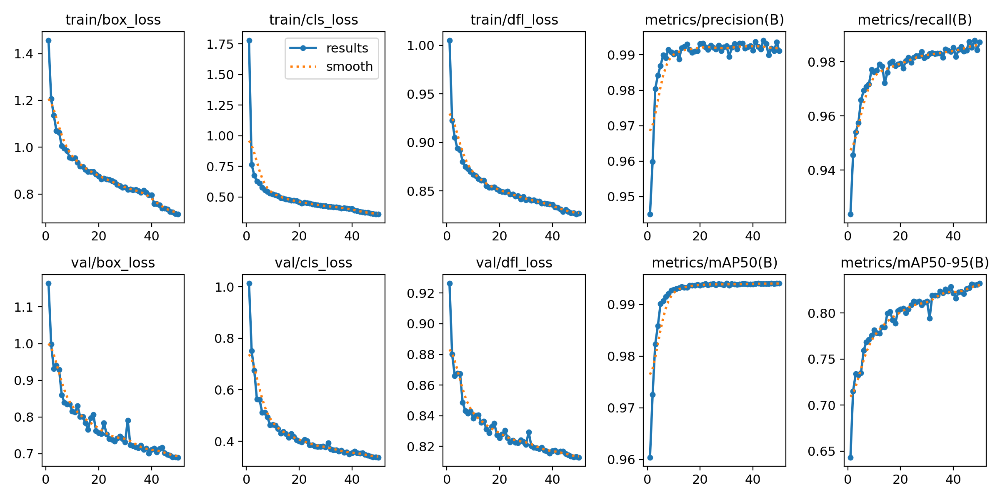

In [ ]:
from IPython.display import Image, display
display(Image(filename="/content/runs/detect/yolo_freeze5/results.png"))

In [8]:
from ultralytics import YOLO
import os
import numpy as np

def evaluate_model(model_path, img_dir, label_dir, conf=0.25, iou=0.5):


    model = YOLO(model_path)

    image_names = sorted(os.listdir(img_dir))
    exact_matches = 0
    sq_errors = []
    total = 0

    for name in image_names:
        base, _ = os.path.splitext(name)
        img_path = os.path.join(img_dir, name)
        label_path = os.path.join(label_dir, base + ".txt")

        if not os.path.exists(label_path):
            continue

        with open(label_path, "r") as f:
            gt_count = len(f.readlines())

        result = model(img_path, conf=conf, iou=iou, verbose=False)
        pred_count = len(result[0].boxes)

        if pred_count == gt_count:
            exact_matches += 1

        sq_errors.append((pred_count - gt_count) ** 2)
        total += 1

    mse = np.mean(sq_errors)
    ema = (exact_matches / total) * 100

    print(f" Model: {model_path}")
    print(f" Mean Squared Error (MSE): {mse:.4f}")
    print(f" Exact Match Accuracy (EMA): {ema:.2f}%")
    print(f"  Değerlendirilen görüntü sayısı: {total}")

    return ema, mse, total


In [ ]:
evaluate_model(
    model_path="/content/runs/detect/yolo_freeze5/weights/best.pt",
    img_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test"
)


 Model: /content/runs/detect/yolo_freeze5/weights/best.pt
 Mean Squared Error (MSE): 2.2700
 Exact Match Accuracy (EMA): 44.50%
  Değerlendirilen görüntü sayısı: 200


(44.5, np.float64(2.27), 200)

In [7]:
import matplotlib.pyplot as plt

def plot_ema_mse(ema, mse, title="Exact Match Accuracy ve Mean Squared Error"):

    fig, ax1 = plt.subplots(figsize=(7, 5))

    ax1.bar(['Exact Match Accuracy'], [ema], color='skyblue', label='EMA (%)')
    ax1.set_ylim(0, 100)
    ax1.set_ylabel('EMA (%)', color='skyblue')
    ax1.set_title(title)

    ax2 = ax1.twinx()
    ax2.plot(['MSE'], [mse], marker='o', markersize=10, color='tomato', label='MSE')
    ax2.set_ylabel('MSE', color='tomato')
    ax2.set_ylim(0, max(mse * 2, 1))

    ax1.text(-0.05, ema + 2, f"{ema:.2f}%", color='blue', fontsize=10)
    ax2.text(0.95, mse + 0.05, f"{mse:.3f}", color='tomato', fontsize=10)

    fig.legend(loc="upper right", bbox_to_anchor=(0.85, 0.9))
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()


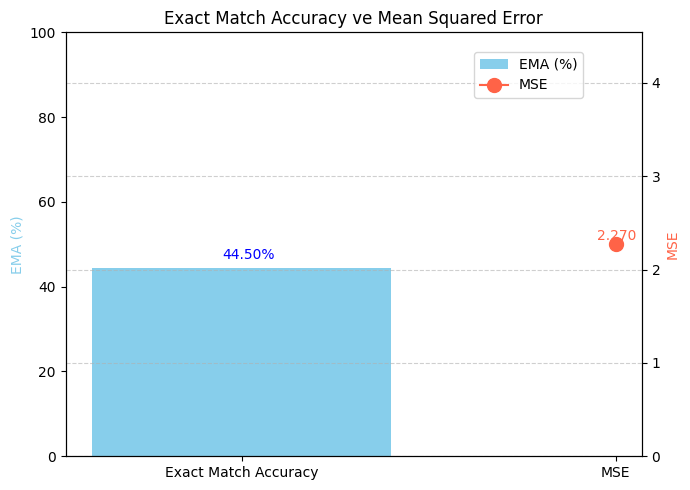

In [ ]:
plot_ema_mse(44.50,2.2700)

In [9]:
from ultralytics import YOLO
from IPython.display import Image, display
import os

def predict_show_compare(model_path, image_dir, label_dir, predict_dir,
                          conf=0.25, iou=0.5, num_images=3):

    sample_images = sorted(os.listdir(image_dir))[:num_images]
    print(f"Prediction output directory: {predict_dir}\n")

    print(" Selected Images:")
    for img in sample_images:
        print("•", img)

    model = YOLO(model_path)

    print("\n Prediction and Count Comparison:\n")
    for img_name in sample_images:
        img_path = os.path.join(image_dir, img_name)
        base, _ = os.path.splitext(img_name)
        label_path = os.path.join(label_dir, base + ".txt")

        true_count = 0
        if os.path.exists(label_path):
            with open(label_path, "r") as f:
                true_count = len(f.readlines())

        result = model(img_path, conf=conf, iou=iou, save=True, save_dir=predict_dir, verbose=False)
        pred_count = len(result[0].boxes)

        display(Image(filename=os.path.join(predict_dir, img_name), width=800))
        print(f" {img_name} → GT: {true_count} car(s), Prediction: {pred_count} car(s)\n")


Choosen Images:
• 20160331_NTU_00008.jpg
• 20160331_NTU_00017.jpg
• 20160331_NTU_00019.jpg

Predicted boxed images and count comparison:



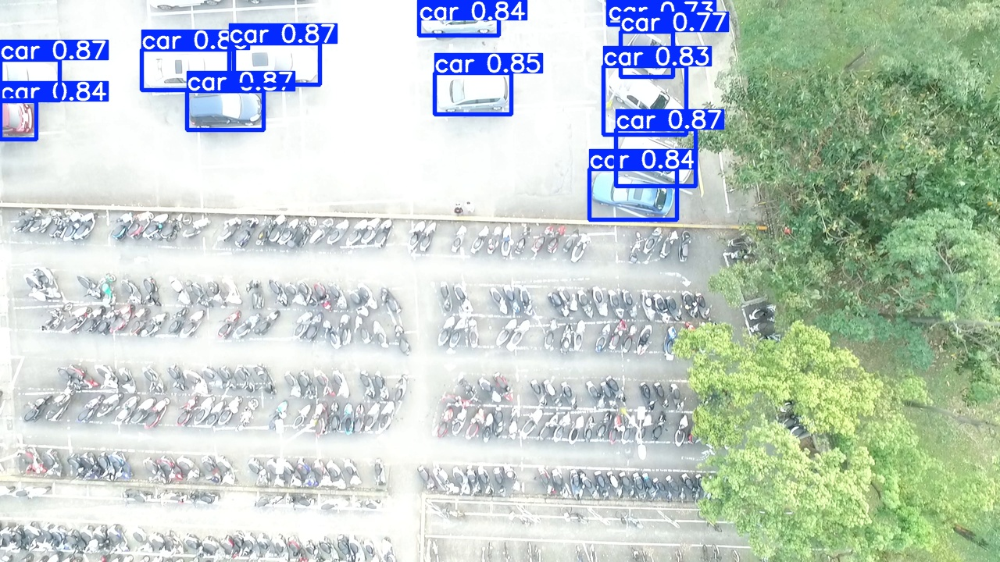

 20160331_NTU_00008.jpg → GT: 12 araç, Prediction: 12 araç



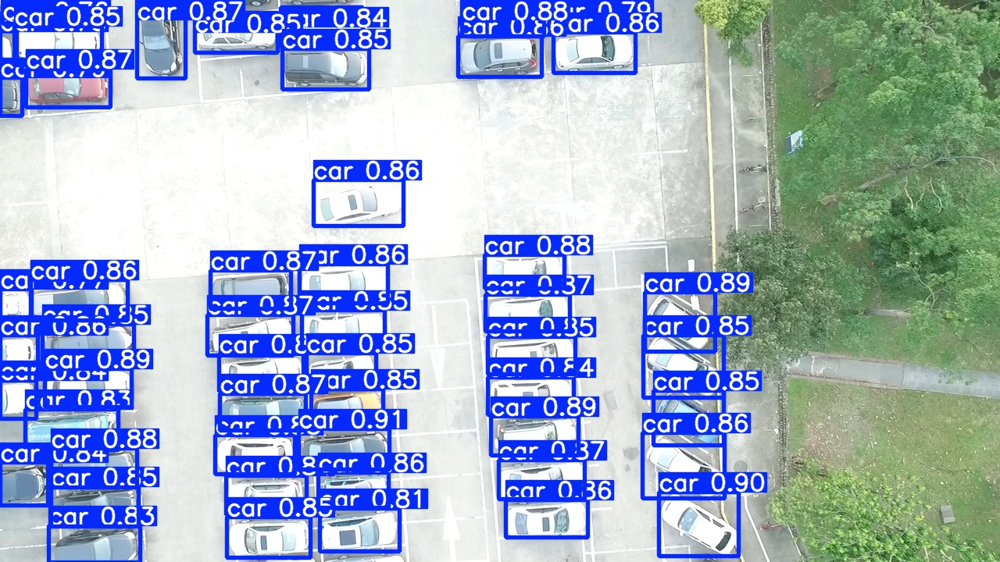

 20160331_NTU_00017.jpg → GT: 49 araç, Prediction: 51 araç



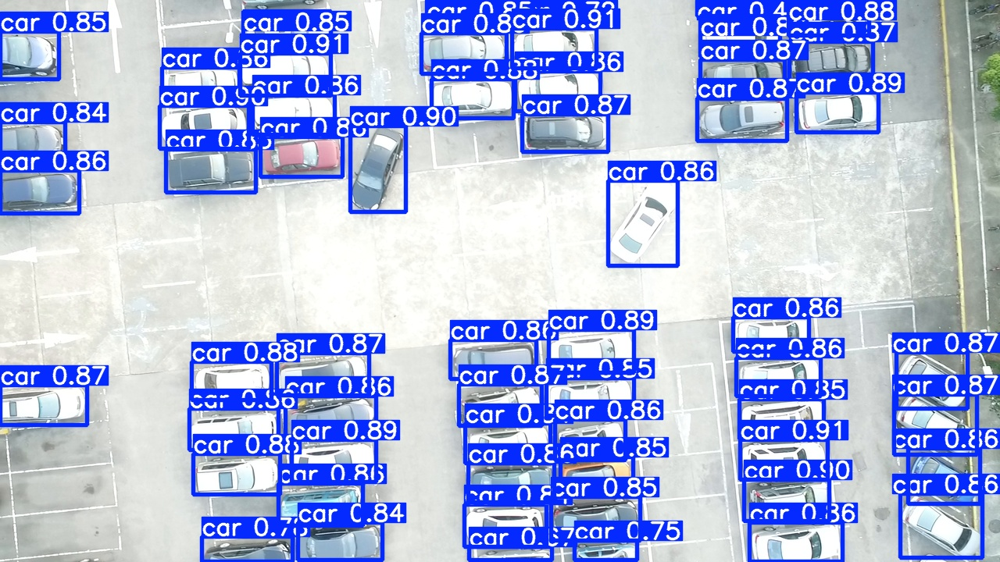

 20160331_NTU_00019.jpg → GT: 57 araç, Prediction: 58 araç



In [ ]:

predict_show_compare(
    model_path="/content/runs/detect/yolo_freeze5/weights/best.pt",
    image_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test",
    predict_dir="runs/detect/predict4",
    num_images=3
)


#**Model 3 : YOLOv8n – Freeze First 5 Layers with Adam Optimizer and Lower Learning Rate (0.001)**

Parameters:

Model: yolov8n.pt

Freeze: 5 (stem + first 2 backbone blocks)

Optimizer: Adam

Learning rate: 0.001

Epochs: 50

Batch size: 16

Image size: 640x640


In this configuration, the same 5-layer freezing strategy as the previous experiment was used, but with a manually specified optimizer (Adam) and a reduced learning rate of 0.001. The goal was to examine how a lower learning rate would affect convergence and generalization when fewer parameters are being updated. After 50 epochs of training, the model achieved a Mean Squared Error (MSE) of 3.4800 and an Exact Match Accuracy (EMA) of 42.50% on the 200-image test set. Compared to the baseline and previous freeze=5 model with a default learning rate, performance decreased slightly in both metrics. This suggests that a learning rate of 0.001 may be too conservative in this context, especially when combined with the Adam optimizer, which already performs internal adaptive scaling. The lower learning rate may have slowed convergence, preventing the model from fully adapting to the dataset within the given epoch limit. These results highlight the importance of tuning learning rate in conjunction with freezing strategies and optimizer choice to balance training stability and model adaptability.

In [ ]:
from ultralytics import YOLO

model = YOLO("yolov8n.pt")


######### freeze 5 layers aptimizer adam and learning rate 0.001
model.train(
    data="/content/drive/MyDrive/cars_dataset/dataset.yaml",
    epochs=50,
    imgsz=640,
    batch=16,
    name="yolo_freeze5_lr001",
    device=0,
    freeze=5,
    lr0=0.001,
    optimizer="Adam"

)


Ultralytics 8.3.139 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/cars_dataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=5, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolo_freeze5_lr001, nbs=64, nms=False, opset=None, optimize=False, optimizer=Adam, overlap_mask=True, patience=100, perspective=0.0, plots

train: Scanning /content/drive/MyDrive/cars_dataset/labels/train.cache... 1000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


WARNING ⚠️ val: Slow image access detected (ping: 60.0±131.0 ms, read: 55.4±54.4 MB/s, size: 1312.4 KB). Use local storage instead of remote/mounted storage for better performance. See https://docs.ultralytics.com/guides/model-training-tips/


val: Scanning /content/drive/MyDrive/cars_dataset/labels/val.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolo_freeze5_lr001/labels.jpg... 
optimizer: Adam(lr=0.001, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolo_freeze5_lr001
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      5.76G      1.404      1.468      1.003        808        640: 100%|██████████| 63/63 [00:13<00:00,  4.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.34it/s]

                   all        200      11906      0.966      0.907      0.964      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      6.72G      1.204     0.7872     0.9347        740        640: 100%|██████████| 63/63 [00:12<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.65it/s]

                   all        200      11906      0.966      0.941      0.977      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      6.72G      1.123     0.6943     0.9092       1137        640: 100%|██████████| 63/63 [00:11<00:00,  5.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.81it/s]

                   all        200      11906      0.975      0.946      0.982      0.745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      6.72G      1.058      0.636     0.8967       1051        640: 100%|██████████| 63/63 [00:10<00:00,  5.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.91it/s]

                   all        200      11906      0.986      0.958      0.987      0.747



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      6.72G      1.052     0.6231     0.8941        932        640: 100%|██████████| 63/63 [00:10<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]

                   all        200      11906      0.987      0.961      0.988      0.754



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      6.72G      1.013     0.5869     0.8843        643        640: 100%|██████████| 63/63 [00:11<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.86it/s]

                   all        200      11906      0.986      0.965      0.989      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      6.72G      1.005     0.5744     0.8786        660        640: 100%|██████████| 63/63 [00:11<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.01it/s]

                   all        200      11906      0.991      0.968      0.991      0.771



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      6.72G     0.9924     0.5646     0.8774       1059        640: 100%|██████████| 63/63 [00:10<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.94it/s]

                   all        200      11906      0.987      0.972      0.992      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      6.72G     0.9635     0.5483     0.8744        657        640: 100%|██████████| 63/63 [00:10<00:00,  5.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.01it/s]

                   all        200      11906      0.989       0.97      0.992      0.768



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      6.72G     0.9627     0.5371     0.8724       1005        640: 100%|██████████| 63/63 [00:10<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.96it/s]

                   all        200      11906       0.99      0.975      0.992      0.779



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      6.72G     0.9637     0.5289     0.8704        868        640: 100%|██████████| 63/63 [00:10<00:00,  5.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.90it/s]

                   all        200      11906      0.988      0.971      0.992      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      6.72G     0.9508     0.5255     0.8683        600        640: 100%|██████████| 63/63 [00:11<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]

                   all        200      11906      0.991      0.975      0.993      0.777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      6.72G     0.9303     0.5088     0.8657        815        640: 100%|██████████| 63/63 [00:10<00:00,  5.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.85it/s]

                   all        200      11906       0.99      0.974      0.993      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      7.68G     0.9239     0.5031     0.8635        710        640: 100%|██████████| 63/63 [00:10<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.83it/s]

                   all        200      11906      0.992      0.976      0.993      0.782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      7.22G      0.915     0.4977       0.86       1045        640: 100%|██████████| 63/63 [00:11<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.94it/s]

                   all        200      11906      0.991      0.975      0.993       0.78



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      7.22G     0.9107      0.493     0.8589       1069        640: 100%|██████████| 63/63 [00:10<00:00,  5.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.17it/s]

                   all        200      11906      0.993      0.977      0.994      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      7.22G     0.9076     0.4849     0.8572       1222        640: 100%|██████████| 63/63 [00:11<00:00,  5.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.68it/s]

                   all        200      11906      0.992      0.978      0.993      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      8.15G     0.9066      0.481      0.858        595        640: 100%|██████████| 63/63 [00:11<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        200      11906       0.99      0.976      0.993      0.788



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      5.14G     0.8916     0.4699     0.8551        582        640: 100%|██████████| 63/63 [00:10<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.05it/s]

                   all        200      11906      0.992      0.979      0.994      0.797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      6.85G     0.8774     0.4618     0.8528       1067        640: 100%|██████████| 63/63 [00:11<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.20it/s]

                   all        200      11906      0.992      0.979      0.994      0.792



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      6.85G     0.8741     0.4598     0.8535       1002        640: 100%|██████████| 63/63 [00:10<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        200      11906      0.992      0.978      0.993      0.796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      6.86G     0.8751     0.4609     0.8531        569        640: 100%|██████████| 63/63 [00:10<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.45it/s]

                   all        200      11906      0.992      0.978      0.994      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      6.86G     0.8633     0.4578     0.8523        798        640: 100%|██████████| 63/63 [00:10<00:00,  5.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.39it/s]

                   all        200      11906       0.99       0.98      0.994      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      6.88G     0.8756     0.4588     0.8513        758        640: 100%|██████████| 63/63 [00:10<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.08it/s]

                   all        200      11906      0.992      0.981      0.994      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      6.89G     0.8622     0.4498     0.8506        586        640: 100%|██████████| 63/63 [00:10<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.48it/s]

                   all        200      11906      0.993      0.979      0.994      0.805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      7.83G     0.8592     0.4471     0.8489        870        640: 100%|██████████| 63/63 [00:11<00:00,  5.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.43it/s]

                   all        200      11906      0.991      0.982      0.994      0.805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      5.88G     0.8536     0.4418     0.8492        942        640: 100%|██████████| 63/63 [00:10<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.39it/s]

                   all        200      11906      0.992       0.98      0.994      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      5.88G     0.8489     0.4375     0.8462        626        640: 100%|██████████| 63/63 [00:10<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.41it/s]

                   all        200      11906      0.992      0.982      0.994      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      7.57G      0.843     0.4332     0.8481        893        640: 100%|██████████| 63/63 [00:11<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.41it/s]

                   all        200      11906      0.993       0.98      0.994      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      5.82G     0.8444     0.4336     0.8452       1173        640: 100%|██████████| 63/63 [00:10<00:00,  5.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.51it/s]

                   all        200      11906      0.992      0.981      0.994      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      5.83G     0.8308     0.4294     0.8458        777        640: 100%|██████████| 63/63 [00:10<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.57it/s]

                   all        200      11906      0.993      0.982      0.994      0.801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50       6.7G     0.8376     0.4311     0.8451        695        640: 100%|██████████| 63/63 [00:11<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.67it/s]

                   all        200      11906      0.993      0.983      0.994      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50       6.7G     0.8339     0.4286      0.845        617        640: 100%|██████████| 63/63 [00:10<00:00,  5.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.32it/s]

                   all        200      11906      0.993      0.982      0.994      0.812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50       6.7G     0.8344     0.4246     0.8439        795        640: 100%|██████████| 63/63 [00:11<00:00,  5.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.58it/s]

                   all        200      11906      0.991      0.984      0.994      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      7.73G     0.8342     0.4219     0.8453        759        640: 100%|██████████| 63/63 [00:11<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.48it/s]

                   all        200      11906      0.993      0.983      0.994      0.811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      4.56G     0.8166     0.4153      0.841        804        640: 100%|██████████| 63/63 [00:10<00:00,  5.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.68it/s]

                   all        200      11906      0.993      0.982      0.994      0.815



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      6.25G     0.8239     0.4167     0.8407        930        640: 100%|██████████| 63/63 [00:11<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.73it/s]

                   all        200      11906      0.993      0.983      0.994      0.815



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      6.25G     0.8202     0.4155      0.841        995        640: 100%|██████████| 63/63 [00:11<00:00,  5.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.83it/s]

                   all        200      11906      0.992      0.984      0.994      0.812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      6.25G     0.8135     0.4097     0.8415        993        640: 100%|██████████| 63/63 [00:10<00:00,  5.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.87it/s]

                   all        200      11906      0.994      0.982      0.994      0.811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      6.25G     0.8076     0.4098     0.8402        438        640: 100%|██████████| 63/63 [00:10<00:00,  5.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.48it/s]

                   all        200      11906      0.993      0.983      0.994      0.815


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      6.25G     0.7729     0.4035     0.8381        669        640: 100%|██████████| 63/63 [00:12<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.29it/s]

                   all        200      11906      0.994      0.983      0.994       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      6.25G     0.7675     0.3976     0.8365        629        640: 100%|██████████| 63/63 [00:09<00:00,  6.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.57it/s]

                   all        200      11906      0.994      0.982      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.25G     0.7639     0.3913     0.8347        546        640: 100%|██████████| 63/63 [00:09<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.35it/s]

                   all        200      11906      0.994      0.984      0.994      0.812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      6.26G     0.7546     0.3861     0.8331        408        640: 100%|██████████| 63/63 [00:09<00:00,  6.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.23it/s]

                   all        200      11906      0.992      0.983      0.994      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      6.27G     0.7532     0.3836     0.8349        526        640: 100%|██████████| 63/63 [00:09<00:00,  6.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.17it/s]

                   all        200      11906      0.993      0.983      0.994      0.816



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.28G     0.7496     0.3815     0.8329        441        640: 100%|██████████| 63/63 [00:09<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.11it/s]

                   all        200      11906      0.994      0.983      0.994      0.817



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.29G     0.7388     0.3753     0.8317        419        640: 100%|██████████| 63/63 [00:09<00:00,  6.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.47it/s]

                   all        200      11906      0.993      0.984      0.994      0.817



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      6.29G     0.7408     0.3751     0.8328        754        640: 100%|██████████| 63/63 [00:09<00:00,  6.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.67it/s]

                   all        200      11906      0.993      0.984      0.994      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      6.29G     0.7329     0.3715     0.8308        582        640: 100%|██████████| 63/63 [00:09<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.60it/s]

                   all        200      11906      0.994      0.984      0.994      0.818



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.29G     0.7306     0.3706     0.8316        635        640: 100%|██████████| 63/63 [00:09<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.53it/s]

                   all        200      11906      0.994      0.984      0.994      0.819



50 epochs completed in 0.179 hours.
Optimizer stripped from runs/detect/yolo_freeze5_lr001/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/yolo_freeze5_lr001/weights/best.pt, 6.2MB

Validating runs/detect/yolo_freeze5_lr001/weights/best.pt...
Ultralytics 8.3.139 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.31it/s]


                   all        200      11906      0.994      0.984      0.994      0.819
Speed: 0.1ms preprocess, 1.3ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/yolo_freeze5_lr001


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7cc17cac2f90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

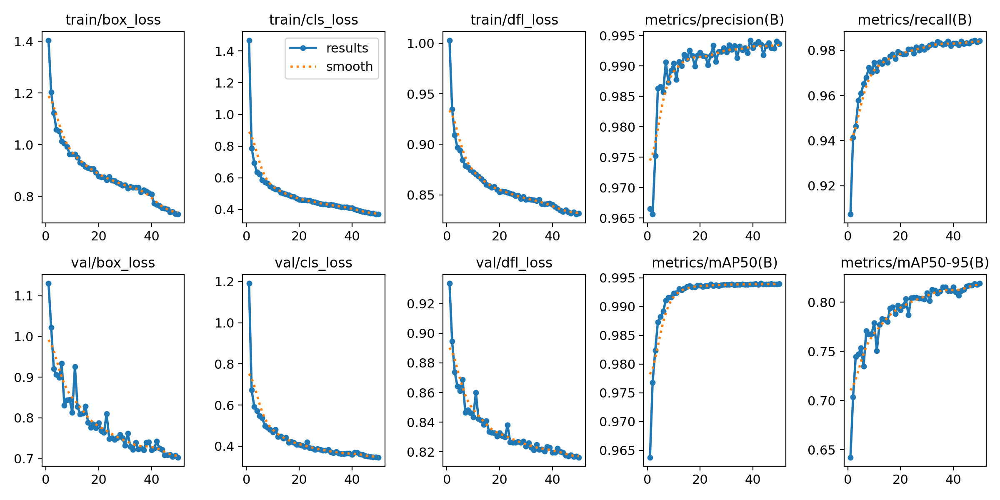

 Model: /content/runs/detect/yolo_freeze5_lr001/weights/best.pt
 Mean Squared Error (MSE): 3.4800
 Exact Match Accuracy (EMA): 42.50%
  Değerlendirilen görüntü sayısı: 200


(42.5, np.float64(3.48), 200)

In [ ]:
from IPython.display import Image, display
display(Image(filename="/content/runs/detect/yolo_freeze5_lr001/results.png"))

evaluate_model(
    model_path="/content/runs/detect/yolo_freeze5_lr001/weights/best.pt",
    img_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test"
)



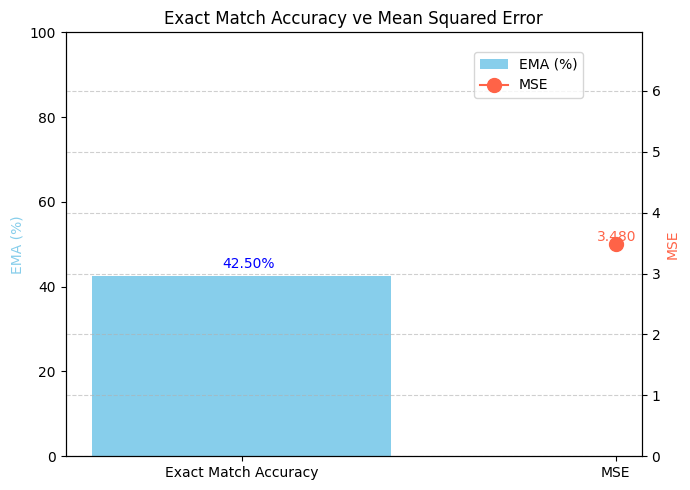

Prediction output directory: runs/detect/predict10

 Selected Images:
• 20160331_NTU_00008.jpg
• 20160331_NTU_00017.jpg
• 20160331_NTU_00019.jpg

 Prediction and Count Comparison:

Results saved to runs/detect/predict10


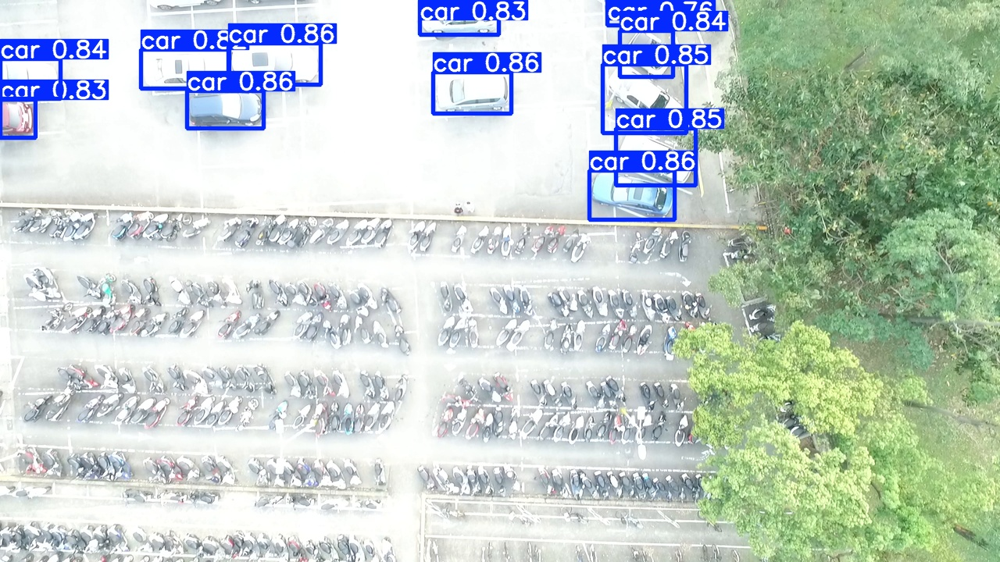

 20160331_NTU_00008.jpg → GT: 12 car(s), Prediction: 12 car(s)

Results saved to runs/detect/predict10


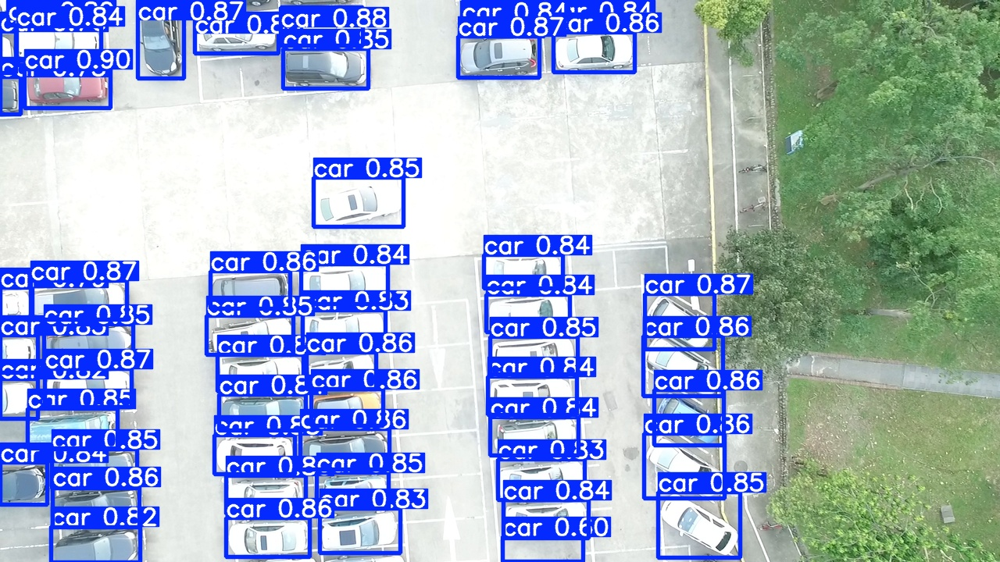

 20160331_NTU_00017.jpg → GT: 49 car(s), Prediction: 52 car(s)

Results saved to runs/detect/predict10


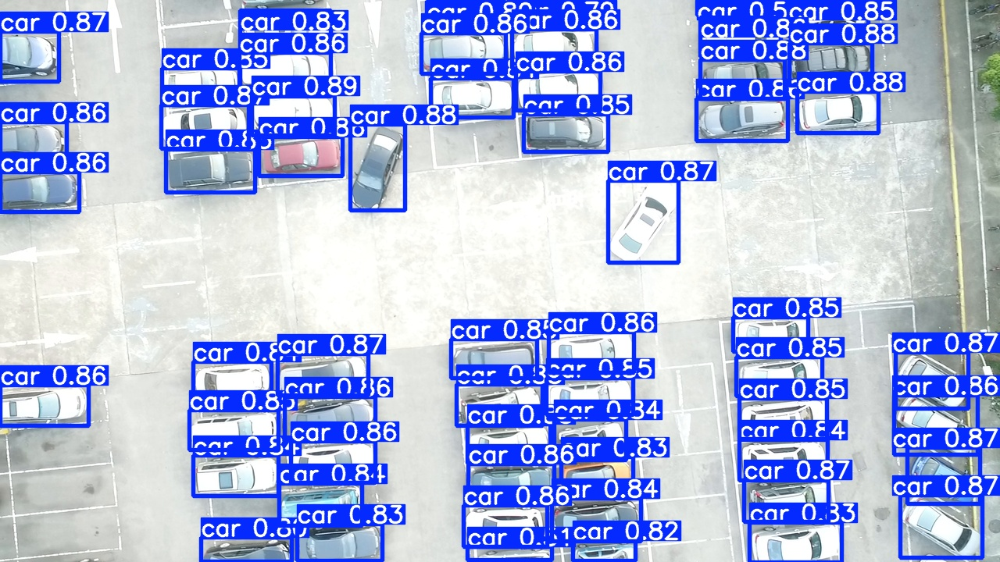

 20160331_NTU_00019.jpg → GT: 57 car(s), Prediction: 58 car(s)



In [ ]:
plot_ema_mse(42.50,3.4800)


predict_show_compare(
    model_path="/content/runs/detect/yolo_freeze5_lr001/weights/best.pt",
    image_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test",
    predict_dir="runs/detect/predict10",
    num_images=3
)


#**Model 4: YOLOv8n – Freeze First 5 Layers with Adam Optimizer and Learning Rate 0.005**

Parameters:

Model: yolov8n.pt

Freeze: 5 (stem + first 2 backbone blocks)

Optimizer: Adam

Learning rate: 0.005

Epochs: 50

Batch size: 16

Image size: 640x640


This training configuration again froze the first five layers of the YOLOv8n model but used the Adam optimizer with a slightly higher learning rate of 0.005. The aim was to observe whether increasing the learning rate could accelerate convergence and improve learning dynamics for the trainable layers. After 50 epochs of training, the model achieved a Mean Squared Error (MSE) of 3.2700 and an Exact Match Accuracy (EMA) of 42.00% on the 200-image test set. These results are very close to the previous Adam experiment with a learning rate of 0.001, indicating that neither value significantly improved performance over the default optimizer. The model underperformed compared to the baseline (lr0=0.01, optimizer=auto) despite the higher learning rate, possibly due to overfitting or instability in gradient updates caused by the combination of a moderate learning rate and frozen layers. This suggests that manually adjusting learning rate and optimizer requires careful balancing, and that the default configuration provided by Ultralytics (which uses adaptive tuning internally) may be more robust for this task unless further fine-tuning is applied.

In [ ]:
from ultralytics import YOLO

model = YOLO("yolov8n.pt")

######### freeze 5 layers aptimizer adam and learning rate 0.005

model.train(
    data="/content/drive/MyDrive/cars_dataset/dataset.yaml",
    epochs=50,
    imgsz=640,
    batch=16,
    name="yolo_freeze5_lr005",
    device=0,
    freeze=5,
    lr0=0.005,
    optimizer="Adam"

)


Ultralytics 8.3.139 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/cars_dataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=5, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.005, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolo_freeze5_lr005, nbs=64, nms=False, opset=None, optimize=False, optimizer=Adam, overlap_mask=True, patience=100, perspective=0.0, plots

train: Scanning /content/drive/MyDrive/cars_dataset/labels/train.cache... 1000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


WARNING ⚠️ val: Slow image access detected (ping: 78.9±175.0 ms, read: 149.7±137.8 MB/s, size: 1312.4 KB). Use local storage instead of remote/mounted storage for better performance. See https://docs.ultralytics.com/guides/model-training-tips/


val: Scanning /content/drive/MyDrive/cars_dataset/labels/val.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolo_freeze5_lr005/labels.jpg... 
optimizer: Adam(lr=0.005, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolo_freeze5_lr005
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      5.81G      1.399       1.34     0.9999        808        640: 100%|██████████| 63/63 [00:13<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.68it/s]

                   all        200      11906      0.916      0.913      0.958      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      6.75G      1.218     0.7652     0.9395        740        640: 100%|██████████| 63/63 [00:11<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.81it/s]

                   all        200      11906      0.957      0.941      0.974      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      6.75G      1.157     0.6844      0.918       1137        640: 100%|██████████| 63/63 [00:11<00:00,  5.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.16it/s]

                   all        200      11906      0.969      0.951      0.978      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      6.75G      1.088     0.6246     0.9062       1051        640: 100%|██████████| 63/63 [00:10<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.40it/s]

                   all        200      11906      0.984       0.96      0.985      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      6.75G      1.067     0.6036     0.8998        932        640: 100%|██████████| 63/63 [00:11<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.35it/s]

                   all        200      11906      0.987      0.963      0.988      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      6.75G      1.039     0.5746     0.8923        643        640: 100%|██████████| 63/63 [00:11<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.46it/s]

                   all        200      11906       0.98      0.967      0.988      0.746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      6.75G      1.021     0.5619     0.8846        660        640: 100%|██████████| 63/63 [00:11<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.46it/s]

                   all        200      11906       0.99      0.967      0.992      0.762



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      6.75G     0.9842     0.5361     0.8791       1059        640: 100%|██████████| 63/63 [00:11<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.41it/s]

                   all        200      11906      0.988      0.972      0.992      0.766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      6.75G     0.9823     0.5284     0.8786        657        640: 100%|██████████| 63/63 [00:10<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.55it/s]

                   all        200      11906      0.989      0.971      0.992      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      6.75G     0.9698     0.5158     0.8753       1005        640: 100%|██████████| 63/63 [00:11<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.57it/s]

                   all        200      11906       0.99      0.974      0.993      0.778



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      6.75G     0.9768     0.5117     0.8743        868        640: 100%|██████████| 63/63 [00:11<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.63it/s]

                   all        200      11906      0.989      0.973      0.992      0.775



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      6.75G     0.9628     0.5055     0.8714        600        640: 100%|██████████| 63/63 [00:11<00:00,  5.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.67it/s]

                   all        200      11906       0.99      0.976      0.993      0.784



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      6.75G     0.9373     0.4872      0.868        815        640: 100%|██████████| 63/63 [00:10<00:00,  5.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.46it/s]

                   all        200      11906      0.988      0.976      0.993      0.772



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      7.71G     0.9351      0.486     0.8672        710        640: 100%|██████████| 63/63 [00:10<00:00,  5.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.77it/s]

                   all        200      11906      0.988      0.978      0.993      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      7.25G      0.916     0.4753     0.8616       1045        640: 100%|██████████| 63/63 [00:11<00:00,  5.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.74it/s]

                   all        200      11906       0.99      0.977      0.993      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      7.25G     0.9192     0.4751     0.8605       1069        640: 100%|██████████| 63/63 [00:10<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.28it/s]

                   all        200      11906      0.989       0.98      0.993      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      7.25G     0.9204     0.4712     0.8599       1222        640: 100%|██████████| 63/63 [00:11<00:00,  5.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.72it/s]

                   all        200      11906      0.991      0.978      0.993      0.796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      8.18G     0.9021     0.4644      0.858        595        640: 100%|██████████| 63/63 [00:11<00:00,  5.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.59it/s]

                   all        200      11906      0.991      0.979      0.994      0.799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      5.15G     0.8902      0.455      0.856        582        640: 100%|██████████| 63/63 [00:11<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.77it/s]

                   all        200      11906       0.99      0.981      0.994      0.796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      6.86G     0.9034     0.4595     0.8573       1067        640: 100%|██████████| 63/63 [00:11<00:00,  5.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.65it/s]

                   all        200      11906      0.992      0.979      0.994      0.798



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      6.86G     0.8856     0.4489     0.8561       1002        640: 100%|██████████| 63/63 [00:11<00:00,  5.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.83it/s]

                   all        200      11906      0.992      0.978      0.993      0.805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      6.86G     0.8908     0.4547     0.8558        569        640: 100%|██████████| 63/63 [00:10<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.62it/s]

                   all        200      11906      0.991       0.98      0.994      0.796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      6.86G      0.873     0.4502     0.8552        798        640: 100%|██████████| 63/63 [00:11<00:00,  5.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.79it/s]

                   all        200      11906      0.992       0.98      0.994      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      6.87G     0.8899     0.4559     0.8541        758        640: 100%|██████████| 63/63 [00:11<00:00,  5.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.51it/s]

                   all        200      11906      0.989      0.984      0.994      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      6.88G     0.8823     0.4456     0.8541        586        640: 100%|██████████| 63/63 [00:11<00:00,  5.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.42it/s]

                   all        200      11906      0.991      0.983      0.994      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      7.82G     0.8681     0.4391     0.8509        870        640: 100%|██████████| 63/63 [00:11<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.60it/s]

                   all        200      11906      0.992      0.982      0.994      0.814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      5.88G     0.8586     0.4307     0.8508        942        640: 100%|██████████| 63/63 [00:11<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.59it/s]

                   all        200      11906      0.992      0.982      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      5.88G     0.8511     0.4292     0.8468        626        640: 100%|██████████| 63/63 [00:10<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.43it/s]

                   all        200      11906       0.99      0.983      0.994      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      7.57G     0.8437     0.4243     0.8493        893        640: 100%|██████████| 63/63 [00:10<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.33it/s]

                   all        200      11906      0.991      0.983      0.994      0.812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      5.82G     0.8481     0.4256     0.8461       1173        640: 100%|██████████| 63/63 [00:11<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.46it/s]

                   all        200      11906      0.992      0.981      0.994      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      5.83G     0.8415     0.4249     0.8483        777        640: 100%|██████████| 63/63 [00:10<00:00,  5.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.69it/s]

                   all        200      11906      0.993      0.982      0.994      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50       6.7G     0.8617     0.4261     0.8488        695        640: 100%|██████████| 63/63 [00:11<00:00,  5.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.76it/s]

                   all        200      11906      0.992      0.984      0.994      0.817



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      6.71G     0.8364     0.4159     0.8462        617        640: 100%|██████████| 63/63 [00:10<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.66it/s]

                   all        200      11906      0.991      0.987      0.994      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      6.72G     0.8279     0.4116     0.8437        795        640: 100%|██████████| 63/63 [00:11<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.45it/s]

                   all        200      11906      0.994      0.982      0.994      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      7.73G     0.8304     0.4135     0.8451        759        640: 100%|██████████| 63/63 [00:11<00:00,  5.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        200      11906      0.992      0.984      0.994      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      4.54G     0.8197     0.4075     0.8418        804        640: 100%|██████████| 63/63 [00:10<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.71it/s]

                   all        200      11906      0.993      0.983      0.994      0.822



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      6.23G     0.8242     0.4069     0.8411        930        640: 100%|██████████| 63/63 [00:11<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.55it/s]

                   all        200      11906      0.994      0.984      0.994      0.827



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      6.24G     0.8193     0.4063     0.8415        995        640: 100%|██████████| 63/63 [00:10<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.77it/s]

                   all        200      11906      0.992      0.985      0.994      0.818



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      6.24G     0.8101     0.3994     0.8414        993        640: 100%|██████████| 63/63 [00:10<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.04it/s]

                   all        200      11906      0.993      0.984      0.994      0.826



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      6.24G      0.819     0.4026     0.8422        438        640: 100%|██████████| 63/63 [00:10<00:00,  5.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.81it/s]

                   all        200      11906      0.992      0.984      0.994      0.823


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      6.25G     0.7735      0.387     0.8398        669        640: 100%|██████████| 63/63 [00:12<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.66it/s]

                   all        200      11906      0.992      0.984      0.994      0.818



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      6.26G     0.7835     0.3863     0.8412        629        640: 100%|██████████| 63/63 [00:09<00:00,  6.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.67it/s]

                   all        200      11906      0.994      0.983      0.994      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.28G     0.7666     0.3764     0.8375        546        640: 100%|██████████| 63/63 [00:09<00:00,  6.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.89it/s]

                   all        200      11906      0.993      0.984      0.994      0.829



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      6.29G     0.7543     0.3723     0.8352        408        640: 100%|██████████| 63/63 [00:09<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.90it/s]

                   all        200      11906      0.995      0.983      0.994      0.828



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      6.29G     0.7546     0.3699      0.837        526        640: 100%|██████████| 63/63 [00:09<00:00,  6.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.52it/s]

                   all        200      11906      0.995      0.983      0.994      0.831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.29G      0.749     0.3661      0.835        441        640: 100%|██████████| 63/63 [00:09<00:00,  6.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.67it/s]

                   all        200      11906      0.995      0.984      0.994      0.833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.31G     0.7353     0.3575     0.8328        419        640: 100%|██████████| 63/63 [00:09<00:00,  6.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.84it/s]

                   all        200      11906      0.996      0.983      0.994      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      6.31G     0.7351     0.3563      0.833        754        640: 100%|██████████| 63/63 [00:09<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.93it/s]

                   all        200      11906      0.994      0.985      0.994      0.835



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      6.31G     0.7267     0.3527      0.831        582        640: 100%|██████████| 63/63 [00:09<00:00,  6.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.82it/s]

                   all        200      11906      0.995      0.984      0.994      0.835



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.31G      0.724     0.3495     0.8319        635        640: 100%|██████████| 63/63 [00:09<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.79it/s]

                   all        200      11906      0.994      0.985      0.994      0.838



50 epochs completed in 0.178 hours.
Optimizer stripped from runs/detect/yolo_freeze5_lr005/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/yolo_freeze5_lr005/weights/best.pt, 6.2MB

Validating runs/detect/yolo_freeze5_lr005/weights/best.pt...
Ultralytics 8.3.139 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.30it/s]


                   all        200      11906      0.994      0.985      0.994      0.838
Speed: 0.1ms preprocess, 1.4ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/yolo_freeze5_lr005


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7cc0db721dd0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

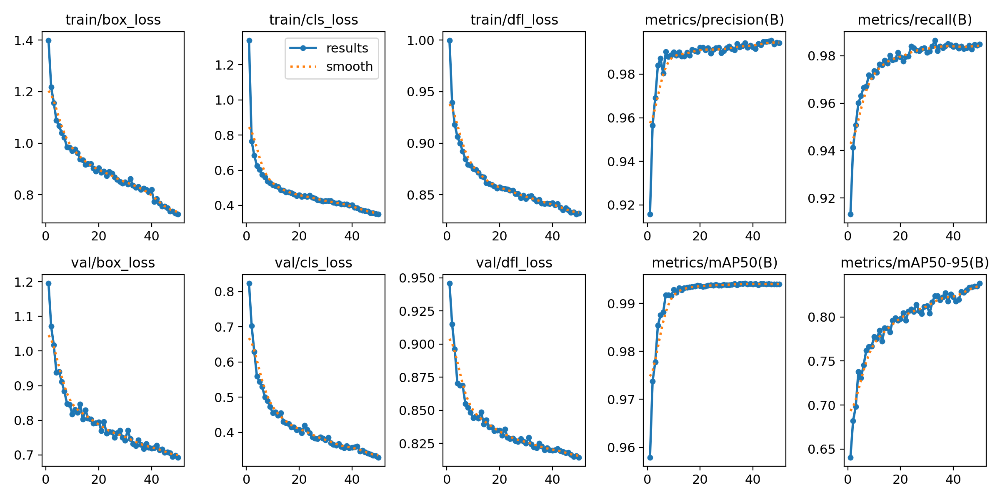

 Model: /content/runs/detect/yolo_freeze5_lr005/weights/best.pt
 Mean Squared Error (MSE): 3.2700
 Exact Match Accuracy (EMA): 42.00%
  Değerlendirilen görüntü sayısı: 200


(42.0, np.float64(3.27), 200)

In [ ]:
from IPython.display import Image, display
display(Image(filename="/content/runs/detect/yolo_freeze5_lr005/results.png"))

evaluate_model(
    model_path="/content/runs/detect/yolo_freeze5_lr005/weights/best.pt",
    img_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test"
)



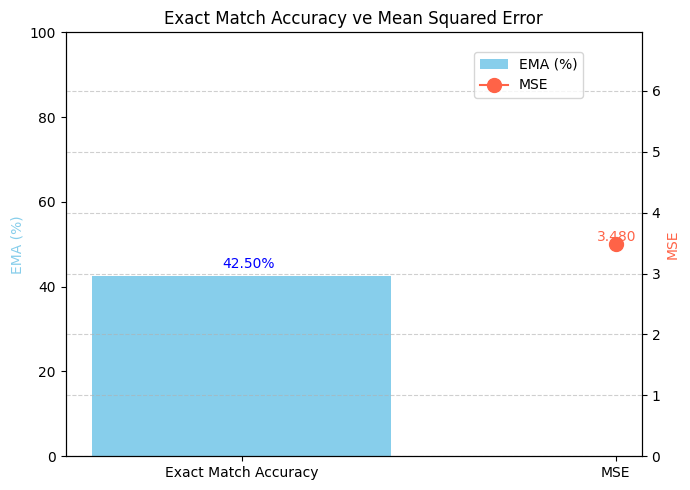

Prediction output directory: runs/detect/predict11

 Selected Images:
• 20160331_NTU_00008.jpg
• 20160331_NTU_00017.jpg
• 20160331_NTU_00019.jpg

 Prediction and Count Comparison:

Results saved to runs/detect/predict11


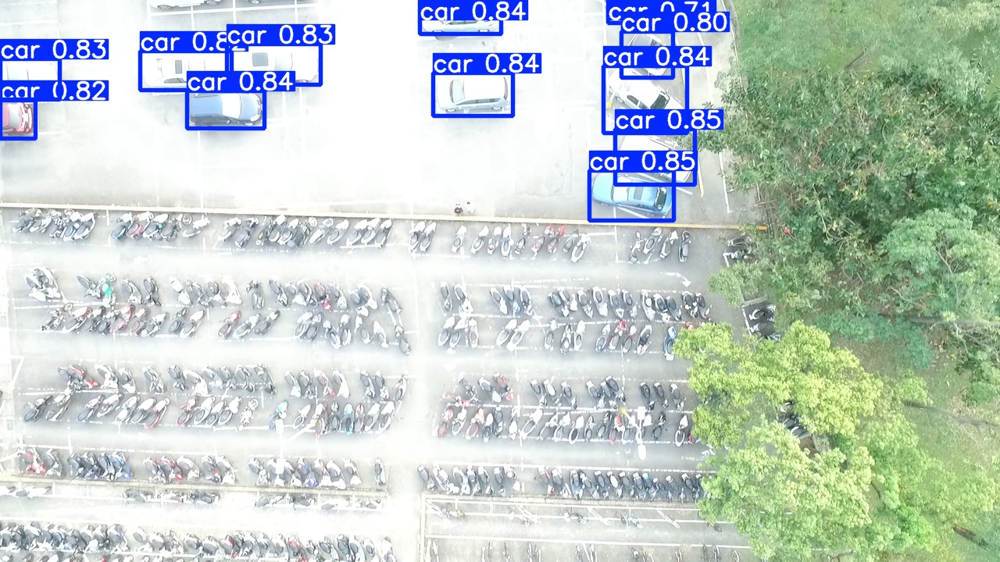

 20160331_NTU_00008.jpg → GT: 12 car(s), Prediction: 12 car(s)

Results saved to runs/detect/predict11


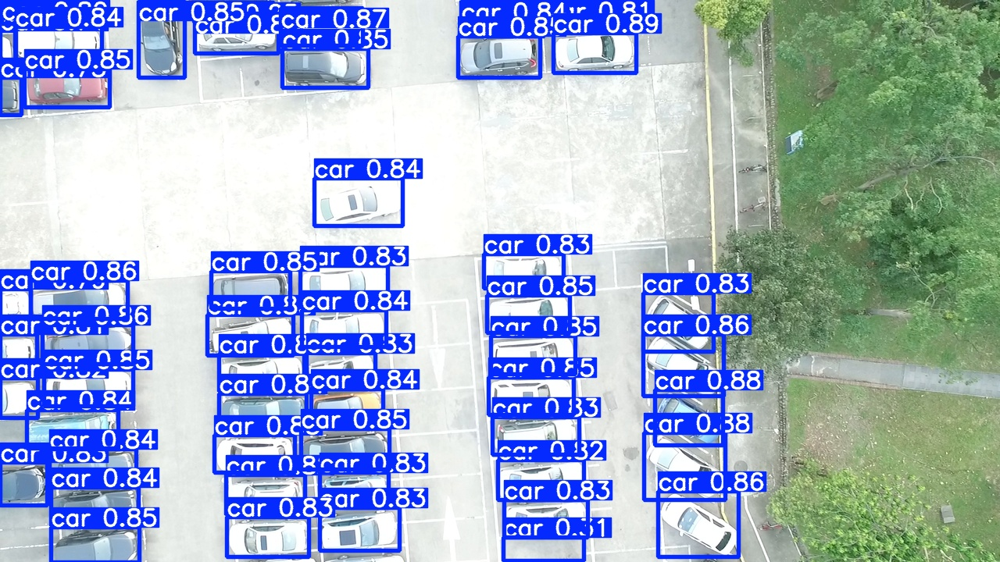

 20160331_NTU_00017.jpg → GT: 49 car(s), Prediction: 53 car(s)

Results saved to runs/detect/predict11


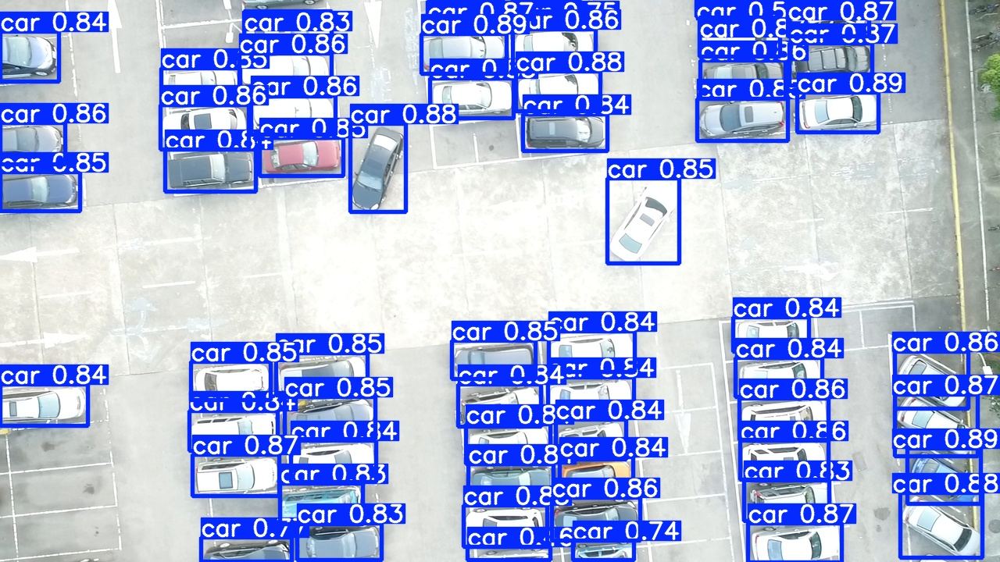

 20160331_NTU_00019.jpg → GT: 57 car(s), Prediction: 58 car(s)



In [ ]:
plot_ema_mse(42.50,3.4800)


predict_show_compare(
    model_path="/content/runs/detect/yolo_freeze5_lr005/weights/best.pt",
    image_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test",
    predict_dir="runs/detect/predict11",
    num_images=3
)


#**Model 5: YOLOv8n – Freeze First 5 Layers with SGD Optimizer and Learning Rate 0.005**

Parameters:

Model: yolov8n.pt

Freeze: 5 (stem + first 2 backbone blocks)

Optimizer: SGD

Learning rate: 0.005

Epochs: 50

Batch size: 16

Image size: 640x640


In this configuration, the model was trained with the first five layers frozen and the Stochastic Gradient Descent (SGD) optimizer, using a moderate learning rate of 0.005. This experiment was designed to compare the effects of using a non-adaptive optimizer (SGD) versus adaptive optimizers like Adam. After 50 epochs, the model yielded a Mean Squared Error (MSE) of 3.6300 and an Exact Match Accuracy (EMA) of 43.00% on the 200-image test set. While the EMA is slightly higher than the model trained with Adam (lr=0.005), the MSE increased, indicating less consistent bounding box predictions overall. This result suggests that while SGD may improve stability in classification confidence (hence slightly better EMA), it may lag behind adaptive optimizers in convergence speed and localization accuracy without extensive tuning. Additionally, the lack of momentum or advanced learning rate scheduling might have limited SGD’s effectiveness in this scenario. Overall, the performance was moderate, but not better than the default optimizer setup.



In [3]:
from ultralytics import YOLO
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

model = YOLO("yolov8n.pt")

######### freeze 5 layers aptimizer SGD and learning rate 0.005

model.train(
    data="/content/drive/MyDrive/cars_dataset/dataset.yaml",
    epochs=50,
    imgsz=640,
    batch=16,
    name="yolo_freeze5_lr005.v1",
    device=0,
    freeze=5,
    lr0=0.005,
    optimizer="SGD"

)


Mounted at /content/drive
Ultralytics 8.3.140 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/cars_dataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=5, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.005, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolo_freeze5_lr005.v12, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patienc

100%|██████████| 755k/755k [00:00<00:00, 114MB/s]

Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

 22        [15, 18, 21]  1    751507  ultralytics.nn.modules.head.Detect           [1, [64, 128, 256]]           
Model summary: 129 layers, 3,011,043 parameters, 3,011,027 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
Freezing layer 'model.0.conv.weight'
Freezing layer 'model.0.bn.weight'
Freezing layer 'model.0.bn.bias'
Freezing layer 'model.1.conv.weight'
Freezing layer 'model.1.bn.weight'
Freezing layer 'model.1.bn.bias'
Freezing layer 'model.2.cv1.conv.weight'
Freezing layer 'model.2.cv1.bn.weight'
Freezing layer 'model.2.cv1.bn.bias'
Freezing layer 'model.2.cv2.conv.weight'
Freezing layer 'model.2.cv2.bn.weight'
Freezing layer 'model.2.cv2.bn.bias'
Freezing layer 'model.2.m.0.cv1.conv.weight'
Freezing layer 'model.2.m.0.cv1.bn.weight'
Freezing layer 'model.2.m.0.cv1.bn.bias'
Freezing layer 'model.2.m.0.cv2.conv.weight'
Freezing layer 'model.2.m.0.cv2.bn.weight'
Freezing layer 'model.2.m.0.cv2.bn.bias'
Freezing layer 'model.3.conv.weight'
Freezing layer 

100%|██████████| 5.35M/5.35M [00:00<00:00, 337MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.3±0.1 ms, read: 1.3±0.3 MB/s, size: 1365.5 KB)


train: Scanning /content/drive/MyDrive/cars_dataset/labels/train.cache... 1000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.4±0.1 ms, read: 1.5±0.5 MB/s, size: 1312.4 KB)


val: Scanning /content/drive/MyDrive/cars_dataset/labels/val.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolo_freeze5_lr005.v12/labels.jpg... 
optimizer: SGD(lr=0.005, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolo_freeze5_lr005.v12
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      5.67G      1.453      1.783      1.077        808        640: 100%|██████████| 63/63 [01:03<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:44<00:00,  6.33s/it]

                   all        200      11906      0.956      0.884      0.956       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      6.64G      1.237      0.804     0.9764        740        640: 100%|██████████| 63/63 [00:10<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.63it/s]

                   all        200      11906      0.962      0.924      0.971      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      6.64G      1.217     0.7414     0.9562       1137        640: 100%|██████████| 63/63 [00:10<00:00,  5.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.72it/s]

                   all        200      11906      0.972      0.939      0.977      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      6.65G      1.167     0.6993     0.9446       1051        640: 100%|██████████| 63/63 [00:10<00:00,  5.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.58it/s]

                   all        200      11906      0.978      0.947       0.98      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      6.65G      1.133     0.6875     0.9347        932        640: 100%|██████████| 63/63 [00:10<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.55it/s]

                   all        200      11906      0.984      0.955      0.982      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      6.65G      1.101     0.6518     0.9229        643        640: 100%|██████████| 63/63 [00:10<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.59it/s]

                   all        200      11906      0.986      0.959      0.985      0.749



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      6.65G      1.074     0.6372     0.9138        660        640: 100%|██████████| 63/63 [00:10<00:00,  5.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.66it/s]

                   all        200      11906      0.988       0.96      0.988      0.757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      6.65G      1.057     0.6133     0.9094       1059        640: 100%|██████████| 63/63 [00:10<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.60it/s]

                   all        200      11906      0.988      0.963      0.989       0.75



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      6.65G      1.025     0.5999     0.9024        657        640: 100%|██████████| 63/63 [00:10<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.86it/s]

                   all        200      11906       0.99      0.962       0.99       0.76



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      6.65G      1.021     0.5883     0.8999       1005        640: 100%|██████████| 63/63 [00:10<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.88it/s]

                   all        200      11906      0.989      0.966      0.991      0.766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      6.65G      1.014     0.5879     0.8967        868        640: 100%|██████████| 63/63 [00:10<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.12it/s]

                   all        200      11906      0.989      0.968      0.992      0.779



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      6.65G      1.002     0.5685     0.8942        600        640: 100%|██████████| 63/63 [00:10<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]

                   all        200      11906      0.989       0.97      0.992      0.766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      6.65G     0.9802     0.5549     0.8909        815        640: 100%|██████████| 63/63 [00:10<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.01it/s]

                   all        200      11906      0.991      0.971      0.992      0.757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      7.61G     0.9703     0.5562     0.8883        710        640: 100%|██████████| 63/63 [00:10<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.19it/s]

                   all        200      11906       0.99      0.972      0.992      0.777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      7.19G     0.9709     0.5419     0.8858       1045        640: 100%|██████████| 63/63 [00:10<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.20it/s]

                   all        200      11906       0.99      0.972      0.993       0.77



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      7.19G     0.9635     0.5381     0.8819       1069        640: 100%|██████████| 63/63 [00:10<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.17it/s]

                   all        200      11906       0.99      0.974      0.993      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      7.19G     0.9652     0.5324     0.8811       1222        640: 100%|██████████| 63/63 [00:10<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.10it/s]

                   all        200      11906       0.99      0.975      0.993       0.78



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      8.12G     0.9523     0.5241     0.8793        595        640: 100%|██████████| 63/63 [00:10<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.07it/s]

                   all        200      11906       0.99      0.976      0.993      0.791



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      5.12G     0.9392     0.5169     0.8774        582        640: 100%|██████████| 63/63 [00:10<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.15it/s]

                   all        200      11906      0.992      0.974      0.993      0.793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      6.82G     0.9305     0.5092     0.8757       1067        640: 100%|██████████| 63/63 [00:10<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.13it/s]

                   all        200      11906      0.992      0.976      0.993      0.782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      6.83G     0.9286     0.5087     0.8759       1002        640: 100%|██████████| 63/63 [00:10<00:00,  5.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.21it/s]

                   all        200      11906      0.991      0.976      0.993      0.791



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      6.83G     0.9294     0.5066     0.8759        569        640: 100%|██████████| 63/63 [00:10<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.16it/s]

                   all        200      11906      0.992      0.974      0.993      0.792



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      6.83G       0.91     0.4998      0.874        798        640: 100%|██████████| 63/63 [00:10<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.24it/s]

                   all        200      11906      0.991      0.977      0.993      0.788



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      6.83G     0.9221     0.5014     0.8722        758        640: 100%|██████████| 63/63 [00:10<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.00it/s]

                   all        200      11906      0.992      0.976      0.993      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      6.83G     0.9091     0.4964     0.8718        586        640: 100%|██████████| 63/63 [00:10<00:00,  5.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.96it/s]

                   all        200      11906      0.993      0.975      0.993      0.799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      7.77G     0.9051      0.494     0.8701        870        640: 100%|██████████| 63/63 [00:10<00:00,  5.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.09it/s]

                   all        200      11906      0.992      0.976      0.993      0.796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      5.84G     0.8935     0.4884     0.8695        942        640: 100%|██████████| 63/63 [00:10<00:00,  5.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.15it/s]

                   all        200      11906      0.992      0.975      0.993      0.796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      5.85G     0.8908     0.4816      0.865        626        640: 100%|██████████| 63/63 [00:10<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.11it/s]

                   all        200      11906      0.993      0.976      0.994      0.797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      7.53G     0.8854     0.4756     0.8693        893        640: 100%|██████████| 63/63 [00:10<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.29it/s]

                   all        200      11906      0.991      0.977      0.993      0.797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      5.79G     0.8849     0.4772     0.8638       1173        640: 100%|██████████| 63/63 [00:10<00:00,  5.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.32it/s]

                   all        200      11906      0.991      0.977      0.993      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      5.79G     0.8699     0.4706     0.8656        777        640: 100%|██████████| 63/63 [00:10<00:00,  5.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.29it/s]

                   all        200      11906      0.992      0.977      0.993      0.801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      6.66G     0.8732     0.4714     0.8639        695        640: 100%|██████████| 63/63 [00:10<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.39it/s]

                   all        200      11906      0.992      0.977      0.993      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      6.66G     0.8675     0.4693     0.8638        617        640: 100%|██████████| 63/63 [00:10<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.35it/s]

                   all        200      11906      0.992      0.978      0.993      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      6.66G     0.8674      0.464     0.8619        795        640: 100%|██████████| 63/63 [00:10<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.16it/s]

                   all        200      11906      0.991      0.978      0.993      0.805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      7.67G     0.8643     0.4619     0.8638        759        640: 100%|██████████| 63/63 [00:10<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.35it/s]

                   all        200      11906      0.992      0.977      0.993      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      4.51G     0.8561     0.4581     0.8597        804        640: 100%|██████████| 63/63 [00:10<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.29it/s]

                   all        200      11906      0.992      0.977      0.993      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50       6.2G     0.8648     0.4597     0.8596        930        640: 100%|██████████| 63/63 [00:10<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.33it/s]

                   all        200      11906      0.992      0.977      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50       6.2G     0.8578     0.4566     0.8597        995        640: 100%|██████████| 63/63 [00:10<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.15it/s]

                   all        200      11906      0.992      0.979      0.994      0.808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      6.21G     0.8481     0.4518     0.8597        993        640: 100%|██████████| 63/63 [00:10<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.22it/s]

                   all        200      11906      0.993      0.977      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      6.22G     0.8465     0.4512      0.859        438        640: 100%|██████████| 63/63 [00:10<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.33it/s]

                   all        200      11906      0.991       0.98      0.994      0.804


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      6.23G     0.8087     0.4484     0.8614        669        640: 100%|██████████| 63/63 [00:12<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.58it/s]

                   all        200      11906      0.992      0.979      0.994      0.805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      6.23G     0.8007     0.4371     0.8587        629        640: 100%|██████████| 63/63 [00:09<00:00,  6.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.48it/s]

                   all        200      11906       0.99       0.98      0.994      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.23G     0.7949     0.4309     0.8563        546        640: 100%|██████████| 63/63 [00:09<00:00,  6.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.71it/s]

                   all        200      11906      0.991       0.98      0.994      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      6.23G     0.7836     0.4261      0.854        408        640: 100%|██████████| 63/63 [00:09<00:00,  6.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.19it/s]

                   all        200      11906      0.993      0.979      0.994      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      6.23G     0.7864     0.4253     0.8565        526        640: 100%|██████████| 63/63 [00:09<00:00,  6.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.92it/s]

                   all        200      11906      0.992       0.98      0.994      0.808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.23G     0.7825     0.4245     0.8551        441        640: 100%|██████████| 63/63 [00:10<00:00,  6.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.00it/s]

                   all        200      11906      0.992       0.98      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.23G     0.7723     0.4167     0.8526        419        640: 100%|██████████| 63/63 [00:09<00:00,  6.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        200      11906      0.992      0.981      0.994      0.808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      6.23G     0.7755     0.4172     0.8542        754        640: 100%|██████████| 63/63 [00:09<00:00,  6.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.79it/s]

                   all        200      11906      0.991      0.981      0.994      0.808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      6.23G     0.7696      0.415     0.8524        582        640: 100%|██████████| 63/63 [00:09<00:00,  6.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.83it/s]

                   all        200      11906      0.992       0.98      0.994      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.23G     0.7687     0.4141     0.8538        635        640: 100%|██████████| 63/63 [00:09<00:00,  6.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.05it/s]

                   all        200      11906      0.992      0.981      0.994      0.808



50 epochs completed in 0.203 hours.
Optimizer stripped from runs/detect/yolo_freeze5_lr005.v12/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/yolo_freeze5_lr005.v12/weights/best.pt, 6.2MB

Validating runs/detect/yolo_freeze5_lr005.v12/weights/best.pt...
Ultralytics 8.3.140 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.17it/s]


                   all        200      11906      0.992      0.981      0.994      0.809
Speed: 0.1ms preprocess, 1.4ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/yolo_freeze5_lr005.v12


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78b792aa2410>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

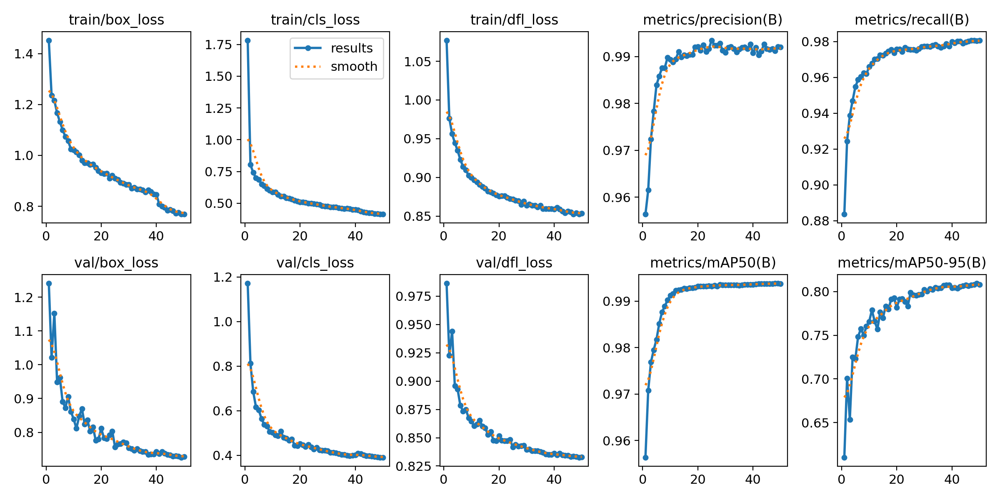

 Model: /content/runs/detect/yolo_freeze5_lr005.v12/weights/best.pt
 Mean Squared Error (MSE): 3.6300
 Exact Match Accuracy (EMA): 43.00%
  Değerlendirilen görüntü sayısı: 200


(43.0, np.float64(3.63), 200)

In [10]:
from IPython.display import Image, display
display(Image(filename="/content/runs/detect/yolo_freeze5_lr005.v12/results.png"))

evaluate_model(
    model_path="/content/runs/detect/yolo_freeze5_lr005.v12/weights/best.pt",
    img_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test"
)


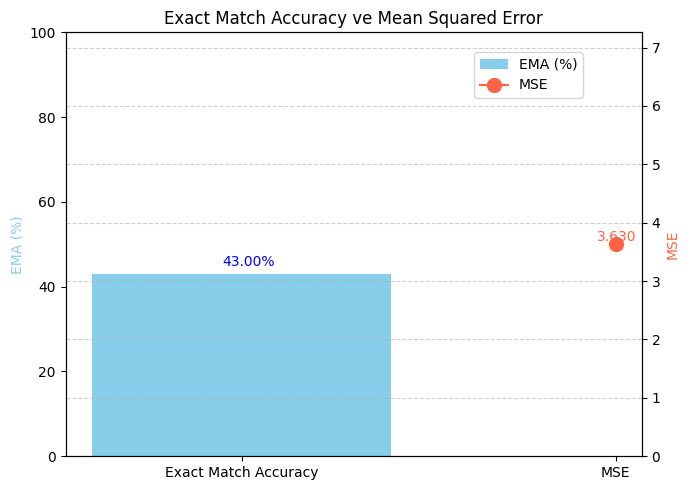

Prediction output directory: runs/detect/predict

 Selected Images:
• 20160331_NTU_00008.jpg
• 20160331_NTU_00017.jpg
• 20160331_NTU_00019.jpg

 Prediction and Count Comparison:

Results saved to runs/detect/predict


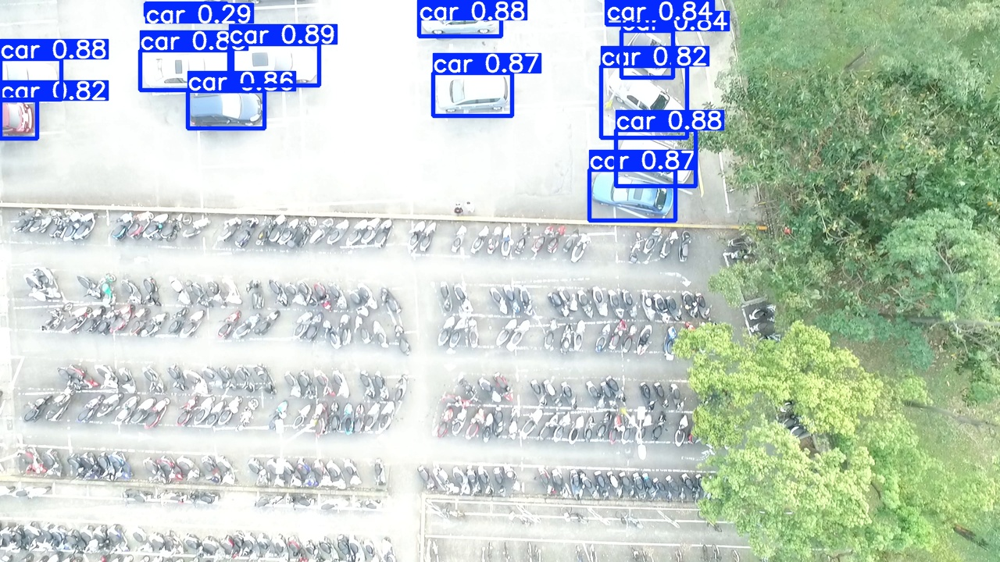

 20160331_NTU_00008.jpg → GT: 12 car(s), Prediction: 13 car(s)

Results saved to runs/detect/predict


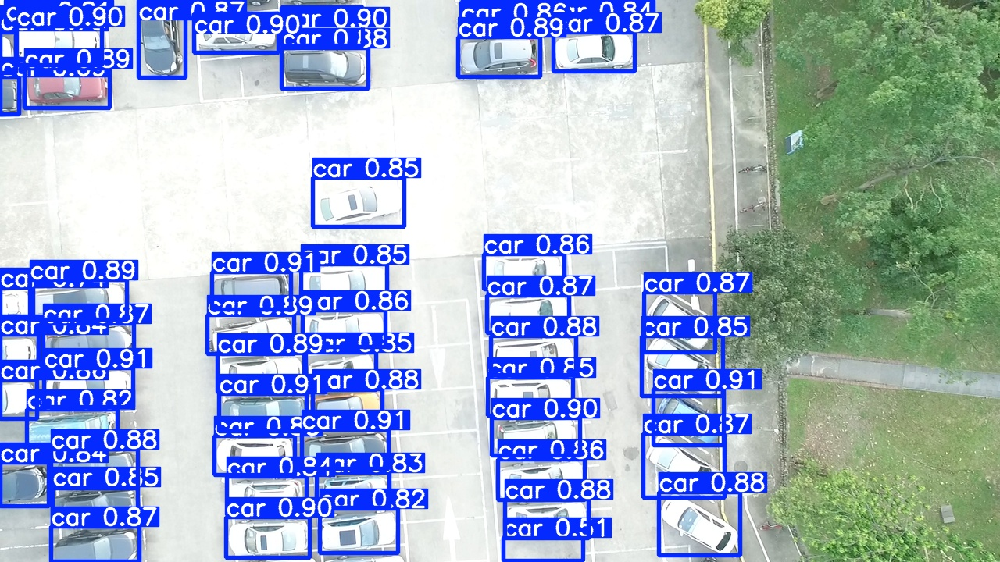

 20160331_NTU_00017.jpg → GT: 49 car(s), Prediction: 53 car(s)

Results saved to runs/detect/predict


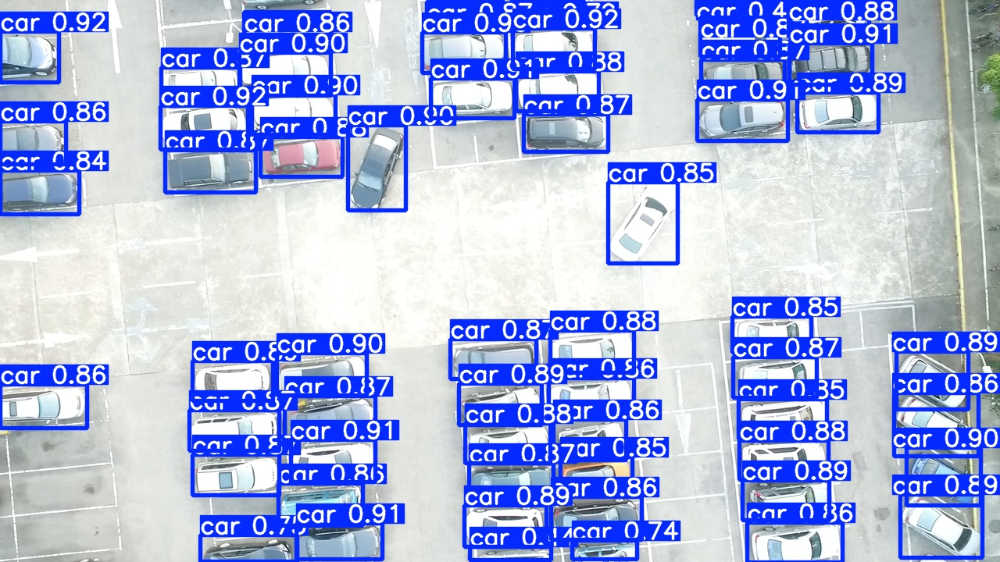

 20160331_NTU_00019.jpg → GT: 57 car(s), Prediction: 58 car(s)



In [11]:
plot_ema_mse(43.00,3.6300
)


predict_show_compare(
    model_path="/content/runs/detect/yolo_freeze5_lr005.v12/weights/best.pt",
    image_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test",
    predict_dir="runs/detect/predict",
    num_images=3
)

#**Model 6: YOLOv8n – Freeze First 5 Layers with SGD Optimizer, Learning Rate 0.005, and Batch Size 32**


Parameters:

Model: yolov8n.pt

Freeze: 5 (stem + first 2 backbone blocks)

Optimizer: SGD

Learning rate: 0.005

Epochs: 50

Batch size: 32

Image size: 640x640


This configuration maintains the same freezing strategy (freeze=5) and optimizer (SGD) as the previous experiment but increases the batch size from 16 to 32. The purpose was to investigate whether a larger batch size would stabilize training, improve gradient estimation, or enhance generalization. After 50 epochs, the model achieved a Mean Squared Error (MSE) of 3.4200 and an Exact Match Accuracy (EMA) of 39.50% on the 200-image test set. Interestingly, while the MSE slightly improved compared to the same model trained with a smaller batch size (indicating better bounding box localization), the EMA decreased. This may suggest that larger batches led to more averaged updates, reducing model flexibility in detecting exact counts, especially in images with varied object density. Although training with a larger batch size is generally more stable, it may require additional tuning (e.g., longer training, adjusted learning rate schedules) to fully realize its benefits. In this case, increasing batch size alone did not yield a significant performance improvement.

In [12]:
from ultralytics import YOLO
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

model = YOLO("yolov8n.pt")

######### freeze 5 layers aptimizer SGD and learning rate 0.005 batch size 32

model.train(
    data="/content/drive/MyDrive/cars_dataset/dataset.yaml",
    epochs=50,
    imgsz=640,
    batch=32,
    name="yolo_freeze5_lr005.v2",
    device=0,
    freeze=5,
    lr0=0.005,
    optimizer="SGD"

)


Mounted at /content/drive
Ultralytics 8.3.140 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/cars_dataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=5, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.005, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolo_freeze5_lr005.v2, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience

train: Scanning /content/drive/MyDrive/cars_dataset/labels/train.cache... 1000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 5.2±6.6 ms, read: 191.0±188.6 MB/s, size: 1312.4 KB)


val: Scanning /content/drive/MyDrive/cars_dataset/labels/val.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolo_freeze5_lr005.v2/labels.jpg... 
optimizer: SGD(lr=0.005, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolo_freeze5_lr005.v2
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50       8.6G      1.547      2.347      1.113       1015        640: 100%|██████████| 32/32 [00:14<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.56it/s]

                   all        200      11906      0.964      0.839      0.948      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      9.66G      1.243     0.8297     0.9755        810        640: 100%|██████████| 32/32 [00:10<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.03it/s]

                   all        200      11906      0.983      0.893      0.967      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      8.84G      1.206     0.7539     0.9559        682        640: 100%|██████████| 32/32 [00:10<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.02it/s]

                   all        200      11906      0.979      0.924      0.974      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      8.56G       1.17     0.7164     0.9499        594        640: 100%|██████████| 32/32 [00:10<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.02it/s]

                   all        200      11906      0.981      0.943      0.979      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      10.4G      1.132     0.6947     0.9304        512        640: 100%|██████████| 32/32 [00:10<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]

                   all        200      11906      0.983      0.955      0.981      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      8.88G      1.098     0.6677     0.9275        359        640: 100%|██████████| 32/32 [00:10<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.04it/s]

                   all        200      11906      0.987      0.954      0.983      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      9.68G       1.08      0.636     0.9123       1080        640: 100%|██████████| 32/32 [00:10<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]

                   all        200      11906      0.988      0.961      0.987      0.745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      7.46G      1.056     0.6156     0.9099        764        640: 100%|██████████| 32/32 [00:10<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.16it/s]

                   all        200      11906      0.988      0.961      0.989      0.764



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      10.6G      1.036     0.5977     0.9043        947        640: 100%|██████████| 32/32 [00:10<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.16it/s]

                   all        200      11906      0.989      0.962       0.99      0.768



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      10.4G      1.023     0.5851      0.899        592        640: 100%|██████████| 32/32 [00:10<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]

                   all        200      11906       0.99      0.966      0.991      0.764



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      8.47G      1.022     0.5839     0.8965        972        640: 100%|██████████| 32/32 [00:10<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.32it/s]

                   all        200      11906      0.988      0.972      0.991       0.77



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      8.19G          1     0.5743      0.892        989        640: 100%|██████████| 32/32 [00:10<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        200      11906       0.99      0.969      0.992      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      8.38G     0.9783     0.5518     0.8899       1006        640: 100%|██████████| 32/32 [00:10<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.35it/s]

                   all        200      11906       0.99       0.97      0.992      0.779



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      7.69G     0.9707     0.5598     0.8867        820        640: 100%|██████████| 32/32 [00:10<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        200      11906      0.989      0.973      0.992       0.77



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      8.88G     0.9678     0.5427      0.885       1309        640: 100%|██████████| 32/32 [00:10<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        200      11906      0.991      0.974      0.993      0.785



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      9.21G     0.9615     0.5439     0.8799       1313        640: 100%|██████████| 32/32 [00:10<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.50it/s]

                   all        200      11906       0.99      0.974      0.993      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      11.4G     0.9563     0.5228      0.882        726        640: 100%|██████████| 32/32 [00:10<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        200      11906       0.99      0.975      0.993      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      11.1G     0.9414     0.5233     0.8771        642        640: 100%|██████████| 32/32 [00:10<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        200      11906      0.991      0.972      0.993      0.784



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      7.66G     0.9322     0.5204     0.8755        826        640: 100%|██████████| 32/32 [00:10<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.37it/s]

                   all        200      11906      0.991      0.973      0.993      0.792



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      9.54G     0.9221     0.5088      0.875        690        640: 100%|██████████| 32/32 [00:10<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        200      11906      0.991      0.975      0.993      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      9.62G     0.9356     0.5078      0.874        955        640: 100%|██████████| 32/32 [00:10<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.34it/s]

                   all        200      11906       0.99      0.976      0.993      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      6.26G     0.9059     0.4978     0.8734        905        640: 100%|██████████| 32/32 [00:10<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        200      11906      0.992      0.977      0.993      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      9.68G      0.926     0.5051     0.8729        968        640: 100%|██████████| 32/32 [00:10<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.38it/s]

                   all        200      11906      0.991      0.975      0.993      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      9.49G     0.9108     0.4996     0.8711        516        640: 100%|██████████| 32/32 [00:10<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.46it/s]

                   all        200      11906      0.992      0.975      0.993      0.797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      10.3G     0.9046     0.4962     0.8726        556        640: 100%|██████████| 32/32 [00:10<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        200      11906      0.993      0.974      0.993      0.798



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      8.23G     0.9015     0.4916     0.8682        987        640: 100%|██████████| 32/32 [00:10<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.34it/s]

                   all        200      11906       0.99      0.978      0.993      0.799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      10.1G     0.8939     0.4843     0.8684        930        640: 100%|██████████| 32/32 [00:10<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.47it/s]

                   all        200      11906      0.991      0.977      0.993      0.793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      8.36G     0.8832     0.4791     0.8657        982        640: 100%|██████████| 32/32 [00:10<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.46it/s]

                   all        200      11906      0.992      0.978      0.994        0.8



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      13.6G     0.8786     0.4756      0.865        486        640: 100%|██████████| 32/32 [00:10<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        200      11906       0.99      0.979      0.993      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      7.35G     0.8882     0.4753      0.866        696        640: 100%|██████████| 32/32 [00:10<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.47it/s]

                   all        200      11906      0.992      0.977      0.993      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      7.36G     0.8758     0.4697     0.8634        719        640: 100%|██████████| 32/32 [00:10<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.54it/s]

                   all        200      11906       0.99      0.979      0.993      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      7.37G     0.8866     0.4744     0.8626       1191        640: 100%|██████████| 32/32 [00:10<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.43it/s]

                   all        200      11906      0.991      0.977      0.993      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      9.52G     0.8688     0.4666     0.8633       1037        640: 100%|██████████| 32/32 [00:10<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.51it/s]

                   all        200      11906      0.993      0.975      0.993      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      8.56G     0.8538     0.4606      0.863        959        640: 100%|██████████| 32/32 [00:10<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.45it/s]

                   all        200      11906      0.992      0.976      0.993      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      7.77G     0.8619     0.4617     0.8599        894        640: 100%|██████████| 32/32 [00:10<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.60it/s]

                   all        200      11906      0.992      0.976      0.993      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      10.2G     0.8647     0.4614     0.8592        876        640: 100%|██████████| 32/32 [00:10<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.55it/s]

                   all        200      11906      0.991      0.978      0.994      0.805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      6.73G     0.8515     0.4586     0.8607       1068        640: 100%|██████████| 32/32 [00:10<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]

                   all        200      11906      0.992      0.978      0.994      0.805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      10.2G     0.8596     0.4558     0.8588       1066        640: 100%|██████████| 32/32 [00:10<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.36it/s]

                   all        200      11906      0.992      0.978      0.994      0.799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      10.5G     0.8472     0.4515     0.8587        550        640: 100%|██████████| 32/32 [00:10<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        200      11906      0.992      0.978      0.994      0.808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      9.01G     0.8507      0.451     0.8567       1206        640: 100%|██████████| 32/32 [00:10<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        200      11906      0.992      0.977      0.994      0.802


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      4.78G     0.8192     0.4696     0.8629        669        640: 100%|██████████| 32/32 [00:13<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.86it/s]


                   all        200      11906      0.992      0.979      0.994      0.807

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      5.58G     0.7918     0.4347     0.8584        600        640: 100%|██████████| 32/32 [00:08<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.80it/s]

                   all        200      11906      0.991      0.981      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      5.59G     0.7963     0.4304     0.8584        496        640: 100%|██████████| 32/32 [00:08<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        200      11906      0.992      0.979      0.994      0.805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      5.59G      0.785     0.4266     0.8536        438        640: 100%|██████████| 32/32 [00:09<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]

                   all        200      11906      0.991       0.98      0.994      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      5.59G     0.7845      0.425     0.8553        527        640: 100%|██████████| 32/32 [00:08<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]

                   all        200      11906      0.992      0.979      0.994      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      5.59G     0.7841     0.4238     0.8562        417        640: 100%|██████████| 32/32 [00:08<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.11it/s]

                   all        200      11906      0.993      0.979      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50       5.6G     0.7743     0.4194     0.8533        415        640: 100%|██████████| 32/32 [00:08<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]

                   all        200      11906      0.992      0.979      0.994      0.808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50       5.6G     0.7695     0.4153      0.854        706        640: 100%|██████████| 32/32 [00:08<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        200      11906      0.992       0.98      0.994      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50       5.6G     0.7702     0.4158     0.8489        582        640: 100%|██████████| 32/32 [00:08<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        200      11906      0.992       0.98      0.994      0.808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50       5.6G     0.7655     0.4129      0.852        571        640: 100%|██████████| 32/32 [00:08<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.34it/s]

                   all        200      11906      0.992      0.981      0.994      0.809



50 epochs completed in 0.174 hours.
Optimizer stripped from runs/detect/yolo_freeze5_lr005.v2/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/yolo_freeze5_lr005.v2/weights/best.pt, 6.2MB

Validating runs/detect/yolo_freeze5_lr005.v2/weights/best.pt...
Ultralytics 8.3.140 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


                   all        200      11906      0.992       0.98      0.994      0.809
Speed: 0.1ms preprocess, 1.1ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to runs/detect/yolo_freeze5_lr005.v2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78b79334a2d0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

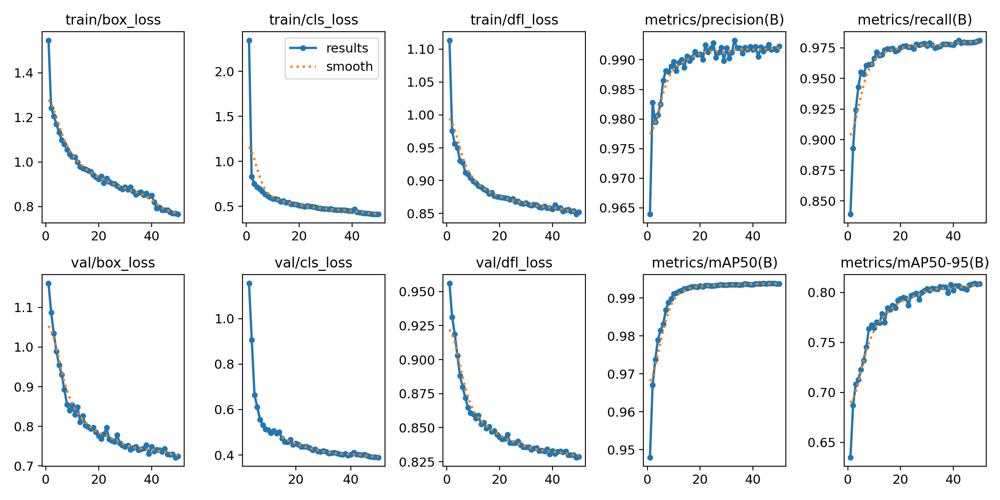

 Model: /content/runs/detect/yolo_freeze5_lr005.v2/weights/best.pt
 Mean Squared Error (MSE): 3.4200
 Exact Match Accuracy (EMA): 39.50%
  Değerlendirilen görüntü sayısı: 200


(39.5, np.float64(3.42), 200)

In [13]:
from IPython.display import Image, display
display(Image(filename="/content/runs/detect/yolo_freeze5_lr005.v2/results.png"))

evaluate_model(
    model_path="/content/runs/detect/yolo_freeze5_lr005.v2/weights/best.pt",
    img_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test"
)

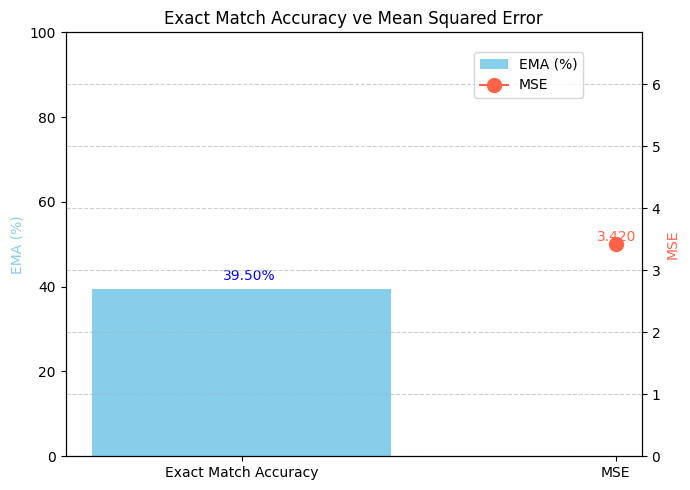

Prediction output directory: runs/detect/predict

 Selected Images:
• 20160331_NTU_00008.jpg
• 20160331_NTU_00017.jpg
• 20160331_NTU_00019.jpg

 Prediction and Count Comparison:

Results saved to runs/detect/predict2


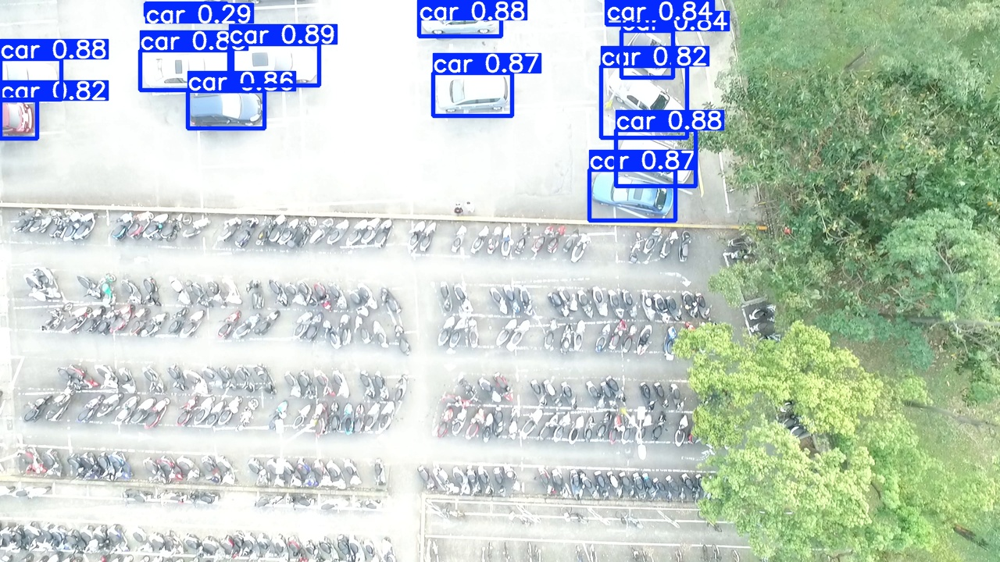

 20160331_NTU_00008.jpg → GT: 12 car(s), Prediction: 12 car(s)

Results saved to runs/detect/predict2


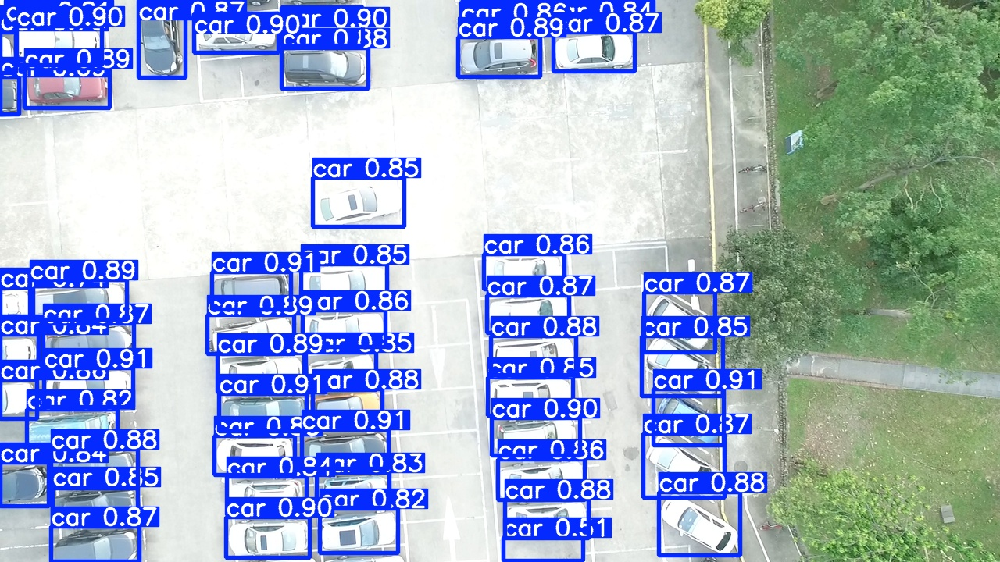

 20160331_NTU_00017.jpg → GT: 49 car(s), Prediction: 53 car(s)

Results saved to runs/detect/predict2


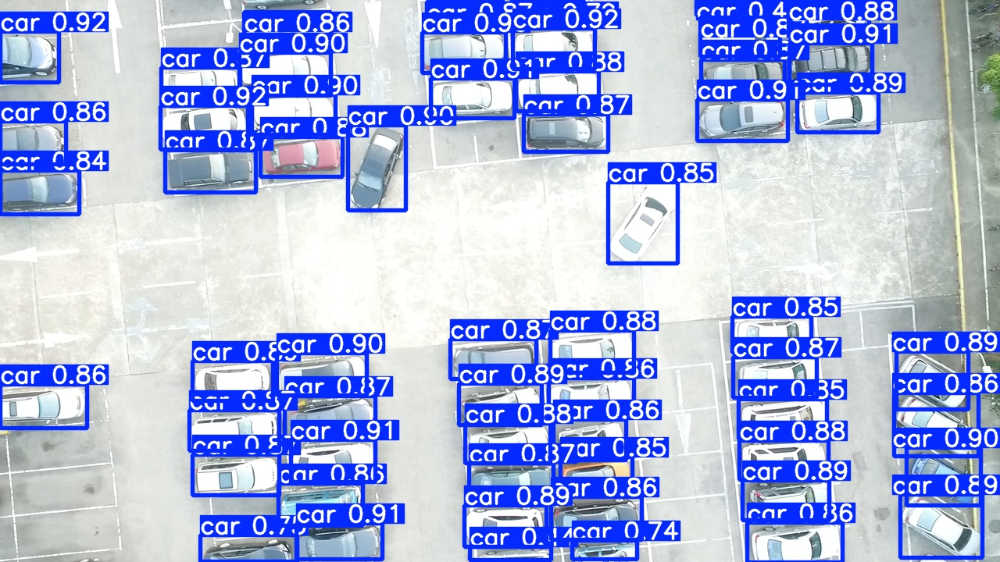

 20160331_NTU_00019.jpg → GT: 57 car(s), Prediction: 57 car(s)



In [14]:
plot_ema_mse(39.50, 3.4200
)


predict_show_compare(
    model_path="/content/runs/detect/yolo_freeze5_lr005.v2/weights/best.pt",
    image_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test",
    predict_dir="runs/detect/predict",
    num_images=3
)

#Model 7: YOLOv8n – Freeze First 10 Layers with Default Optimizer and Learning Rate (Epochs: 80)

Parameters:

Model: yolov8n.pt

Freeze: 10 (entire backbone + SPPF layer)

Optimizer: default (AdamW)

Learning rate: default (0.01)

Epochs: 80

Batch size: 16

Image size: 640x640


In this configuration, a more aggressive freezing strategy was applied by freezing the first ten layers of the model, which includes the entire backbone and the Spatial Pyramid Pooling - Fast (SPPF) layer. Only the detection head and a portion of the neck were left trainable. To compensate for reduced flexibility, the training duration was extended to 80 epochs. The model achieved a Mean Squared Error (MSE) of 2.5950 and an Exact Match Accuracy (EMA) of 45.00% on a 200-image test set. These results are close to the fully trainable baseline and slightly better than the freeze=5 runs that used fewer epochs. This suggests that increasing the training duration helped the limited trainable layers learn more robust features, partially offsetting the lack of full model adaptation. The experiment highlights that deeper freezing may still yield strong performance when paired with longer training schedules, especially in scenarios with limited computational resources or a desire to retain pretrained backbone weights.

In [24]:
from ultralytics import YOLO

model = YOLO("yolov8n.pt")

###freeze 5 layer deafult optimizer and learning rate(0.01) epoch 80
model.train(
    data="/content/drive/MyDrive/cars_dataset/dataset.yaml",
    epochs=80,
    imgsz=640,
    batch=16,
    name="yolo_freeze580",
    device=0,
    freeze=10
)

Ultralytics 8.3.140 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/cars_dataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=80, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=10, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolo_freeze580, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=Tru

train: Scanning /content/drive/MyDrive/cars_dataset/labels/train.cache... 1000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 1.1±1.0 ms, read: 165.1±194.4 MB/s, size: 1312.4 KB)


val: Scanning /content/drive/MyDrive/cars_dataset/labels/val.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolo_freeze580/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolo_freeze580
Starting training for 80 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/80      5.56G      1.476      1.831      1.018        808        640: 100%|██████████| 63/63 [00:12<00:00,  4.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.18it/s]

                   all        200      11906      0.928      0.927       0.96      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/80      6.52G      1.218     0.7787     0.9265        740        640: 100%|██████████| 63/63 [00:11<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.26it/s]

                   all        200      11906      0.956       0.94      0.974      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/80      6.52G      1.144     0.6835     0.9071       1137        640: 100%|██████████| 63/63 [00:10<00:00,  5.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.06it/s]

                   all        200      11906       0.98       0.95       0.98      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/80      6.52G      1.079     0.6373     0.8961       1051        640: 100%|██████████| 63/63 [00:10<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.16it/s]

                   all        200      11906      0.985       0.96      0.986      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/80      6.52G      1.064     0.6191     0.8926        932        640: 100%|██████████| 63/63 [00:10<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.10it/s]

                   all        200      11906      0.981      0.964      0.989      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/80      6.52G      1.028     0.5878     0.8835        643        640: 100%|██████████| 63/63 [00:10<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.22it/s]

                   all        200      11906      0.985      0.966       0.99      0.758



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/80      6.52G      1.009     0.5685     0.8778        660        640: 100%|██████████| 63/63 [00:10<00:00,  5.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.18it/s]

                   all        200      11906      0.987      0.968      0.991      0.759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/80      6.52G     0.9998     0.5552     0.8763       1059        640: 100%|██████████| 63/63 [00:10<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.07it/s]

                   all        200      11906      0.987      0.971      0.992      0.763



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/80      6.52G     0.9878     0.5481     0.8745        657        640: 100%|██████████| 63/63 [00:10<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.07it/s]

                   all        200      11906      0.987      0.972      0.993      0.772



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/80      6.52G      0.975     0.5349     0.8714       1005        640: 100%|██████████| 63/63 [00:10<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.33it/s]

                   all        200      11906      0.989      0.973      0.993      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/80      6.52G     0.9793      0.531     0.8704        868        640: 100%|██████████| 63/63 [00:10<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.47it/s]

                   all        200      11906      0.989      0.971      0.992       0.78



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/80      6.52G     0.9671     0.5273      0.868        600        640: 100%|██████████| 63/63 [00:10<00:00,  5.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.34it/s]

                   all        200      11906      0.991      0.973      0.993      0.785



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/80      6.52G     0.9474      0.509     0.8662        815        640: 100%|██████████| 63/63 [00:10<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.36it/s]

                   all        200      11906      0.989      0.972      0.993      0.778



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/80      7.47G     0.9428     0.5036     0.8649        710        640: 100%|██████████| 63/63 [00:10<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.42it/s]

                   all        200      11906      0.989      0.974      0.993      0.781



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/80      7.03G     0.9356     0.4986      0.861       1045        640: 100%|██████████| 63/63 [00:10<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.55it/s]

                   all        200      11906      0.989      0.974      0.993      0.784



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/80      7.03G     0.9345     0.4955     0.8605       1069        640: 100%|██████████| 63/63 [00:10<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.35it/s]

                   all        200      11906      0.988      0.977      0.993      0.788



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/80      7.03G     0.9332     0.4914     0.8599       1222        640: 100%|██████████| 63/63 [00:10<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.43it/s]

                   all        200      11906      0.991      0.975      0.993      0.796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/80      7.96G     0.9235     0.4868     0.8581        595        640: 100%|██████████| 63/63 [00:10<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.41it/s]

                   all        200      11906      0.991      0.978      0.993      0.786



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/80      4.96G     0.9144     0.4814     0.8575        582        640: 100%|██████████| 63/63 [00:10<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.29it/s]

                   all        200      11906      0.992      0.977      0.994      0.786



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/80      6.66G     0.9168     0.4826     0.8575       1067        640: 100%|██████████| 63/63 [00:10<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.38it/s]

                   all        200      11906      0.989      0.979      0.994      0.786



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/80      6.66G     0.9044     0.4771     0.8564       1002        640: 100%|██████████| 63/63 [00:10<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.19it/s]

                   all        200      11906      0.991      0.977      0.993       0.79



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/80      6.66G      0.913     0.4755      0.857        569        640: 100%|██████████| 63/63 [00:10<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.44it/s]

                   all        200      11906       0.99      0.977      0.993      0.798



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/80      6.66G     0.8976     0.4685     0.8563        798        640: 100%|██████████| 63/63 [00:10<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.73it/s]

                   all        200      11906      0.991      0.977      0.993      0.798



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/80      6.66G     0.9131     0.4738     0.8559        758        640: 100%|██████████| 63/63 [00:10<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.55it/s]

                   all        200      11906      0.991      0.979      0.993      0.796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/80      6.66G      0.903     0.4682     0.8547        586        640: 100%|██████████| 63/63 [00:10<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.58it/s]

                   all        200      11906       0.99       0.98      0.994      0.798



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/80      7.62G     0.8979     0.4642     0.8526        870        640: 100%|██████████| 63/63 [00:10<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.56it/s]

                   all        200      11906      0.991      0.979      0.994      0.799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/80      5.69G     0.8895     0.4569     0.8529        942        640: 100%|██████████| 63/63 [00:10<00:00,  5.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.54it/s]

                   all        200      11906      0.991       0.98      0.994      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/80      5.69G     0.8898     0.4584     0.8501        626        640: 100%|██████████| 63/63 [00:10<00:00,  5.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.52it/s]

                   all        200      11906      0.992      0.981      0.994      0.801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/80      7.38G     0.8757     0.4504     0.8517        893        640: 100%|██████████| 63/63 [00:10<00:00,  5.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.56it/s]

                   all        200      11906      0.991      0.981      0.994      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/80      5.64G     0.8836     0.4544     0.8493       1173        640: 100%|██████████| 63/63 [00:10<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.38it/s]

                   all        200      11906       0.99      0.979      0.994      0.801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/80      5.64G     0.8704     0.4469     0.8496        777        640: 100%|██████████| 63/63 [00:10<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.25it/s]

                   all        200      11906      0.991      0.981      0.994      0.797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/80       6.5G     0.8798     0.4522     0.8501        695        640: 100%|██████████| 63/63 [00:10<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.39it/s]

                   all        200      11906      0.987      0.983      0.994      0.805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/80       6.5G     0.8759     0.4476     0.8498        617        640: 100%|██████████| 63/63 [00:10<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.57it/s]

                   all        200      11906      0.991       0.98      0.994      0.799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/80       6.5G     0.8696     0.4431     0.8475        795        640: 100%|██████████| 63/63 [00:10<00:00,  5.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.61it/s]

                   all        200      11906       0.99      0.981      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/80      7.51G     0.8671     0.4436     0.8483        759        640: 100%|██████████| 63/63 [00:10<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.72it/s]

                   all        200      11906       0.99      0.981      0.994      0.811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/80      4.36G     0.8574     0.4367     0.8454        804        640: 100%|██████████| 63/63 [00:10<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.57it/s]

                   all        200      11906      0.992      0.981      0.994      0.808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/80      6.05G     0.8693     0.4402     0.8456        930        640: 100%|██████████| 63/63 [00:10<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.45it/s]

                   all        200      11906      0.992      0.982      0.994      0.811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/80      6.05G     0.8675     0.4402     0.8465        995        640: 100%|██████████| 63/63 [00:10<00:00,  5.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.51it/s]

                   all        200      11906      0.991      0.983      0.994       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/80      6.05G     0.8588     0.4356     0.8466        993        640: 100%|██████████| 63/63 [00:10<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.36it/s]

                   all        200      11906       0.99      0.982      0.994      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/80      6.05G      0.857     0.4353     0.8456        438        640: 100%|██████████| 63/63 [00:10<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.36it/s]

                   all        200      11906      0.991      0.981      0.994      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/80      6.06G     0.8706     0.4384     0.8453       1110        640: 100%|██████████| 63/63 [00:10<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.54it/s]

                   all        200      11906      0.992      0.982      0.994      0.816



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/80      6.06G     0.8582      0.434     0.8453        805        640: 100%|██████████| 63/63 [00:10<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.27it/s]

                   all        200      11906      0.991      0.983      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/80      6.06G     0.8496     0.4325      0.843       1150        640: 100%|██████████| 63/63 [00:10<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.61it/s]

                   all        200      11906      0.991      0.985      0.994       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/80      6.08G     0.8582     0.4347     0.8447       1110        640: 100%|██████████| 63/63 [00:10<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.60it/s]

                   all        200      11906      0.991      0.983      0.994      0.811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/80      6.08G     0.8535     0.4329     0.8439        770        640: 100%|██████████| 63/63 [00:10<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.63it/s]

                   all        200      11906      0.992      0.983      0.994      0.814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/80      6.08G     0.8526     0.4359     0.8449        904        640: 100%|██████████| 63/63 [00:10<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.68it/s]

                   all        200      11906      0.992      0.983      0.994      0.815



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/80      6.08G     0.8423     0.4297     0.8417        835        640: 100%|██████████| 63/63 [00:10<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.63it/s]

                   all        200      11906       0.99      0.984      0.994      0.815



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/80      6.08G     0.8498     0.4279     0.8436       1068        640: 100%|██████████| 63/63 [00:10<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.75it/s]

                   all        200      11906      0.991      0.985      0.994      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/80      6.08G     0.8438     0.4268     0.8429        999        640: 100%|██████████| 63/63 [00:10<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.57it/s]

                   all        200      11906      0.991      0.983      0.994      0.812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/80      6.08G     0.8338     0.4237     0.8432        786        640: 100%|██████████| 63/63 [00:10<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.20it/s]

                   all        200      11906      0.992      0.984      0.994      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/80      6.08G     0.8328      0.422     0.8429        524        640: 100%|██████████| 63/63 [00:10<00:00,  6.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.25it/s]

                   all        200      11906      0.992      0.984      0.994      0.814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/80      6.08G      0.847     0.4238     0.8423        762        640: 100%|██████████| 63/63 [00:10<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.53it/s]

                   all        200      11906      0.993      0.983      0.994      0.817



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/80      6.08G     0.8403     0.4207     0.8404        799        640: 100%|██████████| 63/63 [00:10<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.63it/s]

                   all        200      11906      0.992      0.983      0.994      0.818



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/80      6.08G     0.8409     0.4229     0.8407        808        640: 100%|██████████| 63/63 [00:10<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.69it/s]

                   all        200      11906       0.99      0.985      0.994      0.817



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/80      6.08G     0.8377     0.4218     0.8437        828        640: 100%|██████████| 63/63 [00:10<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.62it/s]

                   all        200      11906      0.992      0.984      0.994      0.815



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/80      6.08G     0.8458     0.4233     0.8425       1145        640: 100%|██████████| 63/63 [00:10<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.74it/s]

                   all        200      11906      0.991      0.984      0.994      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/80      6.08G     0.8261     0.4161      0.841        456        640: 100%|██████████| 63/63 [00:10<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.64it/s]

                   all        200      11906      0.993      0.982      0.994       0.82



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/80      6.99G     0.8375     0.4189     0.8412        493        640: 100%|██████████| 63/63 [00:10<00:00,  5.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.60it/s]

                   all        200      11906      0.991      0.984      0.994      0.815



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/80      6.99G      0.828     0.4142     0.8397       1005        640: 100%|██████████| 63/63 [00:10<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.39it/s]

                   all        200      11906      0.991      0.985      0.994       0.82



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/80      6.99G     0.8296     0.4145     0.8395        682        640: 100%|██████████| 63/63 [00:10<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.48it/s]

                   all        200      11906      0.992      0.984      0.994      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/80      6.99G     0.8232     0.4122     0.8392        701        640: 100%|██████████| 63/63 [00:10<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.39it/s]

                   all        200      11906      0.992      0.984      0.994       0.82



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/80      6.99G     0.8291     0.4145     0.8389        747        640: 100%|██████████| 63/63 [00:10<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.72it/s]

                   all        200      11906      0.992      0.984      0.994      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/80      6.99G     0.8199     0.4104     0.8385       1040        640: 100%|██████████| 63/63 [00:10<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.58it/s]

                   all        200      11906      0.991      0.986      0.994       0.82



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/80      6.99G     0.8223     0.4132     0.8377        974        640: 100%|██████████| 63/63 [00:10<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.79it/s]

                   all        200      11906       0.99      0.986      0.994      0.823



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/80      6.99G     0.8329     0.4166     0.8423        870        640: 100%|██████████| 63/63 [00:10<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.55it/s]

                   all        200      11906      0.991      0.985      0.994      0.817



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/80      6.99G     0.8169     0.4079     0.8377        700        640: 100%|██████████| 63/63 [00:10<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.61it/s]

                   all        200      11906      0.992      0.985      0.994      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/80      6.99G     0.8189     0.4083     0.8369        727        640: 100%|██████████| 63/63 [00:10<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.61it/s]

                   all        200      11906      0.991      0.986      0.994      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/80      6.99G     0.8197     0.4074     0.8362        920        640: 100%|██████████| 63/63 [00:10<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.47it/s]

                   all        200      11906      0.992      0.984      0.994      0.823



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/80      6.99G     0.8092     0.4053     0.8388        667        640: 100%|██████████| 63/63 [00:10<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.51it/s]

                   all        200      11906      0.991      0.986      0.994      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/80      6.99G     0.8164     0.4072     0.8393        683        640: 100%|██████████| 63/63 [00:10<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.42it/s]

                   all        200      11906      0.992      0.985      0.994      0.823


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      71/80      6.99G      0.769     0.3894     0.8318        466        640: 100%|██████████| 63/63 [00:11<00:00,  5.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.28it/s]

                   all        200      11906      0.992      0.985      0.994      0.818



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      72/80      6.99G     0.7607     0.3815     0.8324        367        640: 100%|██████████| 63/63 [00:09<00:00,  6.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.98it/s]

                   all        200      11906      0.992      0.985      0.994      0.822



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      73/80      6.99G     0.7592     0.3806     0.8323        520        640: 100%|██████████| 63/63 [00:09<00:00,  6.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.59it/s]

                   all        200      11906      0.991      0.985      0.994      0.823



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      74/80      6.99G     0.7527     0.3761     0.8321        709        640: 100%|██████████| 63/63 [00:09<00:00,  6.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.71it/s]

                   all        200      11906      0.991      0.985      0.994      0.825



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      75/80      6.99G     0.7571     0.3787     0.8306        379        640: 100%|██████████| 63/63 [00:09<00:00,  6.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.75it/s]

                   all        200      11906      0.991      0.985      0.994      0.822



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      76/80      6.99G       0.75     0.3738     0.8299        631        640: 100%|██████████| 63/63 [00:09<00:00,  6.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.48it/s]

                   all        200      11906      0.991      0.985      0.994      0.826



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      77/80      6.99G     0.7445     0.3705     0.8294        631        640: 100%|██████████| 63/63 [00:09<00:00,  6.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.81it/s]

                   all        200      11906       0.99      0.987      0.994      0.827



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      78/80      6.99G     0.7498     0.3714     0.8291        348        640: 100%|██████████| 63/63 [00:09<00:00,  6.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.86it/s]

                   all        200      11906       0.99      0.986      0.994      0.826



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      79/80      6.99G     0.7414     0.3678     0.8292        428        640: 100%|██████████| 63/63 [00:09<00:00,  6.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.32it/s]

                   all        200      11906      0.993      0.984      0.994      0.828



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      80/80      6.99G     0.7392     0.3657      0.827        716        640: 100%|██████████| 63/63 [00:09<00:00,  6.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.77it/s]

                   all        200      11906      0.992      0.985      0.994      0.828



80 epochs completed in 0.275 hours.
Optimizer stripped from runs/detect/yolo_freeze580/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/yolo_freeze580/weights/best.pt, 6.2MB

Validating runs/detect/yolo_freeze580/weights/best.pt...
Ultralytics 8.3.140 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.21it/s]


                   all        200      11906      0.992      0.985      0.994      0.828
Speed: 0.1ms preprocess, 1.4ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/yolo_freeze580


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78b792bf22d0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

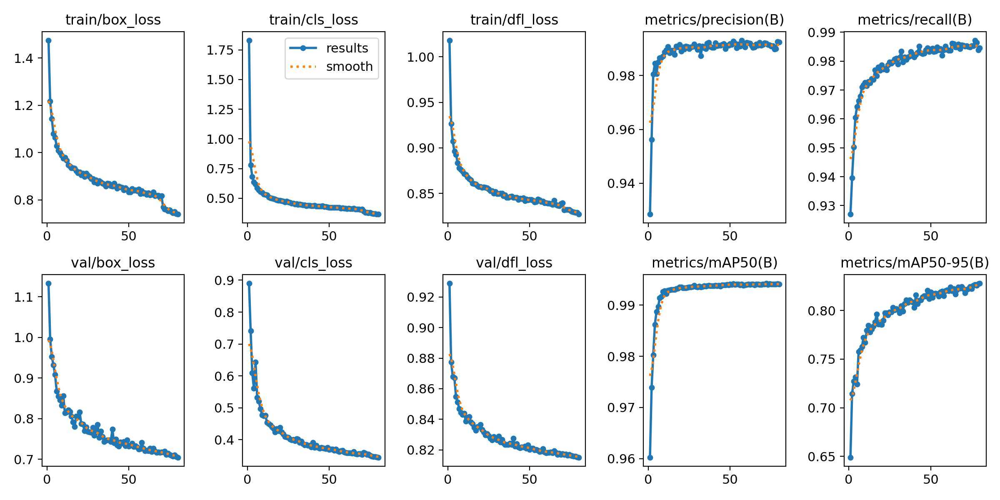

 Model: /content/runs/detect/yolo_freeze580/weights/best.pt
 Mean Squared Error (MSE): 2.5950
 Exact Match Accuracy (EMA): 45.00%
  Değerlendirilen görüntü sayısı: 200


(45.0, np.float64(2.595), 200)

In [25]:
display(Image(filename="/content/runs/detect/yolo_freeze580/results.png"))

evaluate_model(
    model_path="/content/runs/detect/yolo_freeze580/weights/best.pt",
    img_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test"
)

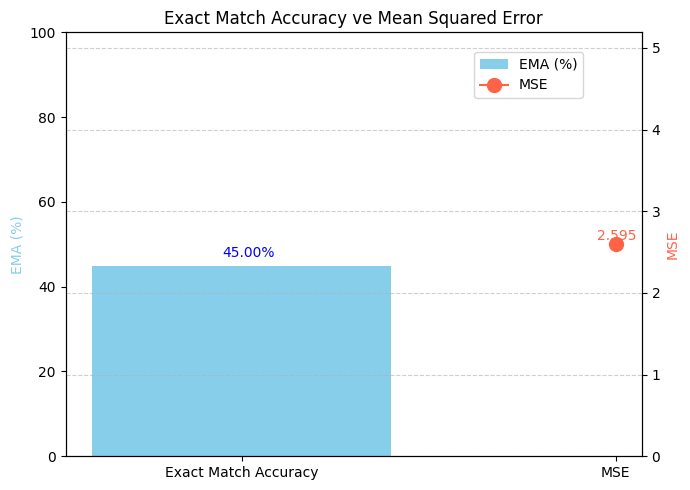

Prediction output directory: runs/detect/predict

 Selected Images:
• 20160331_NTU_00008.jpg
• 20160331_NTU_00017.jpg
• 20160331_NTU_00019.jpg

 Prediction and Count Comparison:

Results saved to runs/detect/predict6


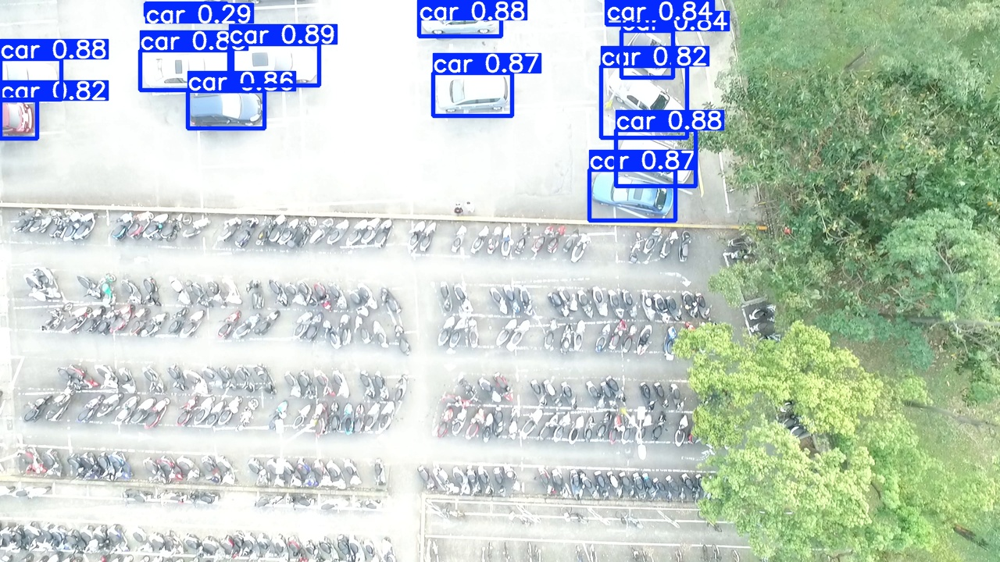

 20160331_NTU_00008.jpg → GT: 12 car(s), Prediction: 12 car(s)

Results saved to runs/detect/predict6


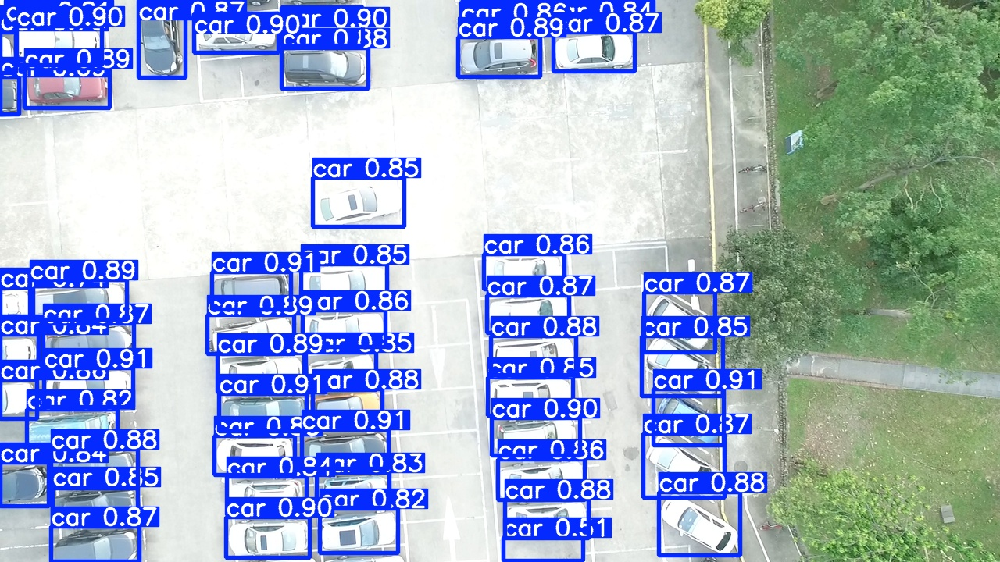

 20160331_NTU_00017.jpg → GT: 49 car(s), Prediction: 52 car(s)

Results saved to runs/detect/predict6


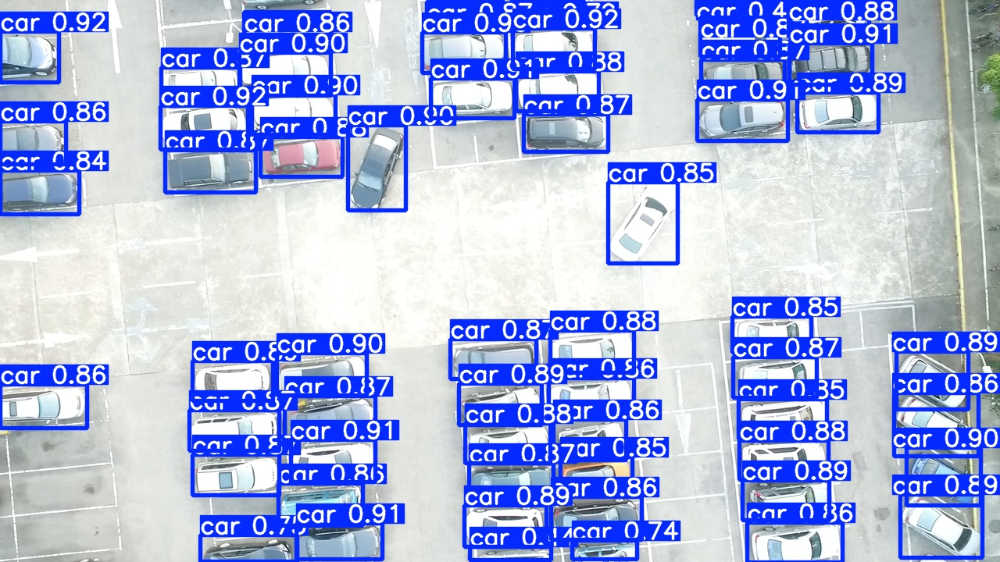

 20160331_NTU_00019.jpg → GT: 57 car(s), Prediction: 58 car(s)



In [26]:
plot_ema_mse( 45.00, 2.5950
)


predict_show_compare(
    model_path="/content/runs/detect/yolo_freeze580/weights/best.pt",
    image_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test",
    predict_dir="runs/detect/predict",
    num_images=3
)

#Model 8: YOLOv8n – Freeze First 10 Layers with Default Optimizer and Learning Rate (Epochs: 50)

Parameters:

Model: yolov8n.pt

Freeze: 10 (entire backbone + SPPF layer)

Optimizer: default (AdamW)

Learning rate: default (0.01)

Epochs: 50

Batch size: 16

Image size: 640x640

This experiment froze the first ten layers of the YOLOv8n model, which includes the full backbone and the SPPF (Spatial Pyramid Pooling - Fast) layer, leaving only the detection head and parts of the neck trainable. The model was trained for 50 epochs using the default optimizer and learning rate. It achieved a Mean Squared Error (MSE) of 3.4250 and an Exact Match Accuracy (EMA) of 47.50% on the 200-image test set. While the EMA is the highest among all experiments, the MSE is noticeably higher than configurations with fewer frozen layers. This result suggests that although the model is relatively good at predicting the correct number of objects in some images (reflected in EMA), its overall bounding box localization accuracy is less precise. The trade-off between freezing for efficiency and allowing enough trainable parameters for fine-tuning is clearly illustrated here. It also confirms that while freezing the entire backbone can still yield reasonable results, it may require either more training epochs (as seen in the freeze=10 at 80 epochs) or additional fine-tuning strategies to reduce localization errors.

In [15]:
from ultralytics import YOLO

model = YOLO("yolov8n.pt")

###freeze 10 layer deafult optimizer and learning rate(0.01)
model.train(
    data="/content/drive/MyDrive/cars_dataset/dataset.yaml",
    epochs=50,
    imgsz=640,
    batch=16,
    name="yolo_freeze10",
    device=0,
    freeze=10
)

Ultralytics 8.3.140 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/cars_dataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=10, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolo_freeze10, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True

train: Scanning /content/drive/MyDrive/cars_dataset/labels/train.cache... 1000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


WARNING ⚠️ val: Slow image access detected (ping: 75.4±166.6 ms, read: 113.0±175.9 MB/s, size: 1312.4 KB). Use local storage instead of remote/mounted storage for better performance. See https://docs.ultralytics.com/guides/model-training-tips/


val: Scanning /content/drive/MyDrive/cars_dataset/labels/val.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolo_freeze10/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolo_freeze10
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      5.55G      1.476      1.831      1.018        808        640: 100%|██████████| 63/63 [00:12<00:00,  4.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.98it/s]

                   all        200      11906      0.928      0.927       0.96      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      6.49G      1.218     0.7792     0.9265        740        640: 100%|██████████| 63/63 [00:10<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.04it/s]

                   all        200      11906      0.957      0.937      0.974      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      6.49G      1.142     0.6821     0.9067       1137        640: 100%|██████████| 63/63 [00:10<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.10it/s]

                   all        200      11906      0.979      0.951       0.98      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      6.49G      1.082     0.6383     0.8964       1051        640: 100%|██████████| 63/63 [00:10<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.21it/s]

                   all        200      11906      0.985       0.96      0.986      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      6.49G      1.073     0.6236     0.8945        932        640: 100%|██████████| 63/63 [00:10<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.14it/s]

                   all        200      11906      0.983      0.962      0.988      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      6.49G      1.028     0.5896     0.8837        643        640: 100%|██████████| 63/63 [00:10<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.38it/s]

                   all        200      11906      0.985      0.964       0.99      0.753



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      6.49G      1.005     0.5665     0.8772        660        640: 100%|██████████| 63/63 [00:10<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.31it/s]

                   all        200      11906      0.987      0.966      0.992      0.759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      6.51G      1.002     0.5583     0.8773       1059        640: 100%|██████████| 63/63 [00:10<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.30it/s]

                   all        200      11906      0.989      0.967      0.991      0.764



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      6.51G     0.9797     0.5489     0.8735        657        640: 100%|██████████| 63/63 [00:10<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.31it/s]

                   all        200      11906      0.989      0.972      0.993       0.77



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      6.51G      0.979     0.5383     0.8725       1005        640: 100%|██████████| 63/63 [00:10<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.10it/s]

                   all        200      11906      0.987      0.974      0.993      0.765



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      6.51G     0.9901     0.5329     0.8717        868        640: 100%|██████████| 63/63 [00:10<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.24it/s]

                   all        200      11906      0.986      0.973      0.992       0.77



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      6.51G     0.9724     0.5305     0.8696        600        640: 100%|██████████| 63/63 [00:10<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.25it/s]

                   all        200      11906      0.989      0.973      0.993      0.782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      6.52G     0.9441     0.5092     0.8657        815        640: 100%|██████████| 63/63 [00:10<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.19it/s]

                   all        200      11906      0.989      0.975      0.993      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      7.48G     0.9394     0.5035     0.8643        710        640: 100%|██████████| 63/63 [00:10<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.38it/s]

                   all        200      11906      0.987      0.975      0.993      0.776



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      7.03G     0.9347      0.498     0.8608       1045        640: 100%|██████████| 63/63 [00:10<00:00,  5.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.51it/s]

                   all        200      11906      0.989      0.974      0.993      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      7.03G     0.9343     0.4957     0.8604       1069        640: 100%|██████████| 63/63 [00:10<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.35it/s]

                   all        200      11906      0.989      0.977      0.993       0.79



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      7.03G     0.9326     0.4964     0.8597       1222        640: 100%|██████████| 63/63 [00:10<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.47it/s]

                   all        200      11906      0.991      0.975      0.993      0.793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      7.96G     0.9179     0.4869     0.8574        595        640: 100%|██████████| 63/63 [00:10<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.32it/s]

                   all        200      11906      0.989      0.977      0.993      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      4.93G     0.9205     0.4844     0.8581        582        640: 100%|██████████| 63/63 [00:10<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.40it/s]

                   all        200      11906      0.991      0.976      0.993      0.781



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      6.63G     0.9096     0.4738     0.8561       1067        640: 100%|██████████| 63/63 [00:10<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.30it/s]

                   all        200      11906      0.991      0.977      0.993      0.791



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      6.64G     0.9045     0.4721     0.8564       1002        640: 100%|██████████| 63/63 [00:10<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.14it/s]

                   all        200      11906      0.992      0.976      0.993       0.79



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      6.64G     0.9114     0.4776     0.8562        569        640: 100%|██████████| 63/63 [00:10<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.34it/s]

                   all        200      11906      0.989      0.977      0.993       0.79



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      6.65G     0.8922     0.4702     0.8557        798        640: 100%|██████████| 63/63 [00:10<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.42it/s]

                   all        200      11906      0.989      0.978      0.994      0.799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      6.65G     0.9048     0.4734     0.8544        758        640: 100%|██████████| 63/63 [00:10<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.52it/s]

                   all        200      11906      0.991      0.978      0.994        0.8



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      6.65G     0.8939     0.4648     0.8535        586        640: 100%|██████████| 63/63 [00:10<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.40it/s]

                   all        200      11906      0.989      0.982      0.994      0.797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      7.59G     0.8936     0.4626      0.852        870        640: 100%|██████████| 63/63 [00:10<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.54it/s]

                   all        200      11906       0.99      0.979      0.994      0.801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      5.65G     0.8839     0.4549     0.8521        942        640: 100%|██████████| 63/63 [00:10<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.35it/s]

                   all        200      11906      0.992       0.98      0.994      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      5.65G     0.8826     0.4549     0.8491        626        640: 100%|██████████| 63/63 [00:10<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.38it/s]

                   all        200      11906      0.992       0.98      0.994      0.798



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      7.34G     0.8743     0.4521     0.8513        893        640: 100%|██████████| 63/63 [00:10<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.50it/s]

                   all        200      11906      0.993       0.98      0.994        0.8



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      7.34G     0.8789      0.453     0.8483       1173        640: 100%|██████████| 63/63 [00:10<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.44it/s]

                   all        200      11906      0.992      0.979      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      7.35G     0.8618     0.4448     0.8481        777        640: 100%|██████████| 63/63 [00:10<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]

                   all        200      11906      0.991       0.98      0.994      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      7.35G     0.8724     0.4491     0.8484        695        640: 100%|██████████| 63/63 [00:10<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.36it/s]

                   all        200      11906      0.991       0.98      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      7.35G     0.8639     0.4459     0.8476        617        640: 100%|██████████| 63/63 [00:10<00:00,  6.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.35it/s]

                   all        200      11906       0.99      0.981      0.994      0.805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      7.36G     0.8665     0.4435     0.8465        795        640: 100%|██████████| 63/63 [00:10<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.56it/s]

                   all        200      11906      0.992      0.981      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      8.37G     0.8625     0.4405     0.8473        759        640: 100%|██████████| 63/63 [00:10<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.59it/s]

                   all        200      11906      0.992       0.98      0.994      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      4.33G     0.8536     0.4348     0.8445        804        640: 100%|██████████| 63/63 [00:10<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.64it/s]

                   all        200      11906      0.993      0.981      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      6.02G     0.8654     0.4406     0.8451        930        640: 100%|██████████| 63/63 [00:10<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.46it/s]

                   all        200      11906      0.992      0.982      0.994      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      6.02G     0.8578     0.4365     0.8448        995        640: 100%|██████████| 63/63 [00:10<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.52it/s]

                   all        200      11906      0.991      0.983      0.994      0.811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      6.02G     0.8488     0.4316     0.8451        993        640: 100%|██████████| 63/63 [00:10<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.52it/s]

                   all        200      11906      0.992      0.981      0.994      0.814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      6.03G     0.8488     0.4324     0.8445        438        640: 100%|██████████| 63/63 [00:10<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.39it/s]

                   all        200      11906       0.99      0.982      0.994      0.808


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      6.03G        0.8      0.417     0.8403        669        640: 100%|██████████| 63/63 [00:12<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.13it/s]

                   all        200      11906      0.992      0.981      0.994      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      6.04G     0.7978     0.4112     0.8391        629        640: 100%|██████████| 63/63 [00:09<00:00,  6.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.24it/s]

                   all        200      11906      0.993      0.982      0.994       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.04G     0.7942     0.4038     0.8374        546        640: 100%|██████████| 63/63 [00:09<00:00,  6.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.10it/s]

                   all        200      11906      0.992      0.982      0.994      0.814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      6.04G       0.78     0.4001     0.8354        408        640: 100%|██████████| 63/63 [00:09<00:00,  6.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.77it/s]

                   all        200      11906      0.993      0.983      0.994      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      6.04G     0.7839     0.3995     0.8378        526        640: 100%|██████████| 63/63 [00:09<00:00,  6.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.71it/s]

                   all        200      11906      0.992      0.983      0.994      0.814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.04G     0.7813      0.398     0.8353        441        640: 100%|██████████| 63/63 [00:09<00:00,  6.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.48it/s]

                   all        200      11906      0.991      0.984      0.994      0.811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.04G     0.7675     0.3909     0.8341        419        640: 100%|██████████| 63/63 [00:09<00:00,  6.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.64it/s]

                   all        200      11906      0.991      0.983      0.994      0.814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      6.05G     0.7708     0.3912     0.8353        754        640: 100%|██████████| 63/63 [00:09<00:00,  6.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.63it/s]

                   all        200      11906      0.992      0.983      0.994      0.816



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      6.05G     0.7624     0.3873     0.8328        582        640: 100%|██████████| 63/63 [00:09<00:00,  6.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.06it/s]

                   all        200      11906      0.992      0.983      0.994      0.818



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.05G     0.7635     0.3866     0.8344        635        640: 100%|██████████| 63/63 [00:09<00:00,  6.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.86it/s]

                   all        200      11906      0.993      0.983      0.994      0.819



50 epochs completed in 0.173 hours.
Optimizer stripped from runs/detect/yolo_freeze10/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/yolo_freeze10/weights/best.pt, 6.2MB

Validating runs/detect/yolo_freeze10/weights/best.pt...
Ultralytics 8.3.140 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.14it/s]


                   all        200      11906      0.993      0.983      0.994      0.818
Speed: 0.1ms preprocess, 1.4ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to runs/detect/yolo_freeze10


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78b792cba2d0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

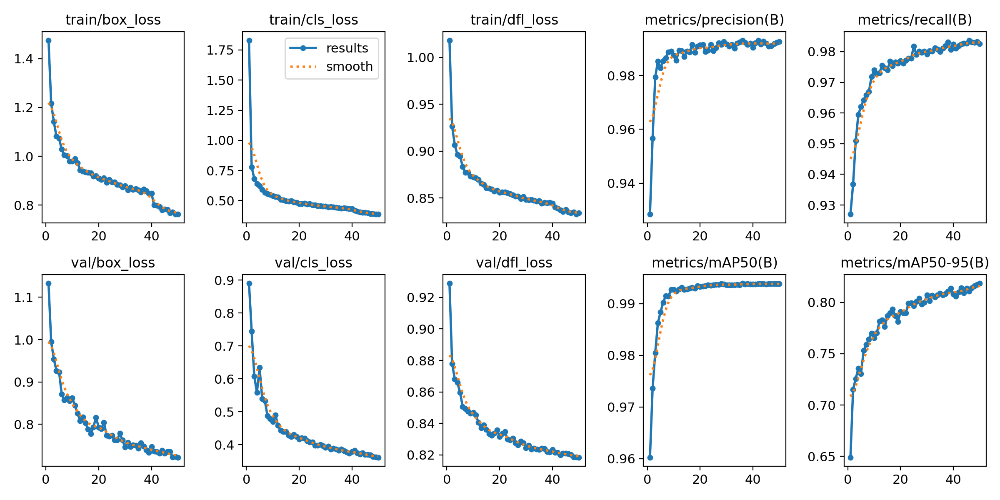

 Model: /content/runs/detect/yolo_freeze10/weights/best.pt
 Mean Squared Error (MSE): 3.4250
 Exact Match Accuracy (EMA): 47.50%
  Değerlendirilen görüntü sayısı: 200


(47.5, np.float64(3.425), 200)

In [16]:
display(Image(filename="/content/runs/detect/yolo_freeze10/results.png"))

evaluate_model(
    model_path="/content/runs/detect/yolo_freeze10/weights/best.pt",
    img_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test"
)

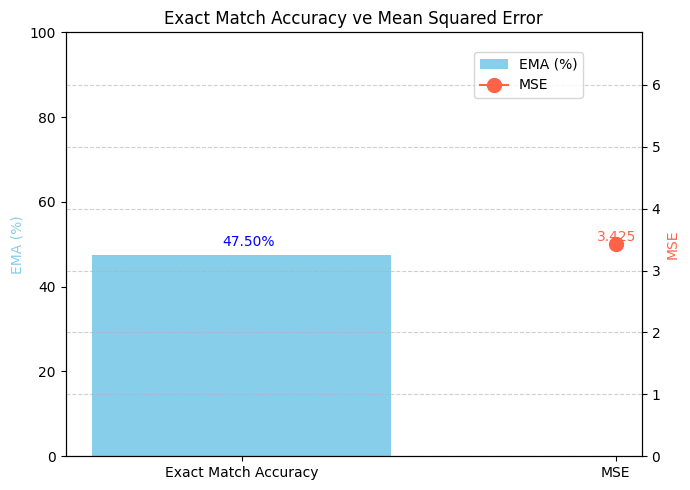

Prediction output directory: runs/detect/predict4

 Selected Images:
• 20160331_NTU_00008.jpg
• 20160331_NTU_00017.jpg
• 20160331_NTU_00019.jpg

 Prediction and Count Comparison:

Results saved to runs/detect/predict4


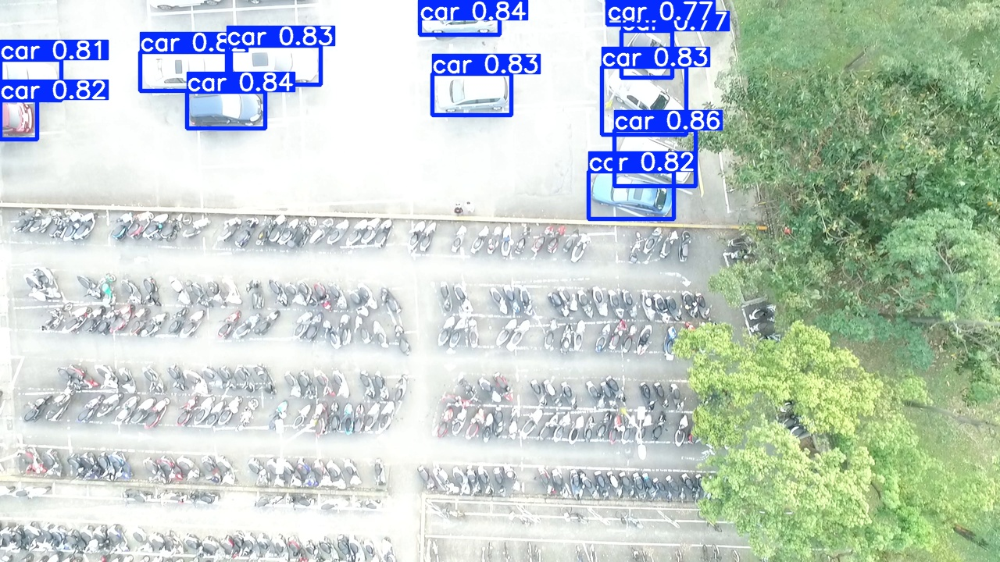

 20160331_NTU_00008.jpg → GT: 12 car(s), Prediction: 12 car(s)

Results saved to runs/detect/predict4


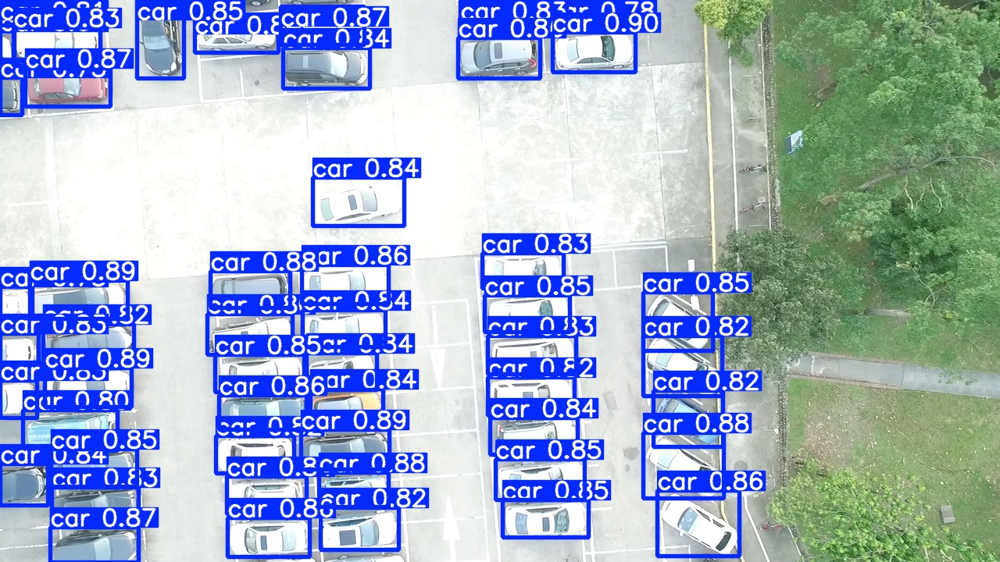

 20160331_NTU_00017.jpg → GT: 49 car(s), Prediction: 51 car(s)

Results saved to runs/detect/predict4


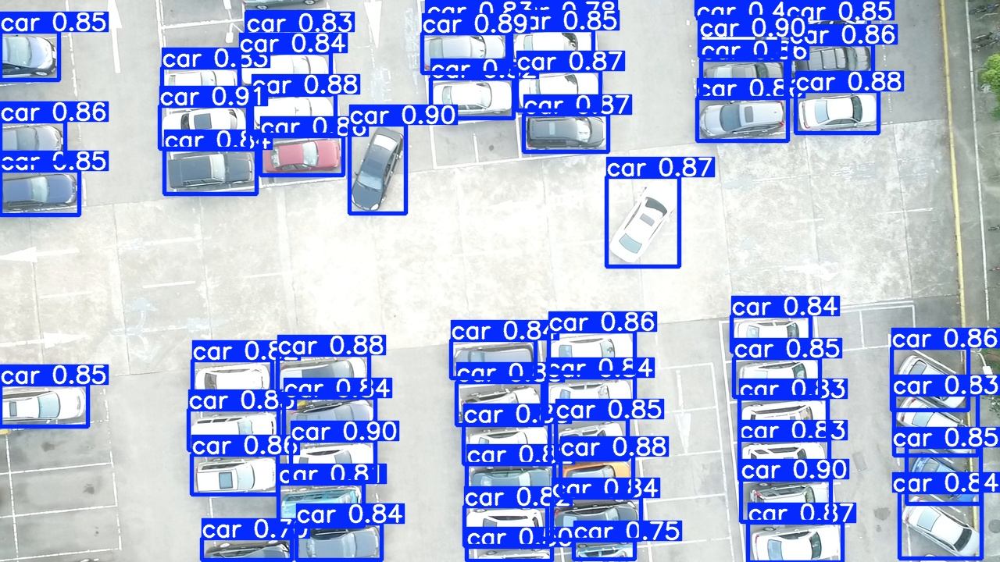

 20160331_NTU_00019.jpg → GT: 57 car(s), Prediction: 58 car(s)



In [18]:
plot_ema_mse(47.50, 3.4250
)


predict_show_compare(
    model_path="/content/runs/detect/yolo_freeze10/weights/best.pt",
    image_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test",
    predict_dir="runs/detect/predict4",
    num_images=3
)

#Model 9: YOLOv8n – Freeze First 21 Layers (All Except Detection Head), Default Optimizer and Learning Rate

Parameters:

Model: yolov8n.pt

Freeze: 21 (entire model except detection head)

Optimizer: default (AdamW)

Learning rate: default (0.01)

Epochs: 50

Batch size: 16

Image size: 640x640

:
In this experiment, all layers of the YOLOv8n model except for the detection head were frozen using freeze=21, leaving only the final prediction layers trainable. The goal was to evaluate how well the detection head alone could adapt to the car counting task without modifying any of the pretrained feature extractors. After 50 epochs, the model performed poorly, with a Mean Squared Error (MSE) of 14.6300 and an Exact Match Accuracy (EMA) of 20.00% on the 200-image test set. These results indicate a significant drop in both localization and counting accuracy. The lack of trainable capacity in the backbone and neck prevented the model from adjusting to the specific characteristics of the dataset, especially for varied object appearances and densities. This experiment confirms that freezing the entire feature extraction pipeline leaves the model too rigid to adapt effectively and that at least part of the backbone and neck must remain trainable to achieve acceptable performance in domain-specific tasks such as car counting.



In [20]:
from ultralytics import YOLO

model = YOLO("yolov8n.pt")

###freeze 21 layer deafult optimizer and learning rate(0.01)
model.train(
    data="/content/drive/MyDrive/cars_dataset/dataset.yaml",
    epochs=50,
    imgsz=640,
    batch=16,
    name="yolo_freeze21",
    device=0,
    freeze=21
)

Ultralytics 8.3.140 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/cars_dataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=21, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolo_freeze21, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True

train: Scanning /content/drive/MyDrive/cars_dataset/labels/train.cache... 1000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.5±0.5 ms, read: 222.8±111.9 MB/s, size: 1312.4 KB)


val: Scanning /content/drive/MyDrive/cars_dataset/labels/val.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolo_freeze21/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolo_freeze21
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50       5.2G      1.586      2.118      1.091        808        640: 100%|██████████| 63/63 [00:11<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.59it/s]

                   all        200      11906      0.809      0.836       0.88      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      6.14G      1.408      1.027      1.018        740        640: 100%|██████████| 63/63 [00:10<00:00,  6.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.28it/s]

                   all        200      11906      0.858      0.875       0.92      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      6.14G      1.339     0.8937     0.9929       1137        640: 100%|██████████| 63/63 [00:09<00:00,  6.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.68it/s]

                   all        200      11906      0.908      0.888      0.946      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      6.14G      1.275     0.8194     0.9805       1051        640: 100%|██████████| 63/63 [00:09<00:00,  6.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.62it/s]

                   all        200      11906      0.938      0.898      0.956      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      6.14G      1.279     0.8023     0.9804        932        640: 100%|██████████| 63/63 [00:09<00:00,  6.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.59it/s]

                   all        200      11906      0.953      0.911      0.962      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      6.14G      1.247     0.7751     0.9718        643        640: 100%|██████████| 63/63 [00:09<00:00,  6.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.58it/s]

                   all        200      11906      0.949       0.92      0.965      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      6.14G      1.232     0.7575     0.9637        660        640: 100%|██████████| 63/63 [00:09<00:00,  6.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.75it/s]

                   all        200      11906      0.959       0.92      0.968      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      6.14G       1.22     0.7478     0.9639       1059        640: 100%|██████████| 63/63 [00:09<00:00,  6.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.23it/s]

                   all        200      11906      0.955      0.925      0.969      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      6.14G       1.21     0.7379     0.9621        657        640: 100%|██████████| 63/63 [00:09<00:00,  6.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.80it/s]

                   all        200      11906      0.961      0.919      0.969      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      6.14G      1.208     0.7256     0.9575       1005        640: 100%|██████████| 63/63 [00:09<00:00,  6.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]

                   all        200      11906      0.965       0.93      0.973      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      6.14G      1.205     0.7212     0.9556        868        640: 100%|██████████| 63/63 [00:09<00:00,  6.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.87it/s]

                   all        200      11906      0.962      0.933      0.973      0.689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      6.14G        1.2     0.7177     0.9531        600        640: 100%|██████████| 63/63 [00:09<00:00,  6.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.71it/s]

                   all        200      11906      0.965      0.927      0.973       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      6.14G      1.177     0.7035     0.9515        815        640: 100%|██████████| 63/63 [00:09<00:00,  6.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.58it/s]

                   all        200      11906       0.96      0.929      0.973      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50       7.1G      1.173     0.6983     0.9491        710        640: 100%|██████████| 63/63 [00:09<00:00,  6.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.77it/s]

                   all        200      11906      0.963      0.931      0.975      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      7.11G      1.175     0.6906     0.9454       1045        640: 100%|██████████| 63/63 [00:09<00:00,  6.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.83it/s]

                   all        200      11906      0.961      0.926      0.972      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      7.11G      1.173     0.6895     0.9436       1069        640: 100%|██████████| 63/63 [00:09<00:00,  6.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.79it/s]

                   all        200      11906      0.965      0.936      0.975      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      7.11G      1.182     0.6916     0.9432       1222        640: 100%|██████████| 63/63 [00:09<00:00,  6.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.94it/s]

                   all        200      11906      0.959      0.938      0.974      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      7.11G      1.171     0.6887     0.9429        595        640: 100%|██████████| 63/63 [00:09<00:00,  6.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.91it/s]

                   all        200      11906      0.963      0.933      0.975      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      7.11G       1.16     0.6748     0.9404        582        640: 100%|██████████| 63/63 [00:10<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.07it/s]

                   all        200      11906      0.967      0.936      0.976      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      7.11G      1.159     0.6743     0.9406       1067        640: 100%|██████████| 63/63 [00:09<00:00,  6.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.92it/s]

                   all        200      11906      0.963      0.931      0.974        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      7.11G      1.155      0.671     0.9419       1002        640: 100%|██████████| 63/63 [00:09<00:00,  6.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.91it/s]

                   all        200      11906      0.969      0.935      0.976       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      7.11G      1.157     0.6724     0.9413        569        640: 100%|██████████| 63/63 [00:09<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.00it/s]

                   all        200      11906      0.968       0.93      0.975      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      7.11G      1.146     0.6716     0.9405        798        640: 100%|██████████| 63/63 [00:09<00:00,  6.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.96it/s]

                   all        200      11906      0.965      0.938      0.976      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      7.11G      1.161     0.6716     0.9396        758        640: 100%|██████████| 63/63 [00:09<00:00,  6.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.04it/s]

                   all        200      11906      0.971       0.94      0.978      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      7.11G      1.148     0.6614     0.9372        586        640: 100%|██████████| 63/63 [00:09<00:00,  6.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.94it/s]

                   all        200      11906      0.968      0.941      0.978      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      7.11G      1.151     0.6621     0.9382        870        640: 100%|██████████| 63/63 [00:09<00:00,  6.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.90it/s]

                   all        200      11906      0.969      0.938      0.978      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      7.11G       1.14     0.6588     0.9373        942        640: 100%|██████████| 63/63 [00:09<00:00,  6.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.88it/s]

                   all        200      11906      0.968      0.937      0.978      0.712



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      7.11G      1.139     0.6535     0.9312        626        640: 100%|██████████| 63/63 [00:09<00:00,  6.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.52it/s]

                   all        200      11906      0.967      0.943      0.978      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      7.11G      1.134     0.6531     0.9384        893        640: 100%|██████████| 63/63 [00:09<00:00,  6.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.58it/s]

                   all        200      11906       0.97      0.945      0.979      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      7.12G      1.142      0.651     0.9322       1173        640: 100%|██████████| 63/63 [00:09<00:00,  6.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.09it/s]

                   all        200      11906      0.967      0.936      0.977      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      7.12G       1.12     0.6448     0.9335        777        640: 100%|██████████| 63/63 [00:09<00:00,  6.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.93it/s]

                   all        200      11906      0.969      0.941      0.979      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      7.13G      1.133       0.65     0.9333        695        640: 100%|██████████| 63/63 [00:09<00:00,  6.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.65it/s]

                   all        200      11906       0.97      0.943      0.979      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      7.13G      1.128     0.6458     0.9325        617        640: 100%|██████████| 63/63 [00:09<00:00,  6.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.08it/s]

                   all        200      11906      0.969      0.946      0.979      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      7.13G      1.127     0.6426     0.9305        795        640: 100%|██████████| 63/63 [00:09<00:00,  6.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.93it/s]

                   all        200      11906      0.966      0.944      0.979      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      8.14G      1.127     0.6453     0.9326        759        640: 100%|██████████| 63/63 [00:09<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.82it/s]

                   all        200      11906      0.969      0.945      0.979      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      4.03G       1.12     0.6402     0.9298        804        640: 100%|██████████| 63/63 [00:09<00:00,  6.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.05it/s]

                   all        200      11906      0.969      0.944      0.981      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      5.72G      1.132     0.6407     0.9287        930        640: 100%|██████████| 63/63 [00:09<00:00,  6.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.23it/s]

                   all        200      11906      0.973      0.945       0.98      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      5.72G      1.128     0.6394      0.929        995        640: 100%|██████████| 63/63 [00:10<00:00,  6.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.09it/s]

                   all        200      11906      0.971      0.943      0.981      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      5.72G      1.119      0.638     0.9314        993        640: 100%|██████████| 63/63 [00:09<00:00,  6.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.45it/s]

                   all        200      11906      0.971      0.946       0.98      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      5.72G      1.117     0.6364      0.929        438        640: 100%|██████████| 63/63 [00:10<00:00,  6.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.43it/s]

                   all        200      11906      0.971      0.944      0.981      0.721


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      5.72G      1.041     0.6174      0.927        669        640: 100%|██████████| 63/63 [00:11<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.22it/s]

                   all        200      11906      0.971      0.945      0.981      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      5.73G      1.043     0.6101     0.9263        629        640: 100%|██████████| 63/63 [00:09<00:00,  6.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.30it/s]

                   all        200      11906      0.971      0.943      0.981      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      5.74G      1.039     0.6031      0.924        546        640: 100%|██████████| 63/63 [00:08<00:00,  7.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.14it/s]

                   all        200      11906      0.973      0.943      0.982      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      5.74G      1.028     0.5982     0.9214        408        640: 100%|██████████| 63/63 [00:09<00:00,  6.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.78it/s]

                   all        200      11906      0.969      0.944      0.981       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      5.74G      1.032     0.6017     0.9244        526        640: 100%|██████████| 63/63 [00:09<00:00,  6.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.07it/s]

                   all        200      11906      0.971      0.945      0.982      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      5.75G      1.034     0.5992      0.924        441        640: 100%|██████████| 63/63 [00:09<00:00,  6.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.36it/s]

                   all        200      11906      0.971      0.943      0.981      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      5.75G      1.019     0.5925     0.9208        419        640: 100%|██████████| 63/63 [00:09<00:00,  6.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.10it/s]

                   all        200      11906      0.973      0.944      0.981      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      5.75G      1.021     0.5935     0.9224        754        640: 100%|██████████| 63/63 [00:09<00:00,  6.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.41it/s]

                   all        200      11906      0.972      0.944      0.982      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      5.76G      1.015     0.5892     0.9191        582        640: 100%|██████████| 63/63 [00:08<00:00,  7.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.22it/s]

                   all        200      11906      0.971      0.945      0.982      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      5.76G      1.018     0.5917     0.9228        635        640: 100%|██████████| 63/63 [00:08<00:00,  7.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.15it/s]

                   all        200      11906      0.971      0.945      0.982      0.726



50 epochs completed in 0.167 hours.
Optimizer stripped from runs/detect/yolo_freeze21/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/yolo_freeze21/weights/best.pt, 6.2MB

Validating runs/detect/yolo_freeze21/weights/best.pt...
Ultralytics 8.3.140 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.12it/s]


                   all        200      11906      0.972      0.944      0.982      0.729
Speed: 0.1ms preprocess, 1.6ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/yolo_freeze21


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78b7909af990>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

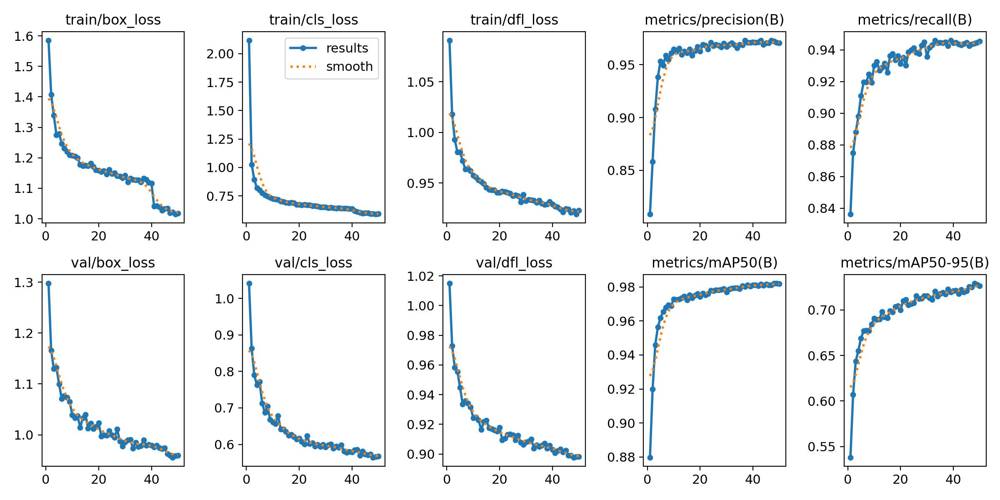

 Model: /content/runs/detect/yolo_freeze21/weights/best.pt
 Mean Squared Error (MSE): 14.6300
 Exact Match Accuracy (EMA): 20.00%
  Değerlendirilen görüntü sayısı: 200


(20.0, np.float64(14.63), 200)

In [21]:
display(Image(filename="/content/runs/detect/yolo_freeze21/results.png"))

evaluate_model(
    model_path="/content/runs/detect/yolo_freeze21/weights/best.pt",
    img_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test"
)

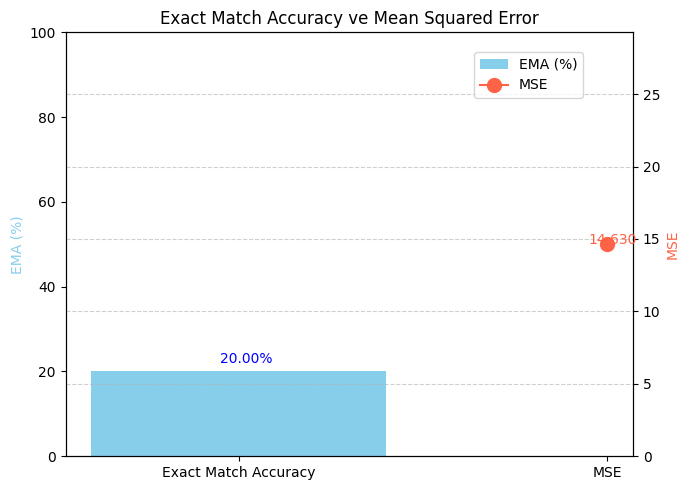

Prediction output directory: runs/detect/predict4

 Selected Images:
• 20160331_NTU_00008.jpg
• 20160331_NTU_00017.jpg
• 20160331_NTU_00019.jpg

 Prediction and Count Comparison:

Results saved to runs/detect/predict5


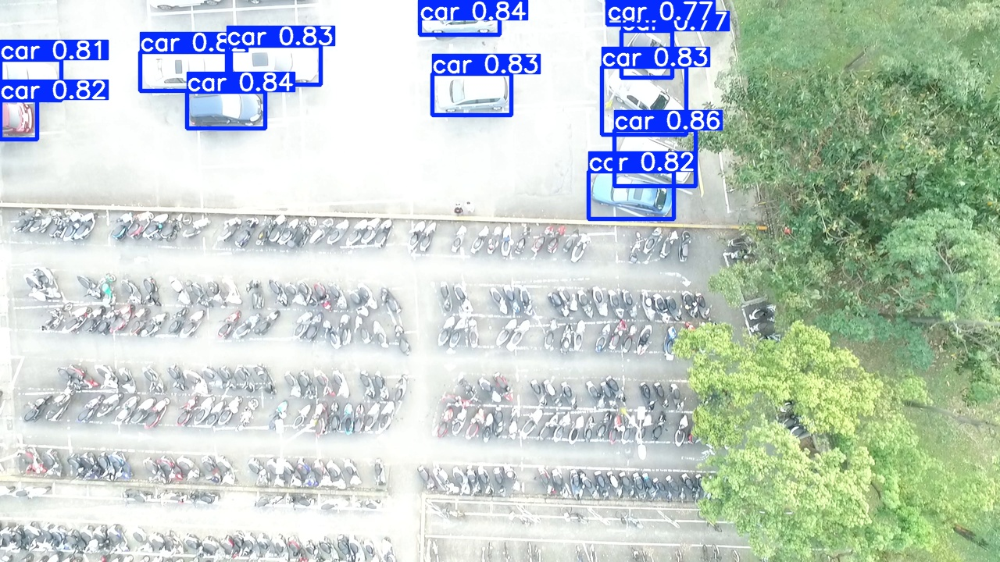

 20160331_NTU_00008.jpg → GT: 12 car(s), Prediction: 11 car(s)

Results saved to runs/detect/predict5


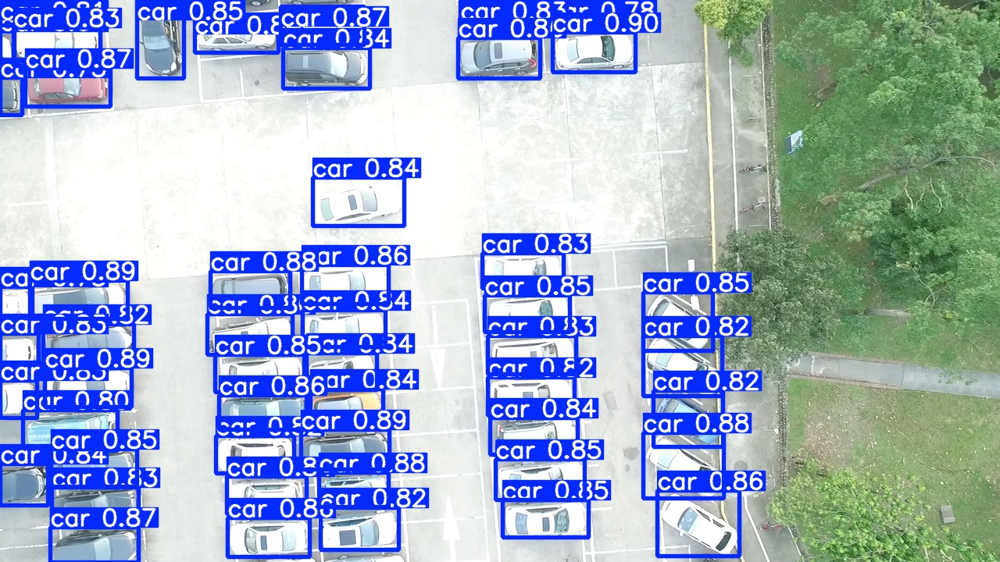

 20160331_NTU_00017.jpg → GT: 49 car(s), Prediction: 52 car(s)

Results saved to runs/detect/predict5


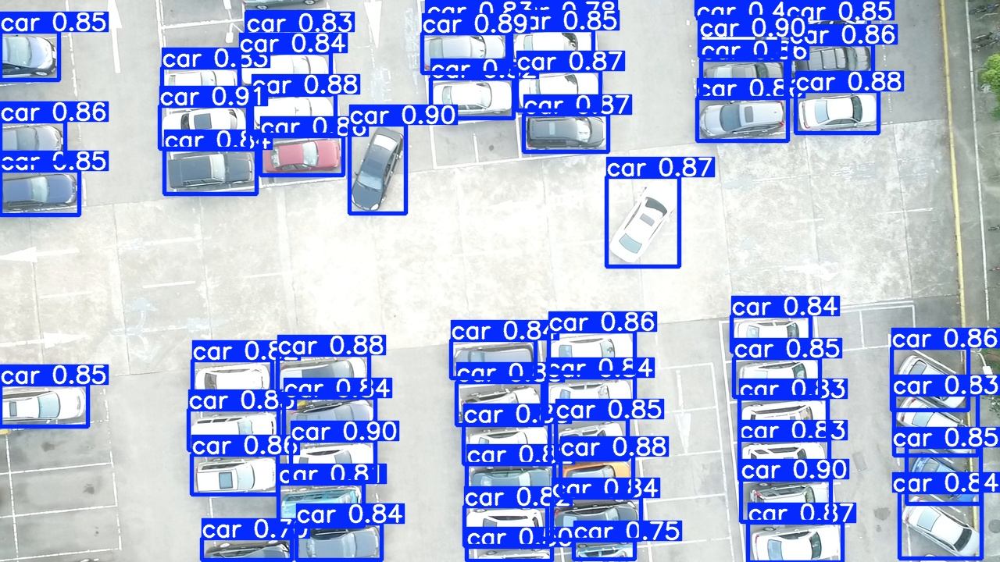

 20160331_NTU_00019.jpg → GT: 57 car(s), Prediction: 58 car(s)



In [23]:
plot_ema_mse( 20.00, 14.6300
)


predict_show_compare(
    model_path="/content/runs/detect/yolo_freeze21/weights/best.pt",
    image_dir="/content/drive/MyDrive/cars_dataset/images/test",
    label_dir="/content/drive/MyDrive/cars_dataset/labels/test",
    predict_dir="runs/detect/predict4",
    num_images=3
)

# Comparative Analysis

A comprehensive comparison of all trained YOLOv8n models reveals how different configurations—such as freezing strategies, learning rates, optimizers, batch sizes, and epoch durations—affect performance on the car counting task. The baseline model, yolo_car_counting_v8n, trained with all layers unfrozen and default hyperparameters, achieved an Exact Match Accuracy (EMA) of 46.50% and a Mean Squared Error (MSE) of 2.7350, serving as a strong starting point.

Freezing the first five layers in yolo_freeze5 yielded similar performance (EMA: 44.50%, MSE: 2.2700), suggesting that freezing low-level feature extractors does not severely impact model accuracy and may even slightly improve localization consistency. In yolo_freeze5_lr001, the optimizer was set to Adam with a lower learning rate (0.001), resulting in decreased performance (EMA: 42.50%, MSE: 3.4800), possibly due to slower convergence or underfitting. With a slightly higher learning rate in yolo_freeze5_lr005, performance remained similar (EMA: 42.00%, MSE: 3.2700), indicating that adjusting learning rate alone, without other changes, did not significantly benefit training.

Switching to the SGD optimizer in yolo_freeze5_lr005.v1 yielded a modest increase in EMA to 43.00%, but also the highest MSE among freeze=5 models (3.6300), suggesting slightly better count prediction but poorer bounding box localization. In yolo_freeze5_lr005.v2, the batch size was doubled to 32 while keeping the optimizer and learning rate the same. This reduced the MSE slightly (3.4200), but EMA dropped to 39.50%, likely due to over-smoothing of gradients with larger batch updates.

More aggressive freezing was applied in yolo_freeze10, which freezes the entire backbone and SPPF layer. Surprisingly, it achieved the highest EMA of all models (47.50%), although its MSE was higher at 3.4250, suggesting improved count predictions but less accurate bounding boxes. Extending training to 80 epochs in yolo_freeze580 significantly improved the model's localization performance (MSE: 2.5950) with only a slight decrease in EMA (45.00%), showing that longer training can partially compensate for reduced trainable layers.

Finally, yolo_freeze21, where only the detection head was left trainable, suffered the worst performance (EMA: 20.00%, MSE: 14.6300), clearly demonstrating that the backbone and neck must be at least partially unfrozen for the model to adapt effectively to a new dataset.

In summary, the results confirm that partial freezing (like in yolo_freeze5) provides a good trade-off between performance and training efficiency. However, excessive freezing—as in yolo_freeze21—severely limits the model's ability to generalize. Moreover, modifying learning rates and optimizers requires careful tuning, as arbitrary changes may reduce accuracy unless supported by longer training or more adaptive strategies.

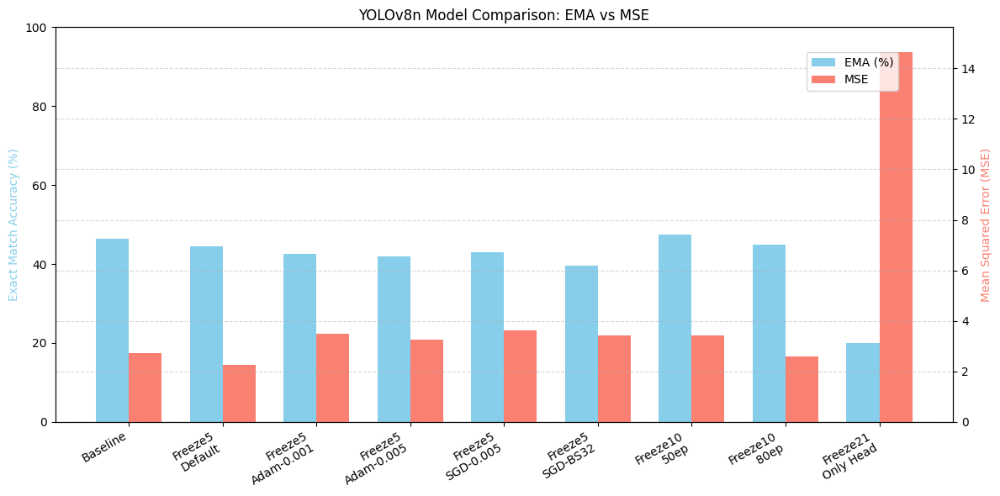

In [1]:
import matplotlib.pyplot as plt
import numpy as np

models = [
    "Baseline",
    "Freeze5\nDefault",
    "Freeze5\nAdam-0.001",
    "Freeze5\nAdam-0.005",
    "Freeze5\nSGD-0.005",
    "Freeze5\nSGD-BS32",
    "Freeze10\n50ep",
    "Freeze10\n80ep",
    "Freeze21\nOnly Head"
]

ema_scores = [46.5, 44.5, 42.5, 42.0, 43.0, 39.5, 47.5, 45.0, 20.0]
mse_scores = [2.735, 2.270, 3.480, 3.270, 3.630, 3.420, 3.425, 2.595, 14.630]

x = np.arange(len(models))
width = 0.35

fig, ax1 = plt.subplots(figsize=(12, 6))

bar1 = ax1.bar(x - width/2, ema_scores, width, label='EMA (%)', color='skyblue')
ax1.set_ylabel('Exact Match Accuracy (%)', color='skyblue')
ax1.set_ylim(0, 100)

ax2 = ax1.twinx()
bar2 = ax2.bar(x + width/2, mse_scores, width, label='MSE', color='salmon')
ax2.set_ylabel('Mean Squared Error (MSE)', color='salmon')
ax2.set_ylim(0, max(mse_scores) + 1)

plt.title("YOLOv8n Model Comparison: EMA vs MSE")
ax1.set_xticks(x)
ax1.set_xticklabels(models, rotation=30, ha="right")
fig.legend(loc="upper right", bbox_to_anchor=(0.9, 0.9))
plt.grid(axis='y', linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()
